In [ ]:
!pip install torch-geometric
!pip install tensorboard

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.4 MB/s eta 0:00:00


In [ ]:
import networkx as nx
import  torch_geometric
import torch
import json
from torch_geometric.datasets import Planetoid
from torch_geometric.nn import GCNConv
import torch.nn.functional as F
from torch_geometric.utils import to_networkx
from torch_geometric.transforms import NormalizeFeatures, AddSelfLoops
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from torch.utils.tensorboard import SummaryWriter
from sklearn.metrics import precision_score, recall_score, f1_score
import pandas as pd
from google.colab import files
from google.colab import drive
from sklearn.decomposition import PCA

# **Loading the Dataset with 'normalization'**
- **note: for preprocessing we use 'NormalizeFeatures' and we try to add self loops to the graph but it is raising an error !!**

In [ ]:
data = Planetoid(root='data/', name='Cora', transform=NormalizeFeatures())

Processing...
Done!


# **Data Information**

In [ ]:
data

Cora()

In [ ]:
num_classes = data.num_classes
num_classes

7

In [ ]:
len(data)

1

In [ ]:
num_features = data.num_features
num_features

1433

In [ ]:
data.num_edge_features

0

In [ ]:
data.data

/usr/local/lib/python3.10/dist-packages/torch_geometric/data/in_memory_dataset.py:300: UserWarning: It is not recommended to directly access the internal storage format `data` of an 'InMemoryDataset'. If you are absolutely certain what you are doing, access the internal storage via `InMemoryDataset._data` instead to suppress this warning. Alternatively, you can access stacked individual attributes of every graph via `dataset.{attr_name}`.
  warnings.warn(msg)


Data(x=[2708, 1433], edge_index=[2, 10556], y=[2708], train_mask=[2708], val_mask=[2708], test_mask=[2708])

In [ ]:
edge_index = data.edge_index
edge_index

tensor([[ 633, 1862, 2582,  ...,  598, 1473, 2706],
        [   0,    0,    0,  ..., 2707, 2707, 2707]])

In [ ]:
def visualize_E(h, color):
    h = h.detach().cpu().numpy() # Array of node embeddings
    plt.scatter(h[:, 0], h[:, 1], c=color)

# Convert to Networkx Graph

In [ ]:
F = to_networkx(data[0])

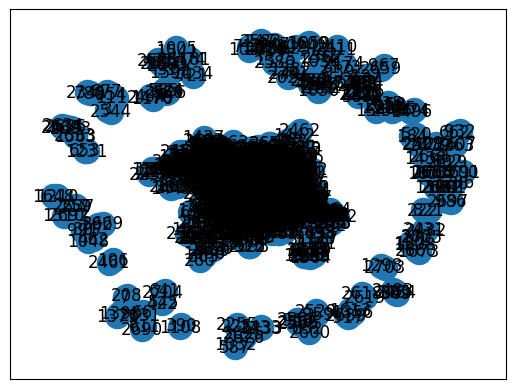

In [ ]:
nx.draw_networkx(F)

# Spring Layout for positioning the nodes of graph in 2D space
- **for example tell me where node 0 is in the x and y axis**

In [ ]:
nx.spring_layout(F)

{0: array([-0.0478184 ,  0.08194184]),
 1: array([ 0.09721972, -0.10051143]),
 2: array([ 0.0964832 , -0.03732346]),
 3: array([-0.32282105, -0.77363706]),
 4: array([-0.15288007,  0.10521321]),
 5: array([0.01647252, 0.24559338]),
 6: array([-0.06796969, -0.04140427]),
 7: array([-0.50833559, -0.82373148]),
 8: array([-0.15164161,  0.1044604 ]),
 9: array([-0.04878549, -0.1408902 ]),
 10: array([0.14189847, 0.01960864]),
 11: array([-0.0460939 , -0.05480973]),
 12: array([-0.39598808, -0.73606431]),
 13: array([0.04269219, 0.05104546]),
 14: array([ 0.0243033, -0.0471934]),
 15: array([0.20677732, 0.25192282]),
 16: array([0.02704784, 0.1895086 ]),
 17: array([0.08985798, 0.17435449]),
 18: array([ 0.03594643, -0.15441549]),
 19: array([-0.1041218 ,  0.29581803]),
 20: array([-0.10849886, -0.0867051 ]),
 21: array([-0.11891264, -0.0071391 ]),
 22: array([-0.1141126 , -0.06480863]),
 23: array([0.49463582, 0.16074654]),
 24: array([0.07401122, 0.10988345]),
 25: array([0.07247255, 0.10

# Visualize the Graph

In [ ]:
def visualize_G(G, color):
    return nx.draw_networkx(G, nx.spring_layout(G), node_color=color)

# Visualize the Embeddings

In [ ]:
def visualize_E(h, color):
    h = h.detach().cpu().numpy() # Array of node embeddings
    plt.scatter(h[:, 0], h[:, 1], c=color)
    plt.show()

In [ ]:
G = to_networkx(data[0]) # get first graph object and convert it to 'networkx graph'

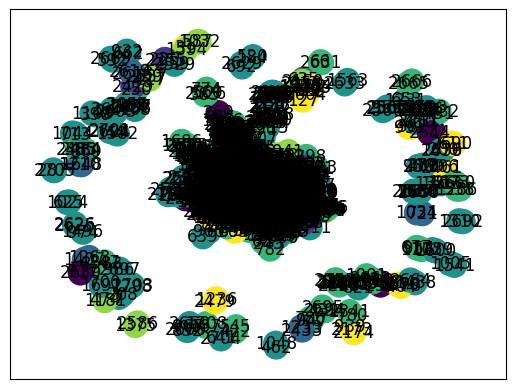

In [ ]:
visualize_G(G, data[0].y) # data[0].y 'predections' (class label of each node)

In [ ]:
CoraDataset = data[0] # get first graph object



---



# 1. **GCN Architecture | Mohamed Khairi and Mostapha Abdelaziz**

In [ ]:
class GCN(torch.nn.Module):
    def __init__(self, hidden_dimension, num_layers=2, activation_func="ReLU"):
        super(GCN, self).__init__()

        self.num_layers = num_layers
        self.activation_func = activation_func

        self.conv1 = GCNConv(num_features, hidden_dimension)
        self.convs = torch.nn.ModuleList([GCNConv(hidden_dimension, hidden_dimension) for _ in range(num_layers - 1)])
        self.conv_last = GCNConv(hidden_dimension, num_classes)

    def forward(self, x, edge_index):

        x = self.conv1(x, edge_index)
        x = self.applyActivation(x)

        for conv in self.convs:
            x = conv(x, edge_index)
            x = self.applyActivation(x)

        x = self.conv_last(x, edge_index)
        return x

    def applyActivation(self, x):
        if self.activation_func == "ReLU":
            return torch.relu(x)
        elif self.activation_func == "Sigmoid":
            return torch.sigmoid(x)
        elif self.activation_func == "Tanh":
            return torch.tanh(x)
        else:
            raise ValueError("Unsupported activation function !!")

# Train and test

In [ ]:
def train(data, mask, model, optimizer, criterion):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = criterion(out[mask], data.y[mask])
    loss.backward()
    optimizer.step()
    return loss

def test(data, mask, model):
    model.eval()
    out = model(data.x, data.edge_index)
    predictedC = out.argmax(dim=1)
    correct = predictedC[mask] == data.y[mask]
    acc = int(correct.sum()) / int(mask.sum())
    return acc

# Models building

In [ ]:
# 'First' Base model - Mohamed Khairi and Mostapha Abdelaziz

model1 = GCN(hidden_dimension=8, num_layers=2, activation_func="ReLU")
optimizer1 = torch.optim.Adam(model1.parameters(), lr=0.01)
criterion1 = torch.nn.CrossEntropyLoss()

# 'Second' model after tuning - Mohamed Khairi
model2 = GCN(hidden_dimension=16, num_layers=3, activation_func="Tanh")
optimizer2 = torch.optim.Adam(model2.parameters(), lr=0.005, weight_decay=0)
criterion2 = torch.nn.CrossEntropyLoss()

# 'Third' model after tuning - Mostapha Abdelaziz
model3 = GCN(hidden_dimension=32, num_layers=2, activation_func="Sigmoid")
optimizer3 = torch.optim.Adam(model3.parameters(), lr=0.01, weight_decay=5e-4)
criterion3 = torch.nn.CrossEntropyLoss()

# Base Model (model1) embeddings | GCN

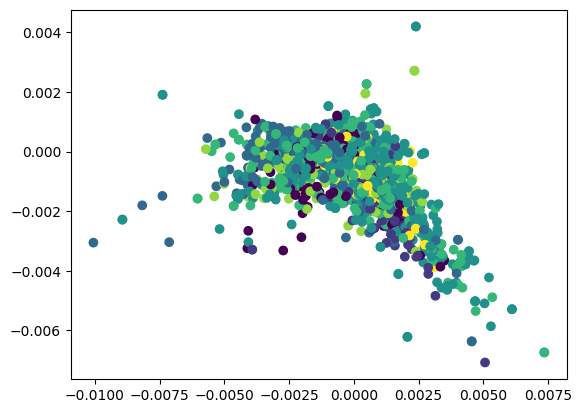

In [ ]:
embeddings = model1(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Model 2 embeddings | Mohamed Khairi

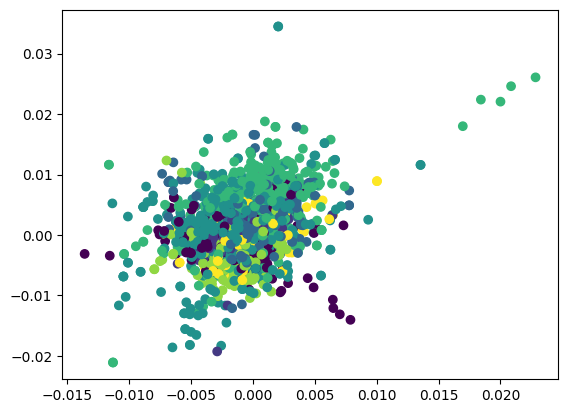

In [ ]:
embeddings = model2(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Model 3 embeddings | Mostapha Abdelaziz

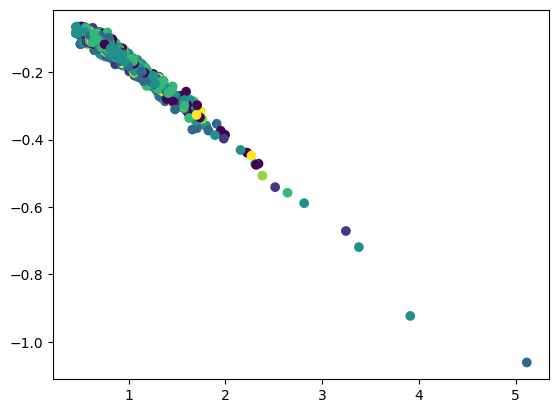

In [ ]:
embeddings = model3(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Train and test 'Base model'

Model 1 - Epoch: 010, Loss: 1.5593, Train: 0.7786, Val: 0.5420, Test: 0.5530, Precision: 0.6363, Recall: 0.5530, F1: 0.5526
Node Embeddings (Epoch 10):
[[ 0.00420594 -0.08544981]
 [ 0.04063702  1.2719891 ]
 [-0.31782278  0.98065555]
 ...
 [ 0.6109477  -0.27590585]
 [-0.46705315  0.3190721 ]
 [-0.4835067   0.254859  ]]


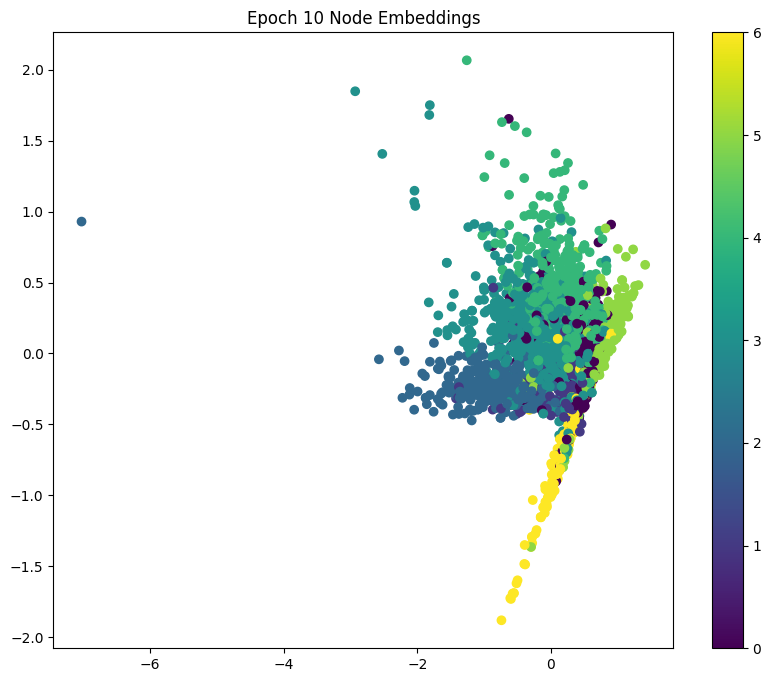

Model 1 - Epoch: 020, Loss: 0.7461, Train: 0.9429, Val: 0.6640, Test: 0.6660, Precision: 0.7382, Recall: 0.6660, F1: 0.6617
Node Embeddings (Epoch 20):
[[-1.1722459  -1.401948  ]
 [-0.8937595  -1.8576466 ]
 [-1.9432067  -1.9172735 ]
 ...
 [ 2.1040854  -0.33506012]
 [-2.1818533  -1.5401081 ]
 [-2.0536747  -1.3831812 ]]


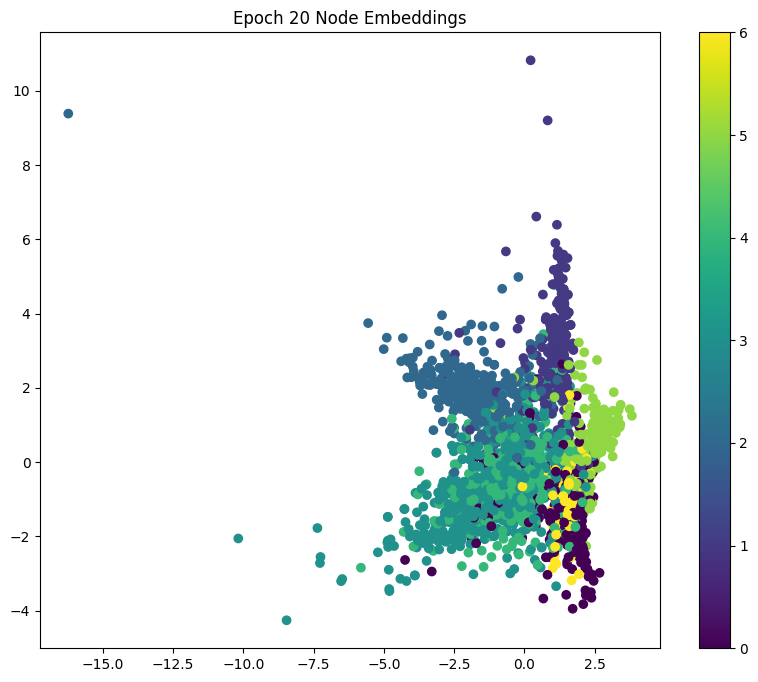

Model 1 - Epoch: 030, Loss: 0.2212, Train: 0.9786, Val: 0.7260, Test: 0.7380, Precision: 0.7621, Recall: 0.7380, F1: 0.7376
Node Embeddings (Epoch 30):
[[ 4.7534027 -0.0826906]
 [ 5.177526   2.5227287]
 [ 6.797718   0.8523856]
 ...
 [-2.342683   3.6996155]
 [ 5.840532  -0.9990132]
 [ 5.255029  -1.0445921]]


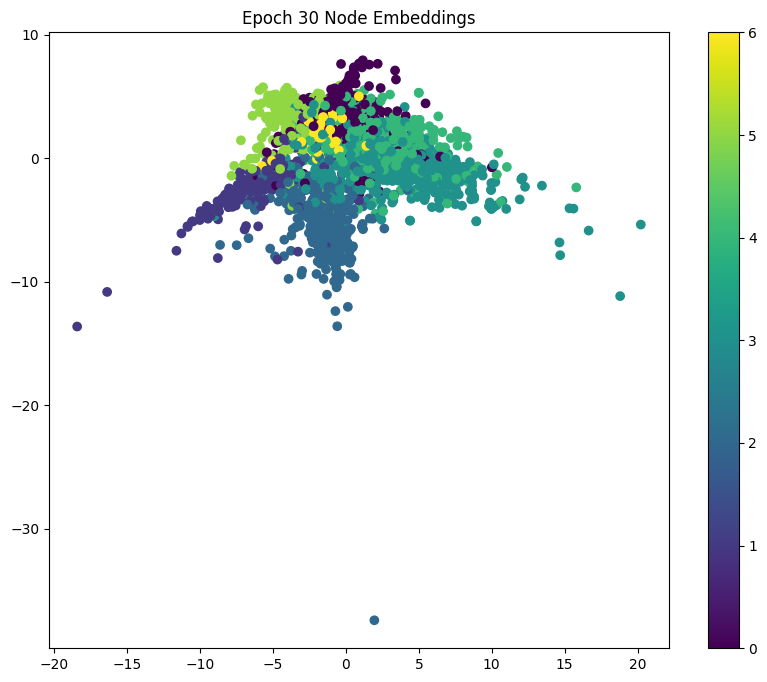

Model 1 - Epoch: 040, Loss: 0.0518, Train: 1.0000, Val: 0.7380, Test: 0.7490, Precision: 0.7693, Recall: 0.7490, F1: 0.7490
Node Embeddings (Epoch 40):
[[ 7.8431044 -1.3934195]
 [ 6.5683794  5.382745 ]
 [ 8.766297   1.911412 ]
 ...
 [-2.63559    5.2345276]
 [ 8.080334  -1.8836501]
 [ 7.356271  -1.9926698]]


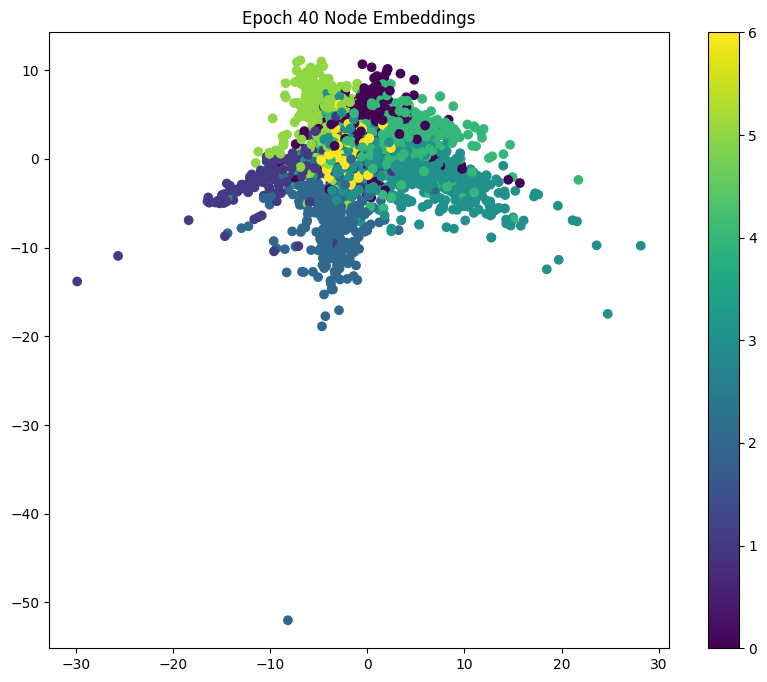

Model 1 - Epoch: 050, Loss: 0.0140, Train: 1.0000, Val: 0.7340, Test: 0.7450, Precision: 0.7671, Recall: 0.7450, F1: 0.7448
Node Embeddings (Epoch 50):
[[10.168011  -2.0859451]
 [ 5.778146   8.705505 ]
 [ 8.599346   4.0372925]
 ...
 [-2.9970622  5.856283 ]
 [ 9.371916  -1.4417658]
 [ 8.737633  -1.7350502]]


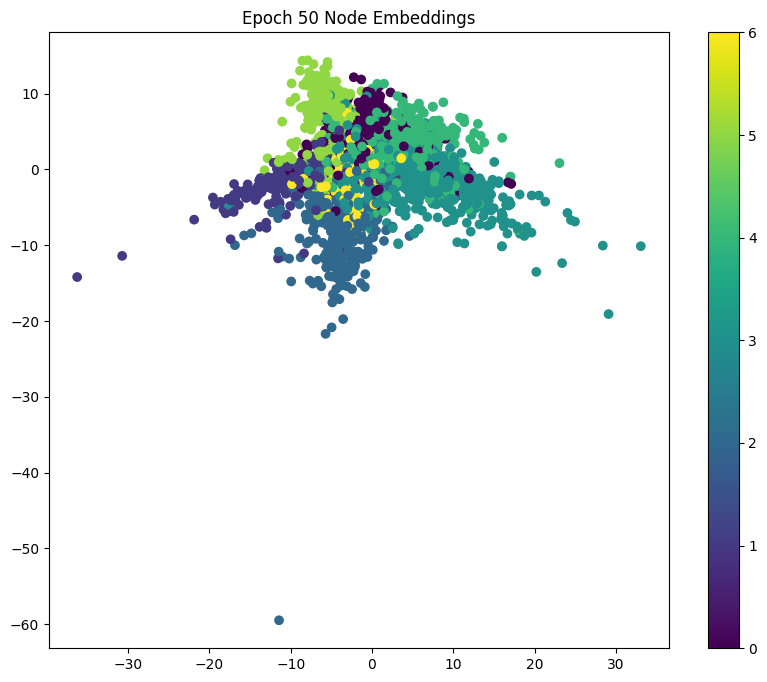

Model 1 - Epoch: 060, Loss: 0.0060, Train: 1.0000, Val: 0.7440, Test: 0.7490, Precision: 0.7674, Recall: 0.7490, F1: 0.7492
Node Embeddings (Epoch 60):
[[11.617895   -2.1186466 ]
 [ 4.613096   10.790369  ]
 [ 8.0752125   5.562751  ]
 ...
 [-3.4758763   6.01182   ]
 [10.389398   -0.72664285]
 [ 9.859737   -1.162092  ]]


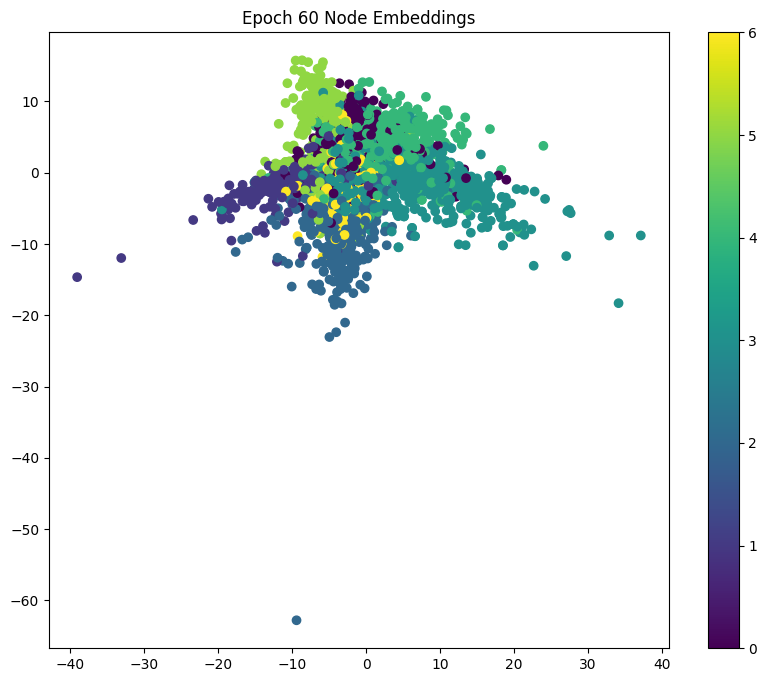

Model 1 - Epoch: 070, Loss: 0.0036, Train: 1.0000, Val: 0.7460, Test: 0.7520, Precision: 0.7705, Recall: 0.7520, F1: 0.7518
Node Embeddings (Epoch 70):
[[12.468795   -2.1010556 ]
 [ 3.6332192  11.747711  ]
 [ 7.4995213   6.250783  ]
 ...
 [-3.5793767   6.032942  ]
 [10.979961   -0.31361556]
 [10.566132   -0.8223357 ]]


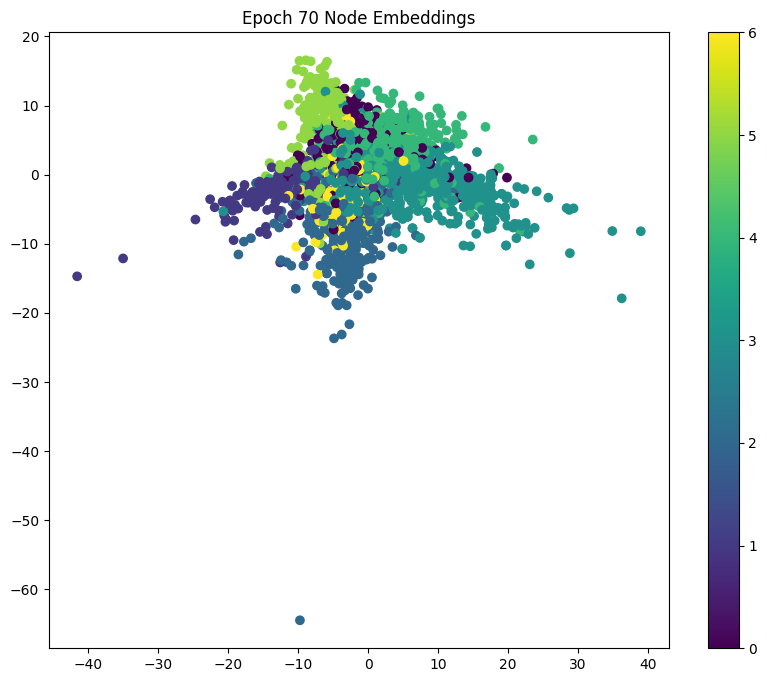

Model 1 - Epoch: 080, Loss: 0.0026, Train: 1.0000, Val: 0.7420, Test: 0.7460, Precision: 0.7651, Recall: 0.7460, F1: 0.7456
Node Embeddings (Epoch 80):
[[12.93676    -1.969451  ]
 [ 2.9869409  12.052404  ]
 [ 7.121249    6.4713    ]
 ...
 [-3.6374605   6.120366  ]
 [11.363754   -0.10181785]
 [11.02474    -0.63403296]]


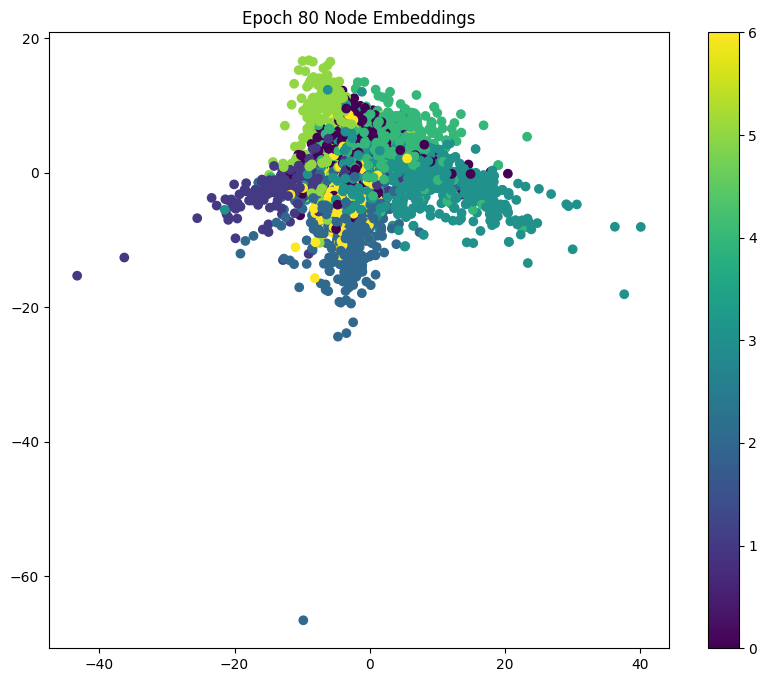

Model 1 - Epoch: 090, Loss: 0.0020, Train: 1.0000, Val: 0.7380, Test: 0.7450, Precision: 0.7647, Recall: 0.7450, F1: 0.7447
Node Embeddings (Epoch 90):
[[ 1.3226543e+01 -1.8236670e+00]
 [ 2.5695128e+00  1.2174694e+01]
 [ 6.8904161e+00  6.5637045e+00]
 ...
 [-3.6984787e+00  6.2172160e+00]
 [ 1.1644187e+01 -1.0581017e-03]
 [ 1.1350795e+01 -5.3989744e-01]]


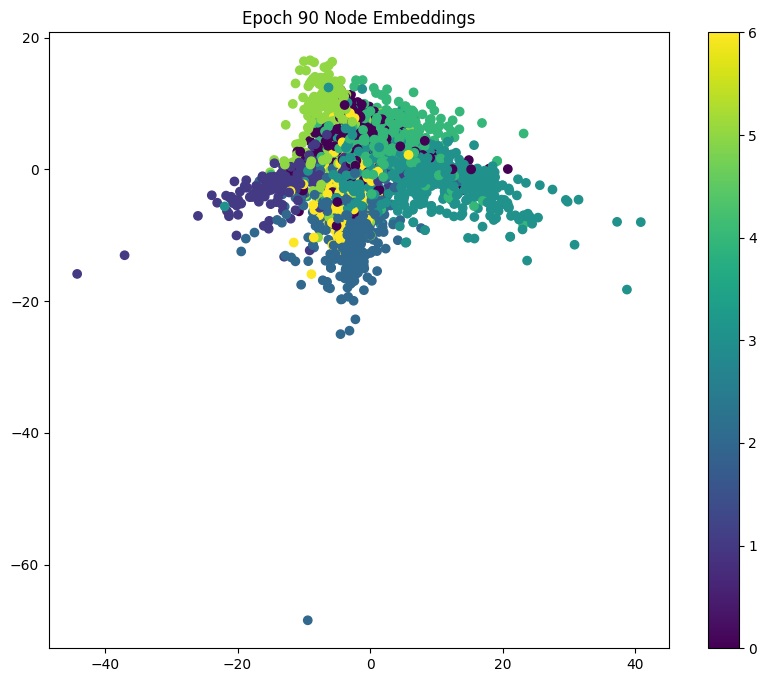

Model 1 - Epoch: 100, Loss: 0.0017, Train: 1.0000, Val: 0.7340, Test: 0.7480, Precision: 0.7668, Recall: 0.7480, F1: 0.7477
Node Embeddings (Epoch 100):
[[13.455242   -1.6987495 ]
 [ 2.2155128  12.275246  ]
 [ 6.6840034   6.6484118 ]
 ...
 [-3.7403364   6.2943497 ]
 [11.876158    0.05966735]
 [11.6253605  -0.48650908]]


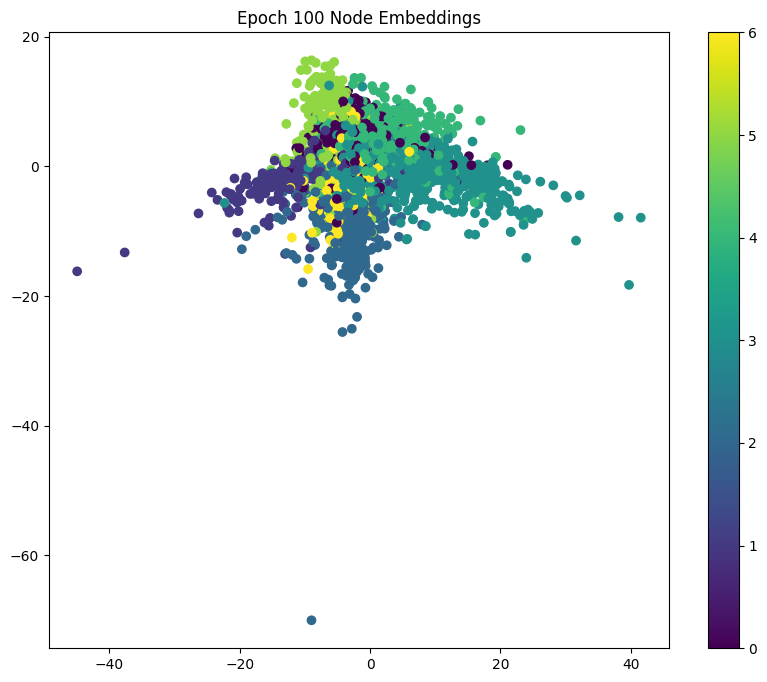

Model 1 - Epoch: 110, Loss: 0.0015, Train: 1.0000, Val: 0.7360, Test: 0.7490, Precision: 0.7687, Recall: 0.7490, F1: 0.7488
Node Embeddings (Epoch 110):
[[13.6469555  -1.5875959 ]
 [ 1.8919657  12.3561    ]
 [ 6.4938955   6.715803  ]
 ...
 [-3.7636275   6.364893  ]
 [12.065518    0.09965587]
 [11.853586   -0.45210052]]


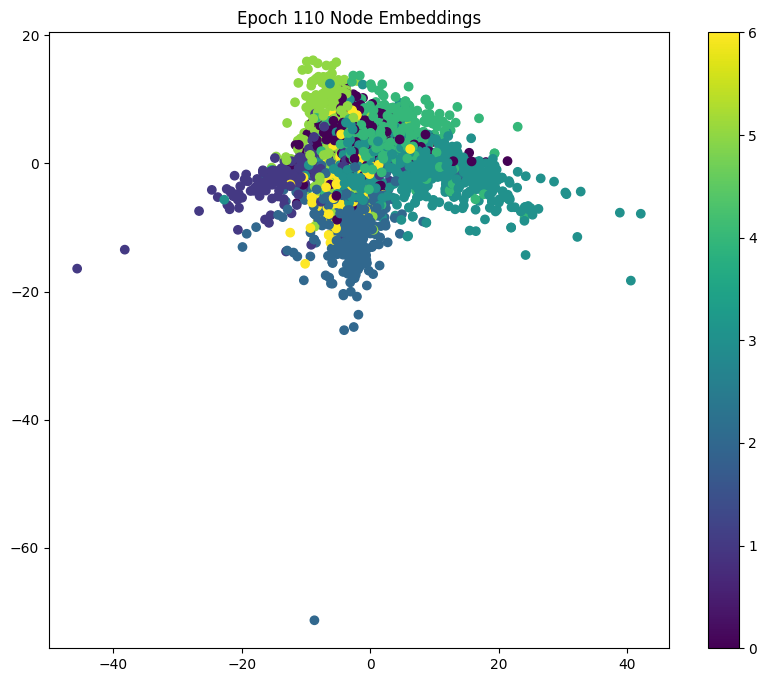

Model 1 - Epoch: 120, Loss: 0.0013, Train: 1.0000, Val: 0.7340, Test: 0.7490, Precision: 0.7680, Recall: 0.7490, F1: 0.7486
Node Embeddings (Epoch 120):
[[13.812651   -1.495563  ]
 [ 1.6262201  12.404644  ]
 [ 6.3392744   6.7544546 ]
 ...
 [-3.7769117   6.440382  ]
 [12.247786    0.12455249]
 [12.066422   -0.43001437]]


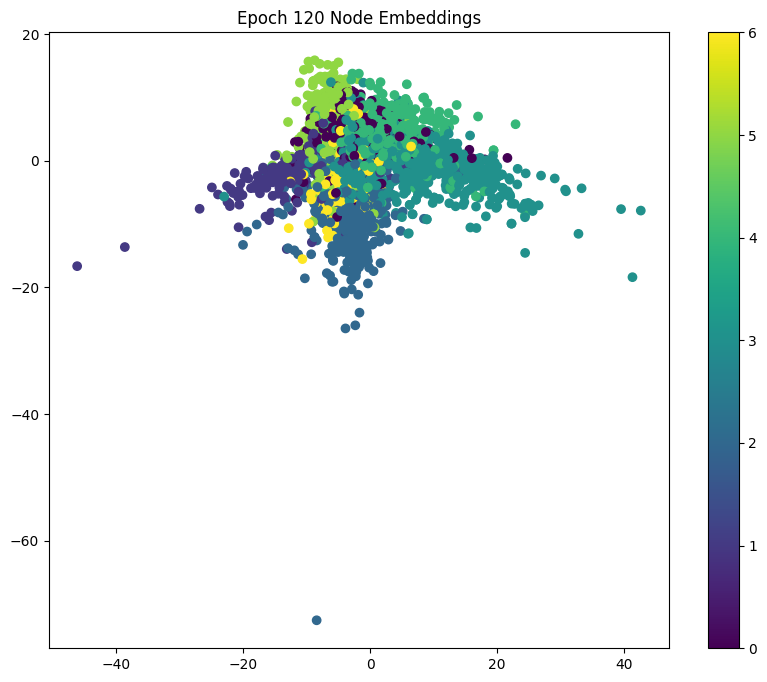

Model 1 - Epoch: 130, Loss: 0.0011, Train: 1.0000, Val: 0.7340, Test: 0.7500, Precision: 0.7687, Recall: 0.7500, F1: 0.7497
Node Embeddings (Epoch 130):
[[13.965952   -1.4169865 ]
 [ 1.3697424  12.455427  ]
 [ 6.183666    6.79191   ]
 ...
 [-3.7831888   6.513899  ]
 [12.41563     0.14191532]
 [12.265174   -0.41602278]]


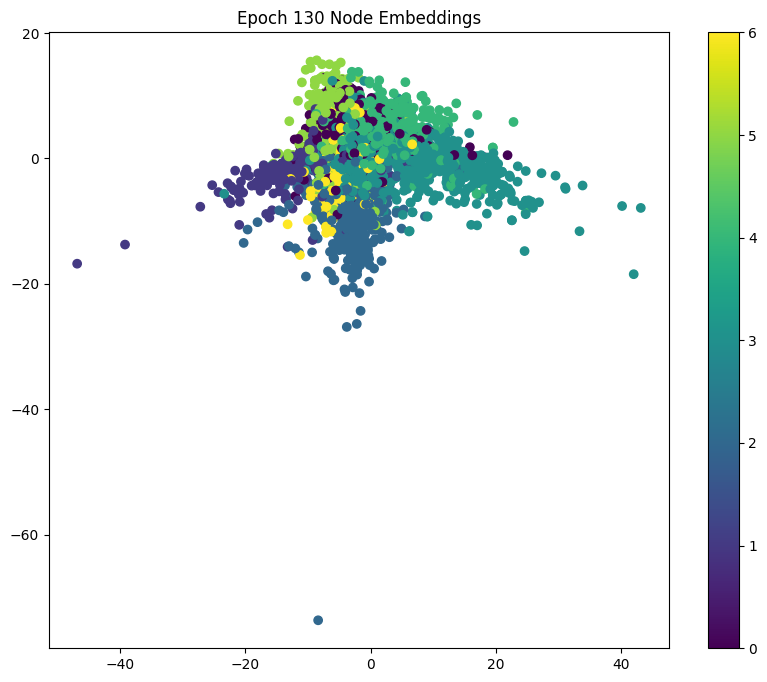

Model 1 - Epoch: 140, Loss: 0.0010, Train: 1.0000, Val: 0.7340, Test: 0.7500, Precision: 0.7687, Recall: 0.7500, F1: 0.7497
Node Embeddings (Epoch 140):
[[14.106575   -1.3464444 ]
 [ 1.1339538  12.506666  ]
 [ 6.039222    6.8295584 ]
 ...
 [-3.7871122   6.58636   ]
 [12.579405    0.15068364]
 [12.456707   -0.41114163]]


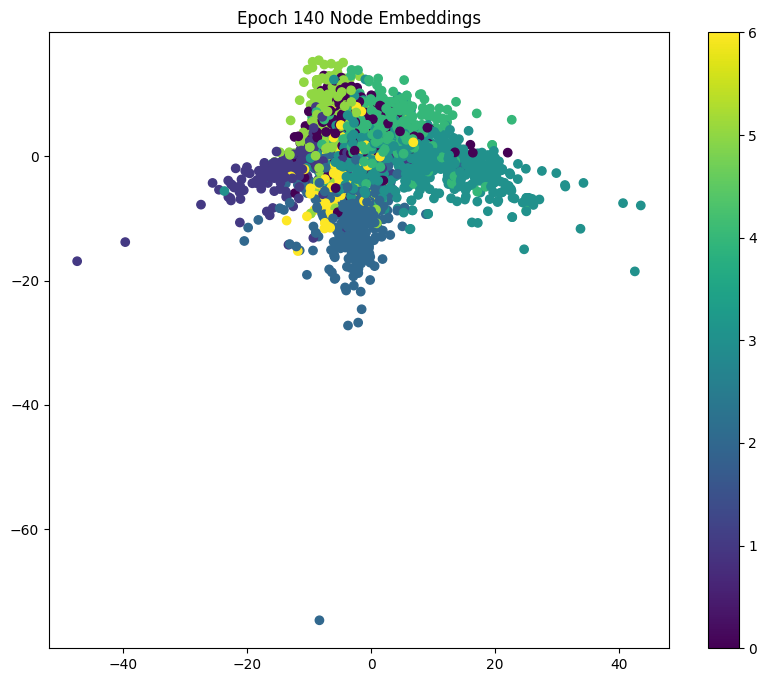

Model 1 - Epoch: 150, Loss: 0.0009, Train: 1.0000, Val: 0.7300, Test: 0.7500, Precision: 0.7687, Recall: 0.7500, F1: 0.7497
Node Embeddings (Epoch 150):
[[14.237754   -1.2616091 ]
 [ 0.8998668  12.557936  ]
 [ 5.8959465   6.871859  ]
 ...
 [-3.7918348   6.6547246 ]
 [12.736058    0.14920902]
 [12.639612   -0.41662383]]


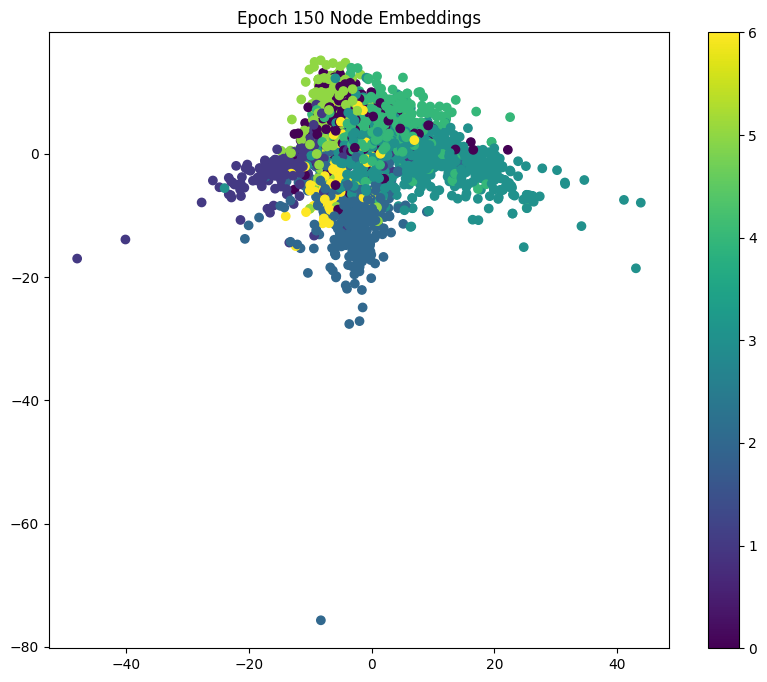

Model 1 - Epoch: 160, Loss: 0.0008, Train: 1.0000, Val: 0.7300, Test: 0.7500, Precision: 0.7687, Recall: 0.7500, F1: 0.7497
Node Embeddings (Epoch 160):
[[14.35899    -1.1681972 ]
 [ 0.67697656 12.608322  ]
 [ 5.7592483   6.9166737 ]
 ...
 [-3.7969313   6.7206793 ]
 [12.8855295   0.13687181]
 [12.813314   -0.43304133]]


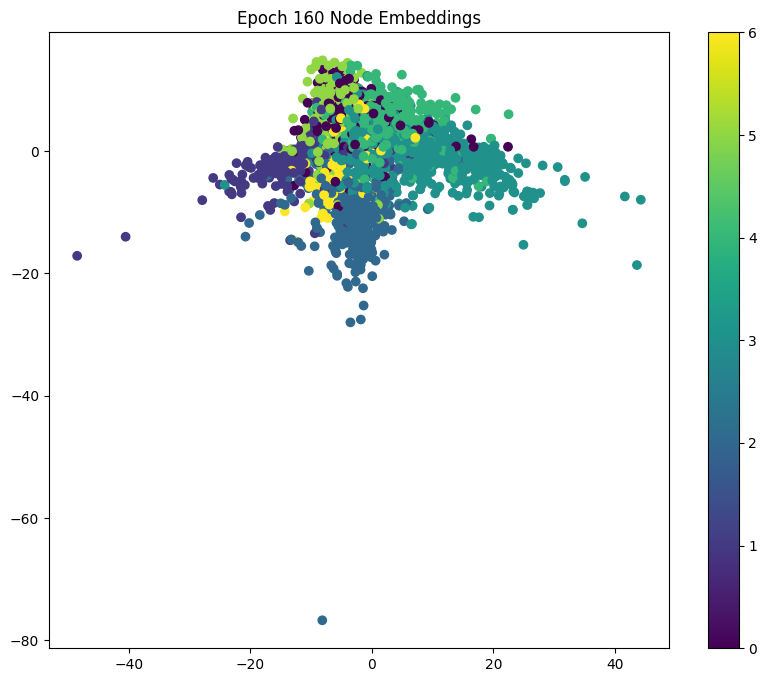

Model 1 - Epoch: 170, Loss: 0.0007, Train: 1.0000, Val: 0.7300, Test: 0.7500, Precision: 0.7687, Recall: 0.7500, F1: 0.7497
Node Embeddings (Epoch 170):
[[14.474686   -1.0577648 ]
 [ 0.46128178 12.658093  ]
 [ 5.626176    6.9669623 ]
 ...
 [-3.8030305   6.7832594 ]
 [13.02657     0.10778165]
 [12.977282   -0.46584868]]


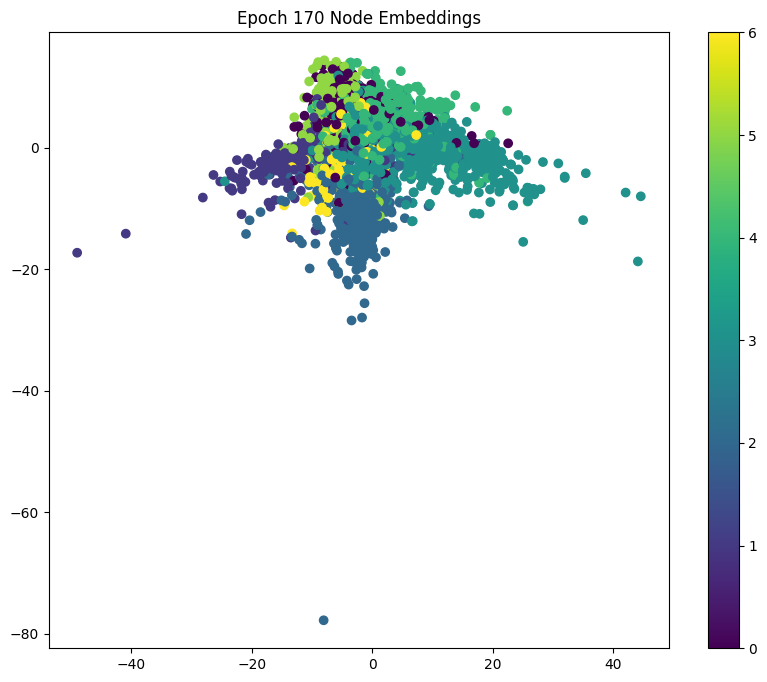

Model 1 - Epoch: 180, Loss: 0.0007, Train: 1.0000, Val: 0.7300, Test: 0.7500, Precision: 0.7687, Recall: 0.7500, F1: 0.7497
Node Embeddings (Epoch 180):
[[14.585635   -0.9242072 ]
 [ 0.25382817 12.705805  ]
 [ 5.497131    7.024413  ]
 ...
 [-3.8104262   6.8408165 ]
 [13.159189    0.05751014]
 [13.131354   -0.5191963 ]]


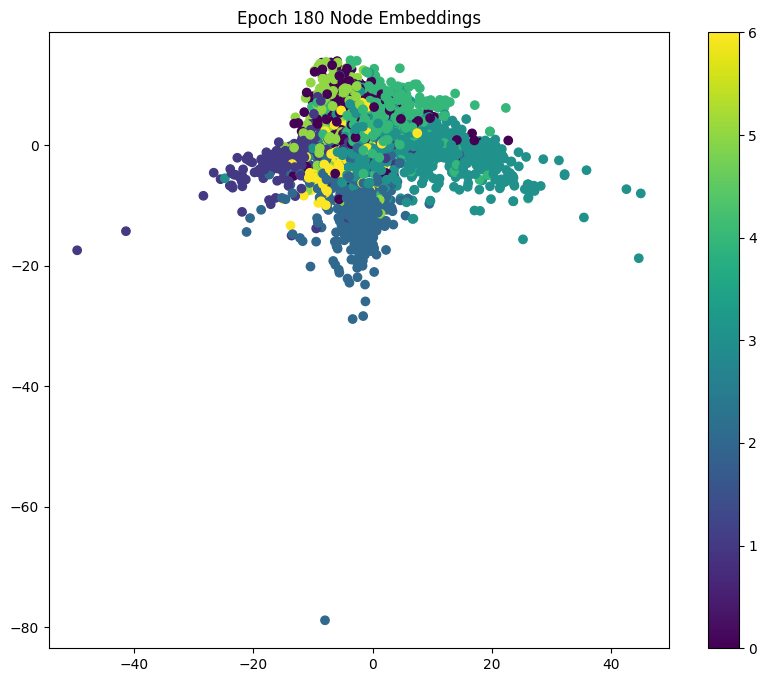

Model 1 - Epoch: 190, Loss: 0.0006, Train: 1.0000, Val: 0.7300, Test: 0.7500, Precision: 0.7690, Recall: 0.7500, F1: 0.7498
Node Embeddings (Epoch 190):
[[14.690637   -0.76754737]
 [ 0.05447769 12.7494335 ]
 [ 5.3718576   7.0894604 ]
 ...
 [-3.8169441   6.8903418 ]
 [13.28424    -0.01482749]
 [13.276608   -0.5942013 ]]


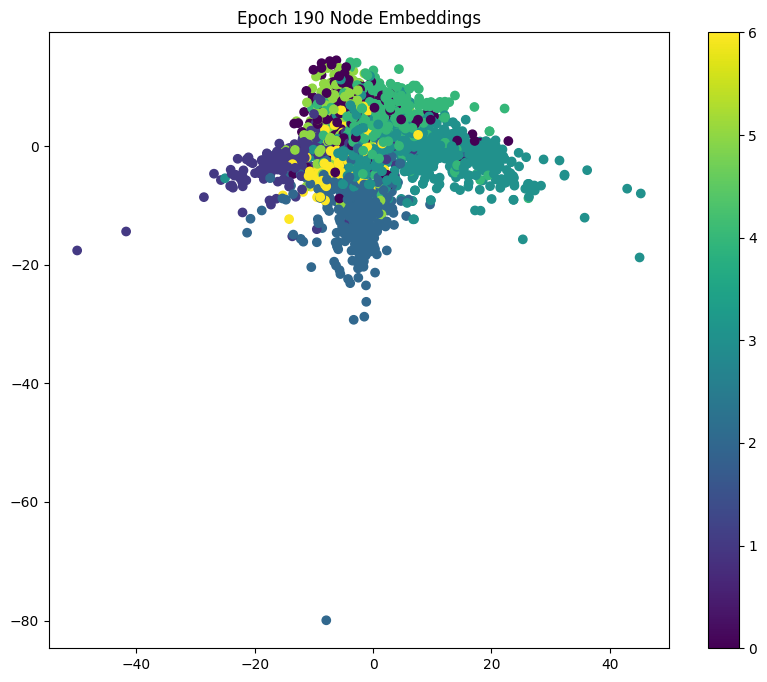

Model 1 - Epoch: 200, Loss: 0.0006, Train: 1.0000, Val: 0.7280, Test: 0.7500, Precision: 0.7690, Recall: 0.7500, F1: 0.7497
Node Embeddings (Epoch 200):
[[14.790324   -0.5796418 ]
 [-0.13987029 12.785057  ]
 [ 5.2487044   7.1613693 ]
 ...
 [-3.8226976   6.927145  ]
 [13.402898   -0.11279702]
 [13.414662   -0.6940751 ]]


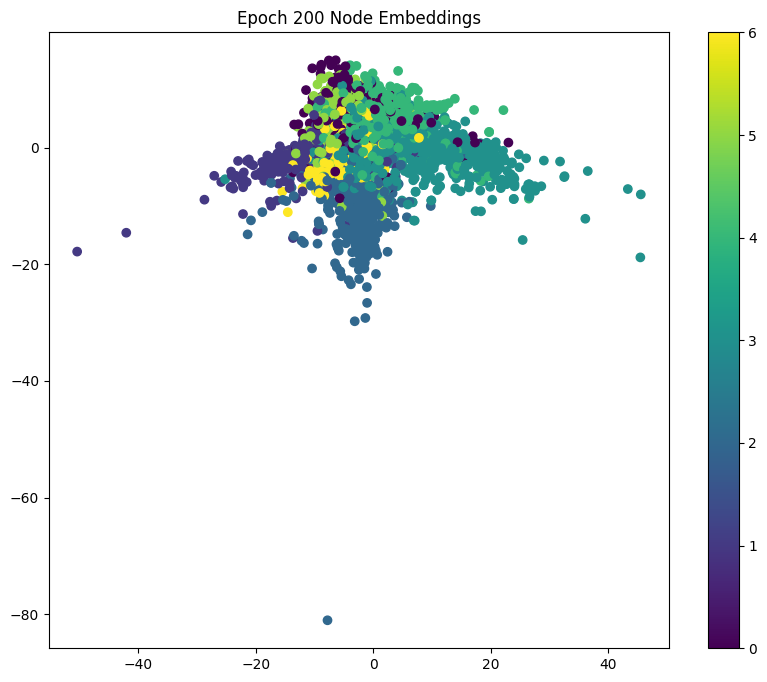

In [ ]:
writer1 = SummaryWriter('runs/model1')

epochs1 = []
train_losses1 = []
train_accuracies1 = []
val_accuracies1 = []
test_accuracies1 = []
precisions1 = []
recalls1 = []
f1_scores1 = []

num_epochs = 200
for epoch in range(1, num_epochs + 1):
    loss1 = train(data, data.train_mask, model1, optimizer1, criterion1)
    train_acc1 = test(data, data.train_mask, model1)
    val_acc1 = test(data, data.val_mask, model1)
    test_acc1 = test(data, data.test_mask, model1)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()  # True labels
    y_pred_test = model1(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()  # Predicted labels

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs1.append(epoch)
        train_losses1.append(loss1.detach().item() if isinstance(loss1, torch.Tensor) else loss1)
        train_accuracies1.append(train_acc1.detach().item() if isinstance(train_acc1, torch.Tensor) else train_acc1)
        val_accuracies1.append(val_acc1.detach().item() if isinstance(val_acc1, torch.Tensor) else val_acc1)
        test_accuracies1.append(test_acc1.detach().item() if isinstance(test_acc1, torch.Tensor) else test_acc1)
        precisions1.append(precision)
        recalls1.append(recall)
        f1_scores1.append(f1)

        print(f'Model 1 - Epoch: {epoch:03d}, Loss: {loss1:.4f}, Train: {train_acc1:.4f}, Val: {val_acc1:.4f}, Test: {test_acc1:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        node_embeddings = model1(data.x, data.edge_index)

        # Reducing dimensions using PCA for visualization
        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        # Printing the node embeddings for the current epoch
        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # visualizing the node embeddings
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer1.add_scalar('Loss/Train', loss1, epoch)
    writer1.add_scalar('Accuracy/Train', train_acc1, epoch)
    writer1.add_scalar('Accuracy/Validation', val_acc1, epoch)
    writer1.add_scalar('Accuracy/Test', test_acc1, epoch)
    writer1.add_scalar('Precision/Test', precision, epoch)
    writer1.add_scalar('Recall/Test', recall, epoch)
    writer1.add_scalar('F1-Score/Test', f1, epoch)

writer1.close()

# Metrices Documention model 1

In [ ]:
# Saving metrics to a DataFrame
metrics1 = pd.DataFrame({
    "Epoch": epochs1,
    "Train Loss": train_losses1,
    "Train Accuracy": train_accuracies1,
    "Validation Accuracy": val_accuracies1,
    "Test Accuracy": test_accuracies1,
})

metrics1.to_csv('model1_metrics.csv', index=False)

print("Metrics for Model 1 saved to 'model1_metrics.csv'")

files.download('model1_metrics.csv')

Metrics for Model 1 saved to 'model1_metrics.csv'


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Learning Curve for Base Model

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs1, y=train_losses1, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs1, y=train_accuracies1, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs1, y=val_accuracies1, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs1, y=test_accuracies1, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Default Model | Mohamed Khairi and Mostapha Abdelaziz',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# Train and test 'second' model after tuning - Mohamed Khairi

Model 2 - Epoch: 010, Loss: 1.1218, Train: 0.8643, Val: 0.6560, Test: 0.6590, Precision: 0.7349, Recall: 0.6590, F1: 0.6376
Node Embeddings (Epoch 10):
[[ 1.6057091   0.1591616 ]
 [-1.9548073   0.67518103]
 [-0.815504    0.6251531 ]
 ...
 [-1.4309411  -1.0277234 ]
 [ 1.2302854   0.14742236]
 [ 1.2206373   0.20300165]]


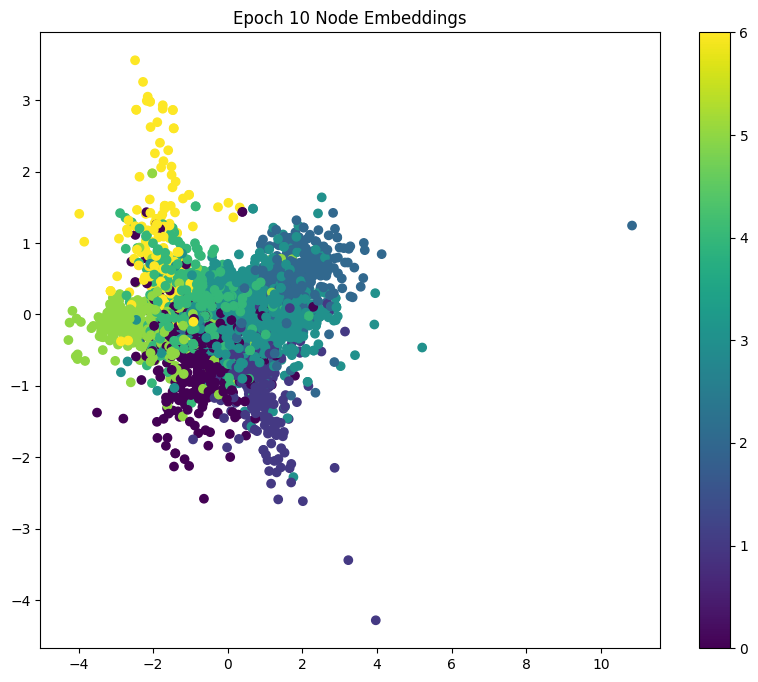

Model 2 - Epoch: 020, Loss: 0.5520, Train: 0.9714, Val: 0.7280, Test: 0.7810, Precision: 0.8006, Recall: 0.7810, F1: 0.7811
Node Embeddings (Epoch 20):
[[ 3.0559268   0.0521673 ]
 [-2.3914366   1.4942396 ]
 [-0.94942087  1.5245672 ]
 ...
 [-2.839084   -2.680216  ]
 [ 2.7457259   0.00574854]
 [ 2.4238856   0.05836244]]


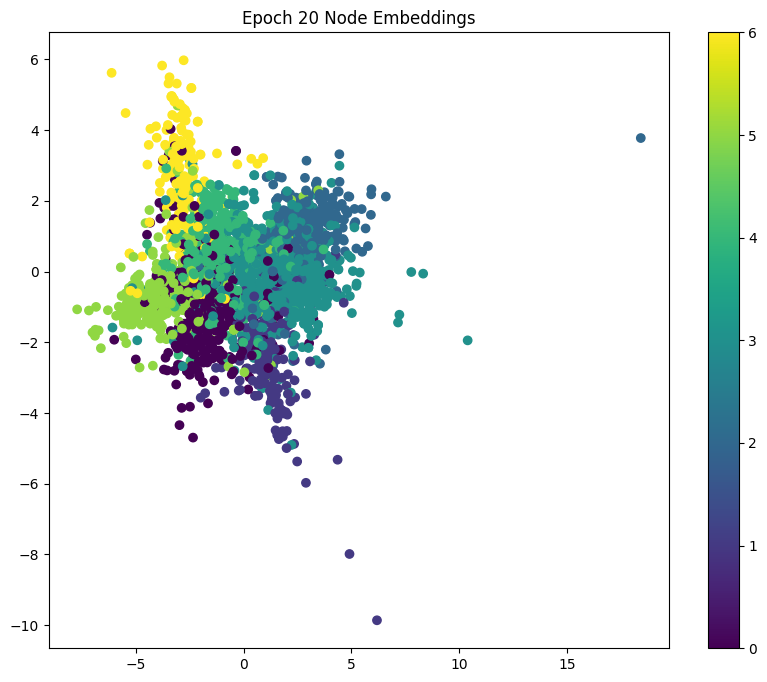

Model 2 - Epoch: 030, Loss: 0.2773, Train: 0.9929, Val: 0.7520, Test: 0.7870, Precision: 0.8021, Recall: 0.7870, F1: 0.7879
Node Embeddings (Epoch 30):
[[ 3.7828207   0.6945007 ]
 [-1.6301336  -1.8183149 ]
 [-0.24071103 -2.0163143 ]
 ...
 [-3.9924836   3.5636187 ]
 [ 3.8631372   0.7592757 ]
 [ 3.2547984   0.65227807]]


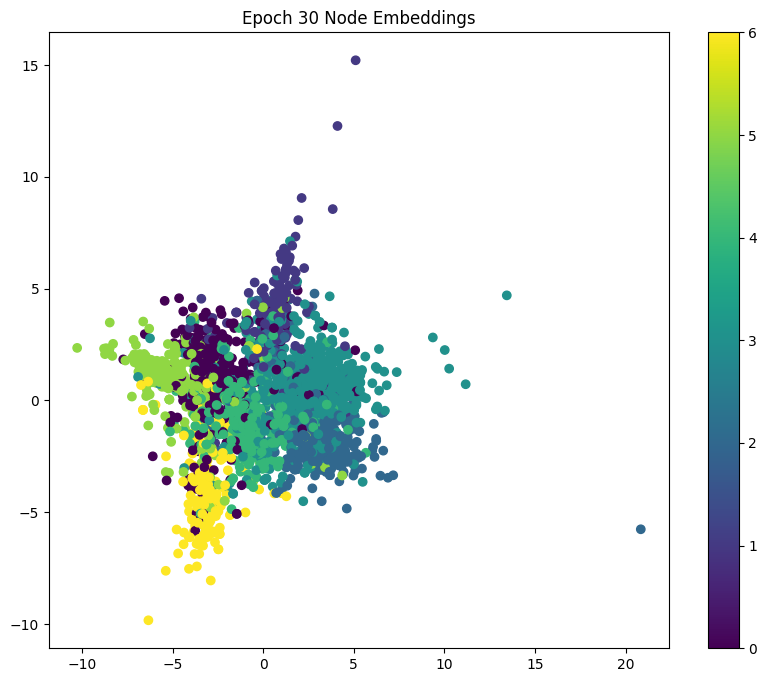

Model 2 - Epoch: 040, Loss: 0.1563, Train: 1.0000, Val: 0.7440, Test: 0.7780, Precision: 0.7952, Recall: 0.7780, F1: 0.7787
Node Embeddings (Epoch 40):
[[ 4.508496    0.9942131 ]
 [-1.3415666  -1.7554578 ]
 [ 0.19024771 -2.2271557 ]
 ...
 [-4.7334723   4.058634  ]
 [ 4.8076615   1.2879874 ]
 [ 3.9985273   1.162999  ]]


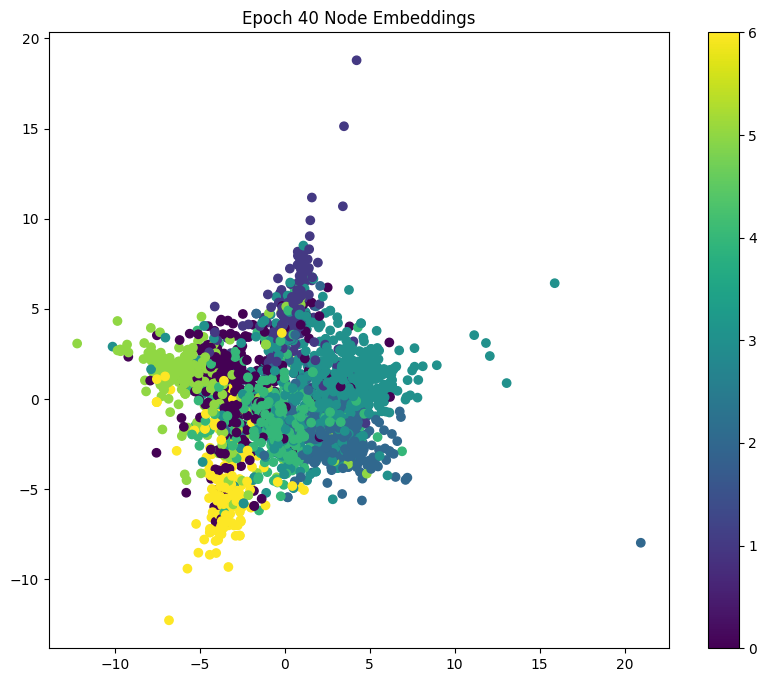

Model 2 - Epoch: 050, Loss: 0.0999, Train: 1.0000, Val: 0.7220, Test: 0.7620, Precision: 0.7835, Recall: 0.7620, F1: 0.7620
Node Embeddings (Epoch 50):
[[ 4.9272404   1.396715  ]
 [-1.9623944  -1.1460801 ]
 [-0.31548983 -1.8842573 ]
 ...
 [-5.381079    4.455676  ]
 [ 5.25619     1.9213831 ]
 [ 4.3355775   1.7364565 ]]


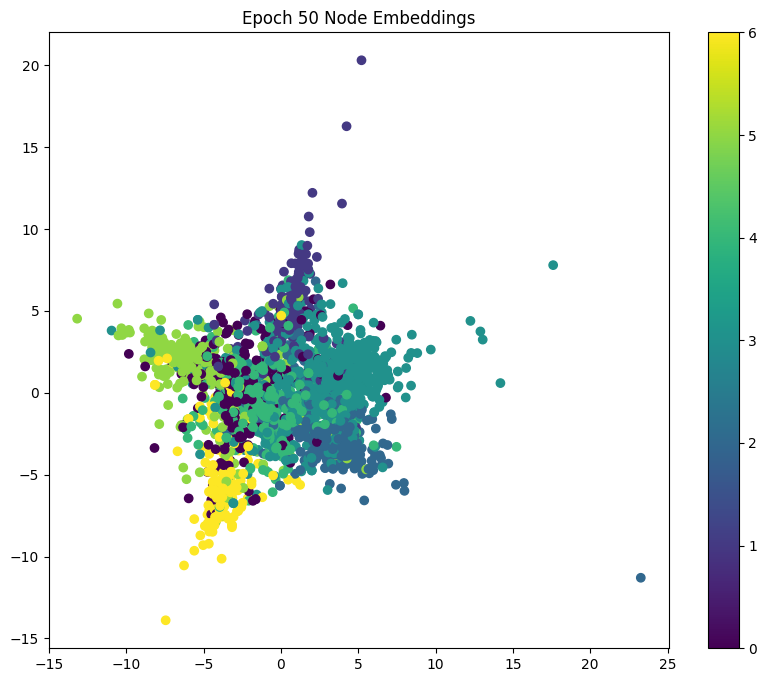

Model 2 - Epoch: 060, Loss: 0.0706, Train: 1.0000, Val: 0.7120, Test: 0.7530, Precision: 0.7774, Recall: 0.7530, F1: 0.7524
Node Embeddings (Epoch 60):
[[ 5.056797    2.3083549 ]
 [-2.894492   -0.05503632]
 [-1.184163   -0.86091644]
 ...
 [-6.023304    4.4158673 ]
 [ 5.3812017   3.0138612 ]
 [ 4.4000454   2.6684227 ]]


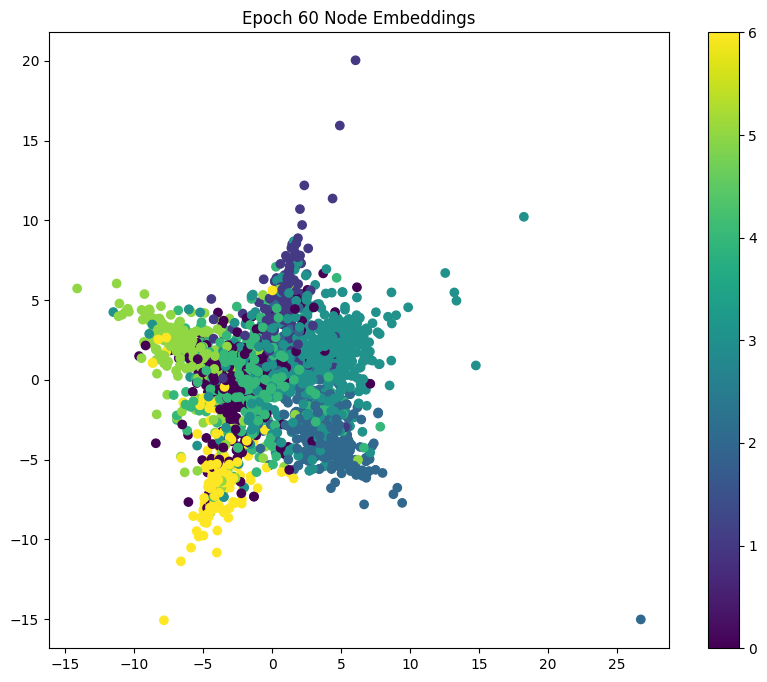

Model 2 - Epoch: 070, Loss: 0.0535, Train: 1.0000, Val: 0.7080, Test: 0.7470, Precision: 0.7727, Recall: 0.7470, F1: 0.7461
Node Embeddings (Epoch 70):
[[ 4.9942217   3.2651427 ]
 [-3.6577291   0.70087314]
 [-1.932116   -0.01063401]
 ...
 [-6.6815577   3.9713974 ]
 [ 5.334794    4.0470333 ]
 [ 4.3268733   3.552588  ]]


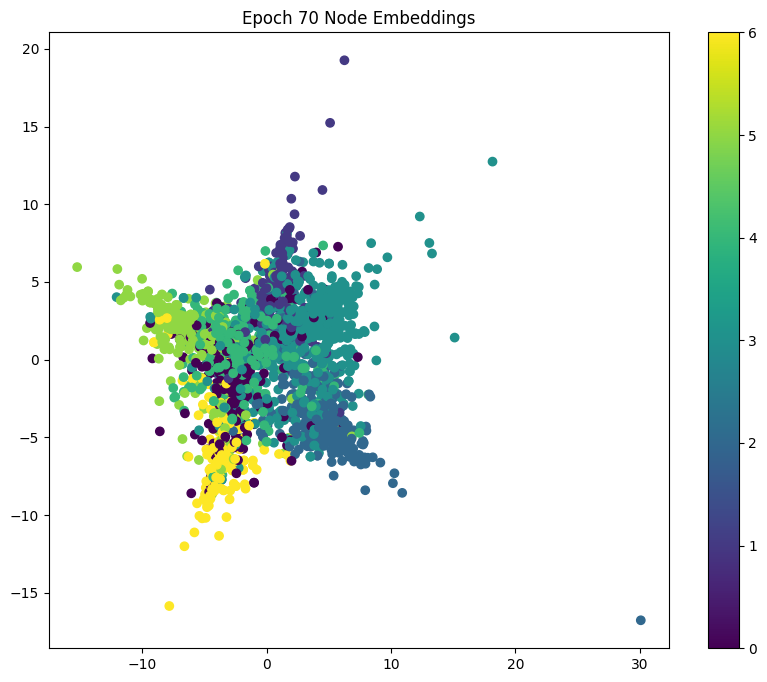

Model 2 - Epoch: 080, Loss: 0.0427, Train: 1.0000, Val: 0.7140, Test: 0.7450, Precision: 0.7689, Recall: 0.7450, F1: 0.7433
Node Embeddings (Epoch 80):
[[ 4.8429704  4.0912557]
 [-4.2039847  1.1389651]
 [-2.4948156  0.5639196]
 ...
 [-7.2291217  3.4701638]
 [ 5.2311964  4.872236 ]
 [ 4.2082253  4.2603354]]


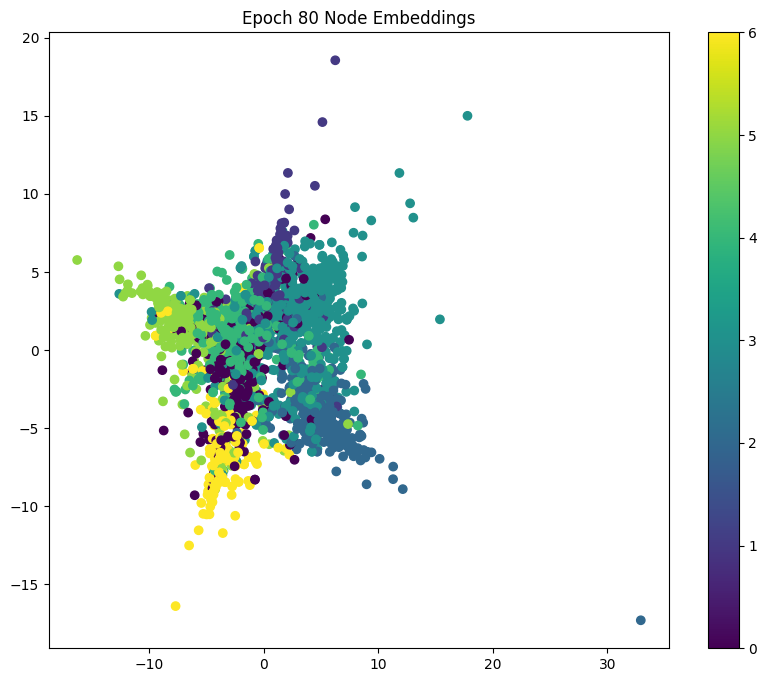

Model 2 - Epoch: 090, Loss: 0.0353, Train: 1.0000, Val: 0.7080, Test: 0.7450, Precision: 0.7691, Recall: 0.7450, F1: 0.7433
Node Embeddings (Epoch 90):
[[ 4.6765     4.760442 ]
 [-4.6088514  1.3773795]
 [-2.934226   0.929459 ]
 ...
 [-7.6395116  3.0651271]
 [ 5.1314588  5.5096765]
 [ 4.09059    4.805797 ]]


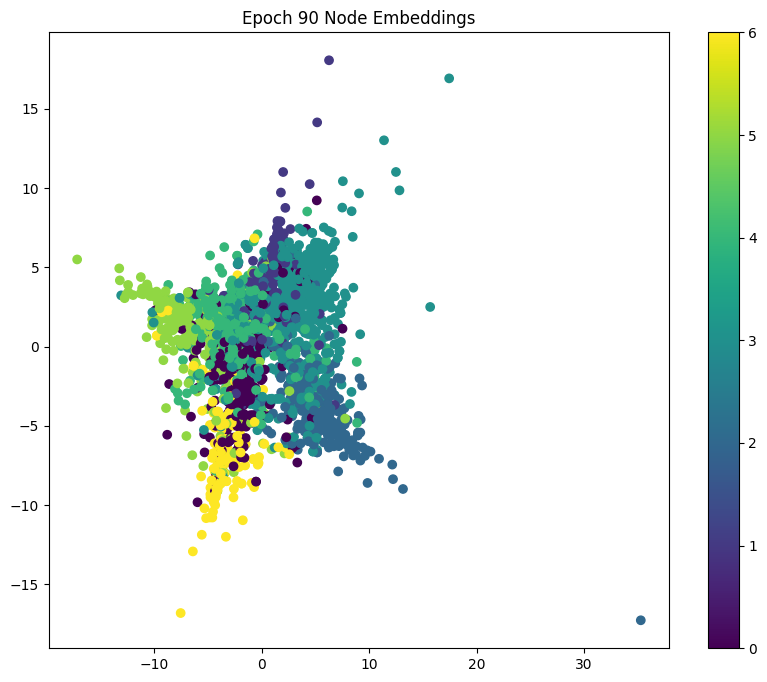

Model 2 - Epoch: 100, Loss: 0.0299, Train: 1.0000, Val: 0.7060, Test: 0.7420, Precision: 0.7659, Recall: 0.7420, F1: 0.7402
Node Embeddings (Epoch 100):
[[ 4.5152826  5.306793 ]
 [-4.928565   1.4987994]
 [-3.2966466  1.154117 ]
 ...
 [-7.9709344  2.7473564]
 [ 5.0343194  6.022289 ]
 [ 3.9782968  5.2451344]]


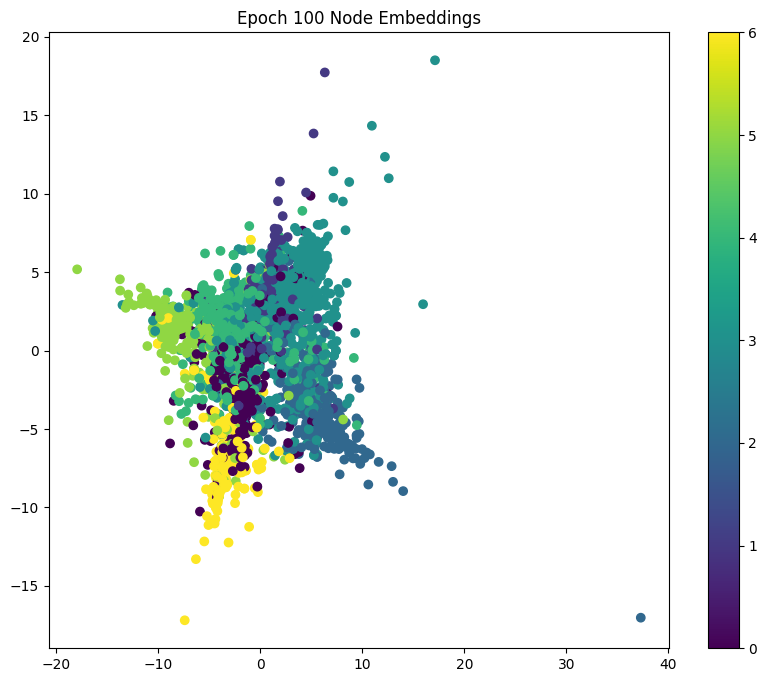

Model 2 - Epoch: 110, Loss: 0.0258, Train: 1.0000, Val: 0.7040, Test: 0.7410, Precision: 0.7652, Recall: 0.7410, F1: 0.7393
Node Embeddings (Epoch 110):
[[ 4.364314   5.7608542]
 [-5.2031155  1.5564973]
 [-3.6107745  1.2915101]
 ...
 [-8.252035   2.4895115]
 [ 4.942686   6.4502544]
 [ 3.873257   5.611774 ]]


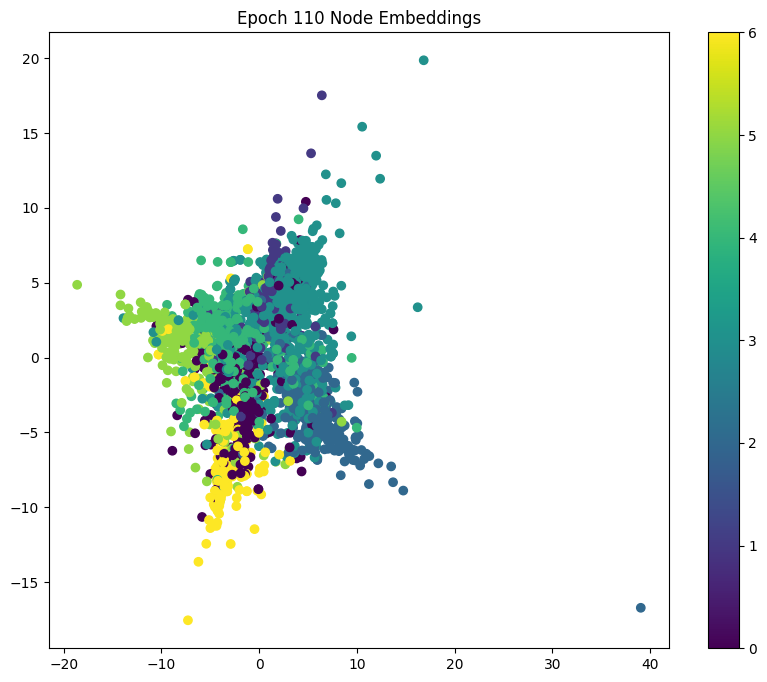

Model 2 - Epoch: 120, Loss: 0.0226, Train: 1.0000, Val: 0.7080, Test: 0.7330, Precision: 0.7562, Recall: 0.7330, F1: 0.7311
Node Embeddings (Epoch 120):
[[ 4.215407   6.155195 ]
 [-5.4435496  1.5802068]
 [-3.8846426  1.3767365]
 ...
 [-8.510703   2.264525 ]
 [ 4.8494797  6.823444 ]
 [ 3.769925   5.931945 ]]


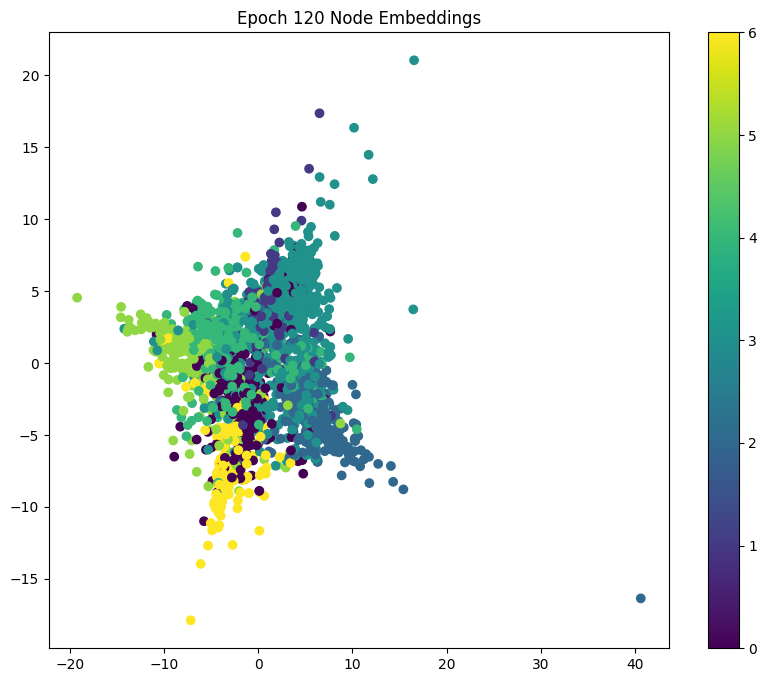

Model 2 - Epoch: 130, Loss: 0.0200, Train: 1.0000, Val: 0.7060, Test: 0.7320, Precision: 0.7554, Recall: 0.7320, F1: 0.7300
Node Embeddings (Epoch 130):
[[ 4.0680637  6.5019526]
 [-5.6525803  1.5792518]
 [-4.1215973  1.4241238]
 ...
 [-8.751579   2.067474 ]
 [ 4.753189   7.153838 ]
 [ 3.6666467  6.2137957]]


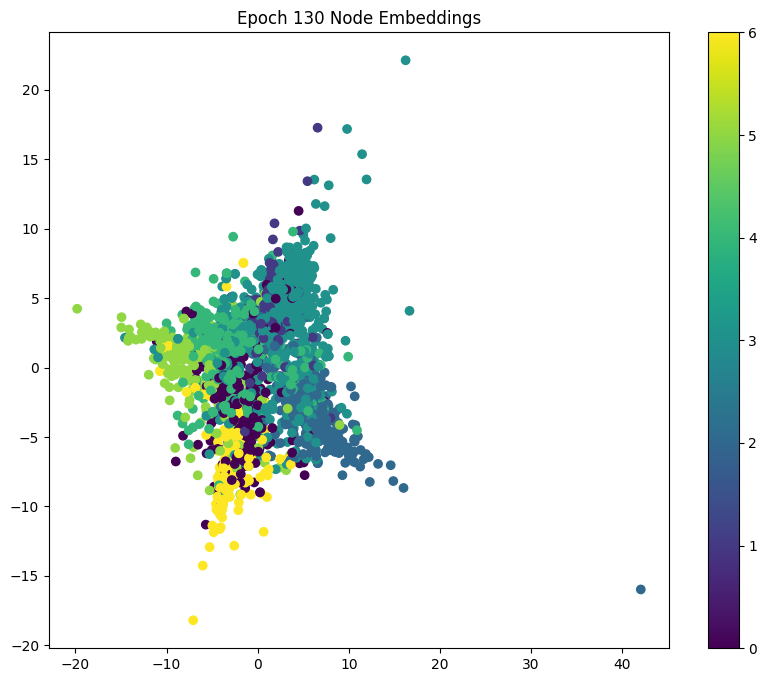

Model 2 - Epoch: 140, Loss: 0.0178, Train: 1.0000, Val: 0.7060, Test: 0.7280, Precision: 0.7514, Recall: 0.7280, F1: 0.7261
Node Embeddings (Epoch 140):
[[ 3.9276912  6.811206 ]
 [-5.832466   1.5642879]
 [-4.3241854  1.4469588]
 ...
 [-8.977439   1.8948138]
 [ 4.6591434  7.4492097]
 [ 3.567067   6.465277 ]]


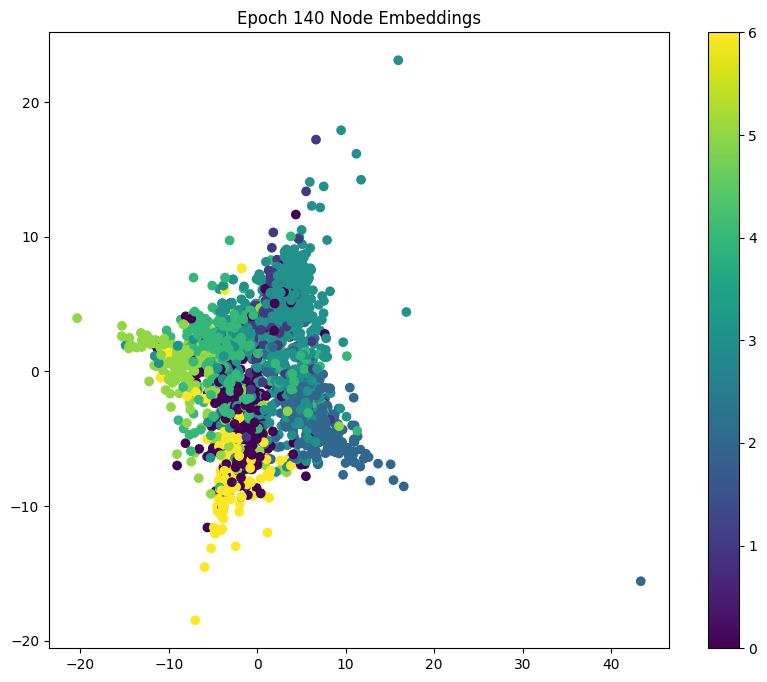

Model 2 - Epoch: 150, Loss: 0.0160, Train: 1.0000, Val: 0.7060, Test: 0.7250, Precision: 0.7499, Recall: 0.7250, F1: 0.7233
Node Embeddings (Epoch 150):
[[ 3.798386   7.089467 ]
 [-5.9879932  1.54236  ]
 [-4.497472   1.4543017]
 ...
 [-9.188446   1.74381  ]
 [ 4.57196    7.714641 ]
 [ 3.4741683  6.691633 ]]


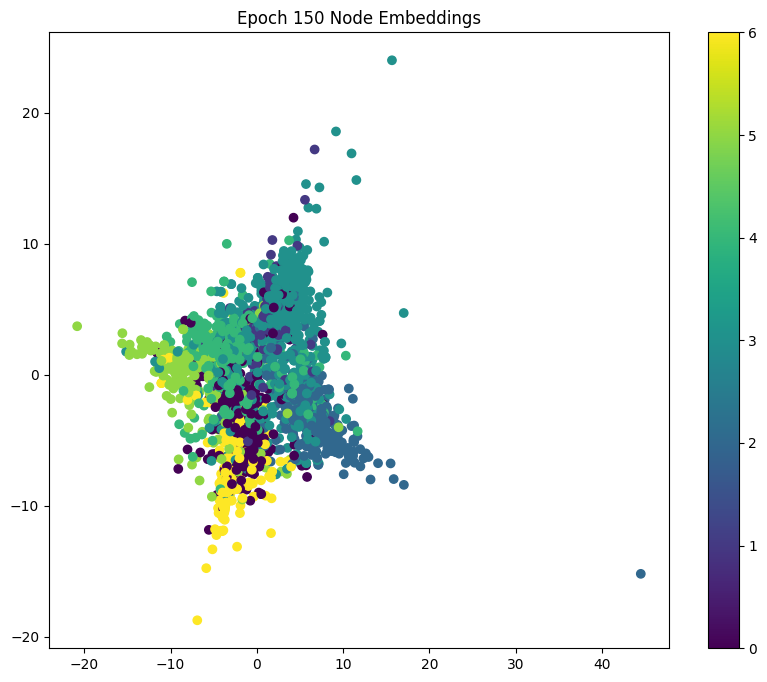

Model 2 - Epoch: 160, Loss: 0.0145, Train: 1.0000, Val: 0.7040, Test: 0.7250, Precision: 0.7508, Recall: 0.7250, F1: 0.7231
Node Embeddings (Epoch 160):
[[ 3.6796527  7.3424244]
 [-6.1237416  1.5174235]
 [-4.6468983  1.4522592]
 ...
 [-9.385997   1.6094061]
 [ 4.491368   7.9556885]
 [ 3.3876014  6.8975077]]


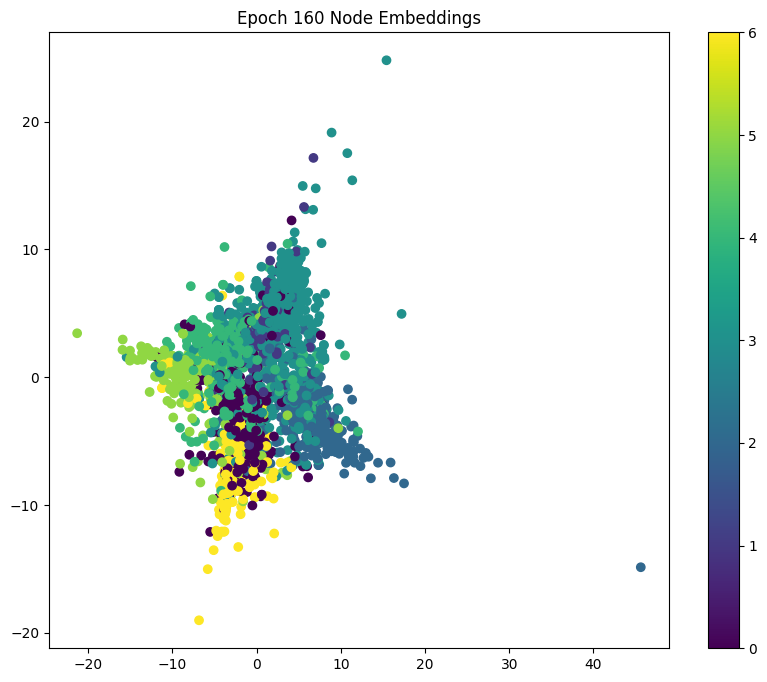

Model 2 - Epoch: 170, Loss: 0.0133, Train: 1.0000, Val: 0.7020, Test: 0.7260, Precision: 0.7515, Recall: 0.7260, F1: 0.7242
Node Embeddings (Epoch 170):
[[ 3.56926    7.5748763]
 [-6.2435446  1.491646 ]
 [-4.777151   1.4447675]
 ...
 [-9.572308   1.4864895]
 [ 4.415539   8.1773   ]
 [ 3.305918   7.0869117]]


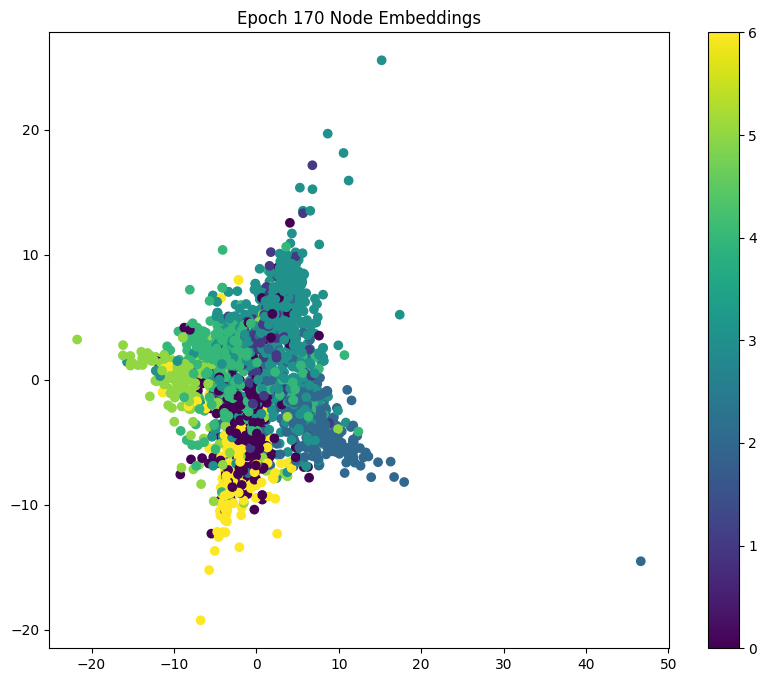

Model 2 - Epoch: 180, Loss: 0.0122, Train: 1.0000, Val: 0.7040, Test: 0.7220, Precision: 0.7483, Recall: 0.7220, F1: 0.7201
Node Embeddings (Epoch 180):
[[ 3.465322   7.7898965]
 [-6.3507457  1.4654701]
 [-4.892204   1.4334884]
 ...
 [-9.748936   1.3721817]
 [ 4.343161   8.382683 ]
 [ 3.2279305  7.262385 ]]


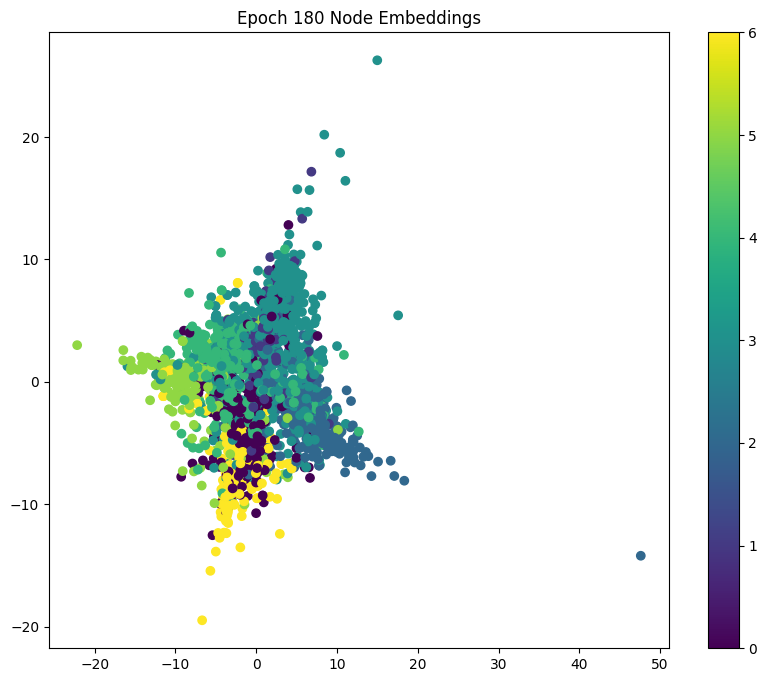

Model 2 - Epoch: 190, Loss: 0.0112, Train: 1.0000, Val: 0.7040, Test: 0.7220, Precision: 0.7483, Recall: 0.7220, F1: 0.7201
Node Embeddings (Epoch 190):
[[ 3.3663535  7.9900036]
 [-6.447827   1.4390502]
 [-4.995107   1.419426 ]
 ...
 [-9.917149   1.2645283]
 [ 4.2732353  8.574302 ]
 [ 3.1527038  7.4260187]]


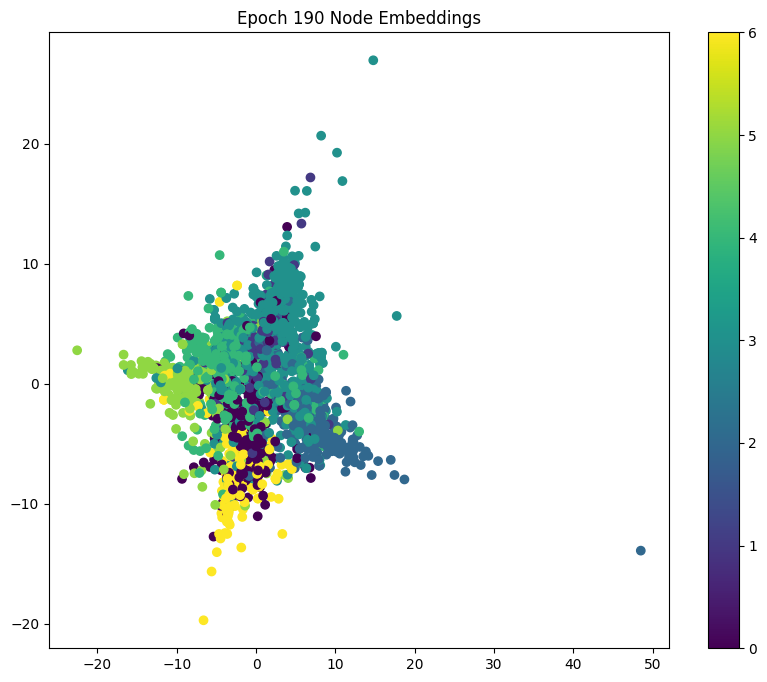

Model 2 - Epoch: 200, Loss: 0.0104, Train: 1.0000, Val: 0.7040, Test: 0.7220, Precision: 0.7483, Recall: 0.7220, F1: 0.7201
Node Embeddings (Epoch 200):
[[  3.2715034   8.177084 ]
 [ -6.536632    1.4125049]
 [ -5.088185    1.4033225]
 ...
 [-10.077653    1.1623116]
 [  4.205184    8.754042 ]
 [  3.0797143   7.5793653]]


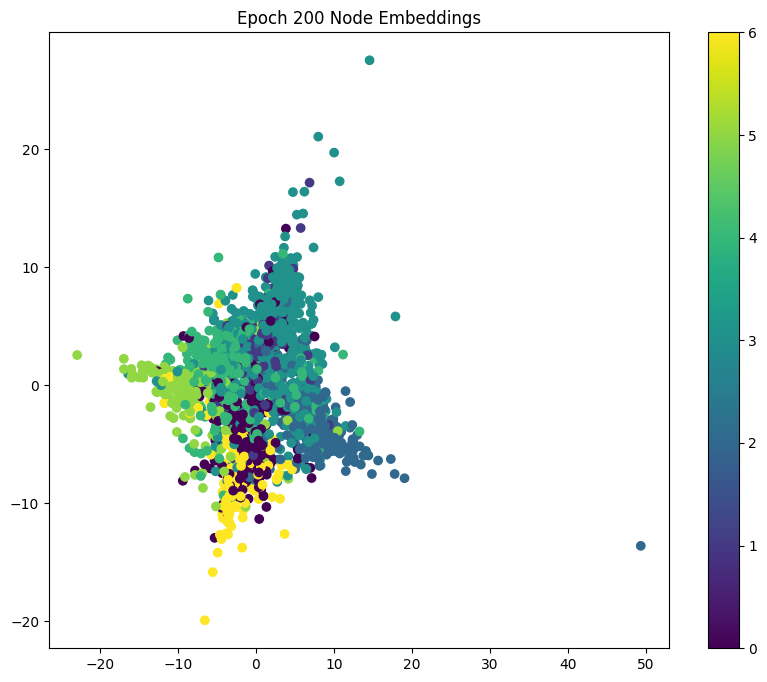

In [ ]:
writer2 = SummaryWriter('runs/model2')

epochs2 = []
train_losses2 = []
train_accuracies2 = []
val_accuracies2 = []
test_accuracies2 = []
precisions2 = []
recalls2 = []
f1_scores2 = []

for epoch in range(1, num_epochs + 1):
    loss2 = train(data, data.train_mask, model2, optimizer2, criterion2)
    train_acc2 = test(data, data.train_mask, model2)
    val_acc2 = test(data, data.val_mask, model2)
    test_acc2 = test(data, data.test_mask, model2)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model2(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs2.append(epoch)
        train_losses2.append(loss2.detach().item() if isinstance(loss2, torch.Tensor) else loss2)
        train_accuracies2.append(train_acc2.detach().item() if isinstance(train_acc2, torch.Tensor) else train_acc2)
        val_accuracies2.append(val_acc2.detach().item() if isinstance(val_acc2, torch.Tensor) else val_acc2)
        test_accuracies2.append(test_acc2.detach().item() if isinstance(test_acc2, torch.Tensor) else test_acc2)
        precisions2.append(precision)
        recalls2.append(recall)
        f1_scores2.append(f1)

        print(f'Model 2 - Epoch: {epoch:03d}, Loss: {loss2:.4f}, Train: {train_acc2:.4f}, Val: {val_acc2:.4f}, Test: {test_acc2:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        node_embeddings = model2(data.x, data.edge_index)

        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer2.add_scalar('Loss/Train', loss2, epoch)
    writer2.add_scalar('Accuracy/Train', train_acc2, epoch)
    writer2.add_scalar('Accuracy/Validation', val_acc2, epoch)
    writer2.add_scalar('Accuracy/Test', test_acc2, epoch)
    writer2.add_scalar('Precision/Test', precision, epoch)
    writer2.add_scalar('Recall/Test', recall, epoch)
    writer2.add_scalar('F1-Score/Test', f1, epoch)

writer2.close()

# Metrices Documention model 2

In [ ]:
# Saving metrics to a DataFrame for Model 2
metrics2 = pd.DataFrame({
    "Epoch": epochs2,
    "Train Loss": train_losses2,
    "Train Accuracy": train_accuracies2,
    "Validation Accuracy": val_accuracies2,
    "Test Accuracy": test_accuracies2,
})

metrics2.to_csv('model2_metrics.csv', index=False)

print("Metrics for Model 2 saved to 'model2_metrics.csv'")

files.download('model2_metrics.csv')

Metrics for Model 2 saved to 'model2_metrics.csv'


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Learning Curve for Second Model | Mohamed Khairi

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs2, y=train_losses2, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs2, y=train_accuracies2, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs2, y=val_accuracies2, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs2, y=test_accuracies2, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Second Model | Mohamed Khairi',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# Train and test 'third' model after tuning -  Mostapha Abdelaziz

Model 3 - Epoch: 010, Loss: 1.8470, Train: 0.1929, Val: 0.0780, Test: 0.0760, Precision: 0.1071, Recall: 0.0760, F1: 0.0293
Node Embeddings (Epoch 10):
[[-0.06119117 -0.00507227]
 [-0.25170335 -0.12112662]
 [-0.232932   -0.09480447]
 ...
 [-0.10467389  0.05994882]
 [-0.08270505 -0.02048188]
 [-0.02096882 -0.03198904]]


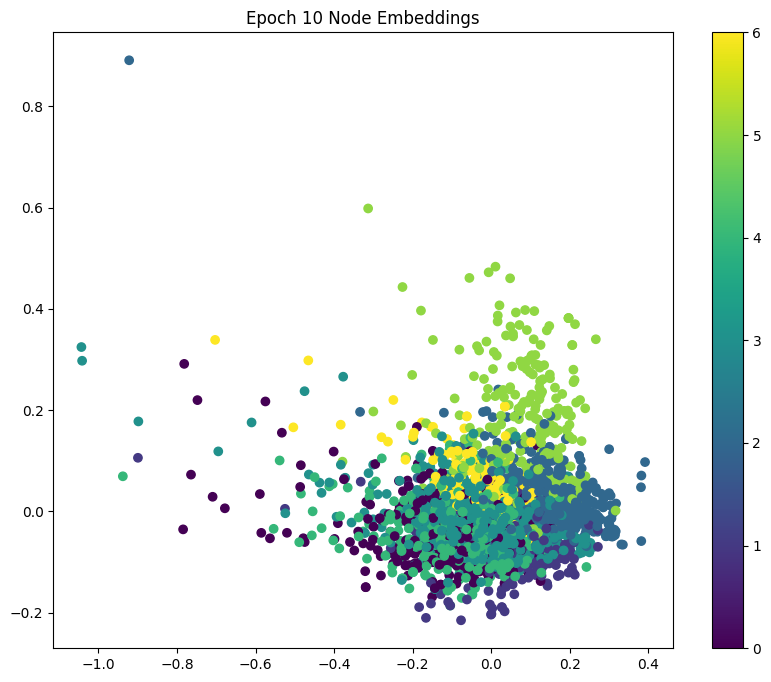

Model 3 - Epoch: 020, Loss: 1.5764, Train: 0.7786, Val: 0.5500, Test: 0.5310, Precision: 0.7821, Recall: 0.5310, F1: 0.4902
Node Embeddings (Epoch 20):
[[ 0.1146446   0.03464955]
 [ 0.7810871   0.05192526]
 [ 0.7290185   0.07837061]
 ...
 [ 0.05770959 -0.2556495 ]
 [ 0.20729928  0.03547608]
 [ 0.16410275  0.02040192]]


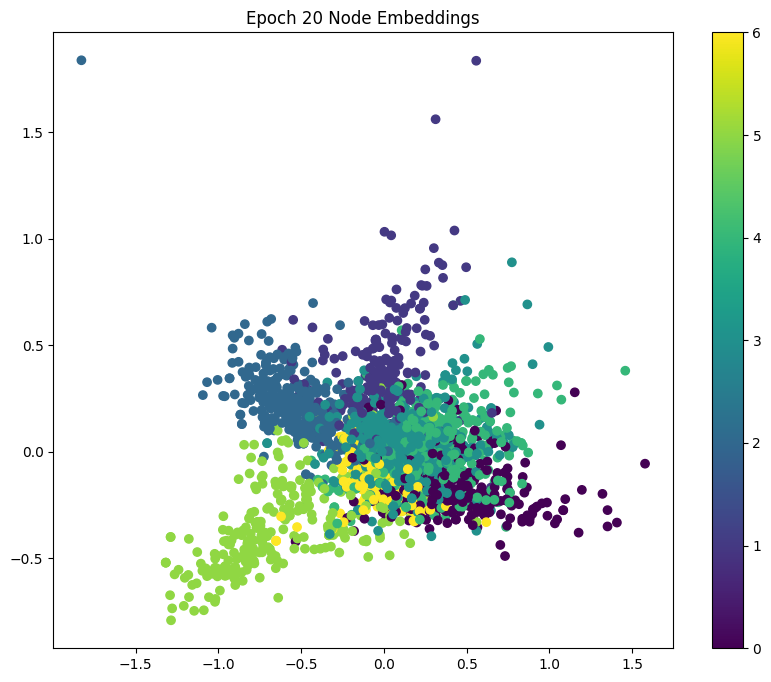

Model 3 - Epoch: 030, Loss: 1.1390, Train: 0.9571, Val: 0.7760, Test: 0.7670, Precision: 0.8015, Recall: 0.7670, F1: 0.7696
Node Embeddings (Epoch 30):
[[ 0.4539523   0.09363682]
 [ 1.5948195   0.01390582]
 [ 1.566467    0.13741022]
 ...
 [ 0.10326575 -0.6565451 ]
 [ 0.54338366  0.03170115]
 [ 0.45465457  0.03690595]]


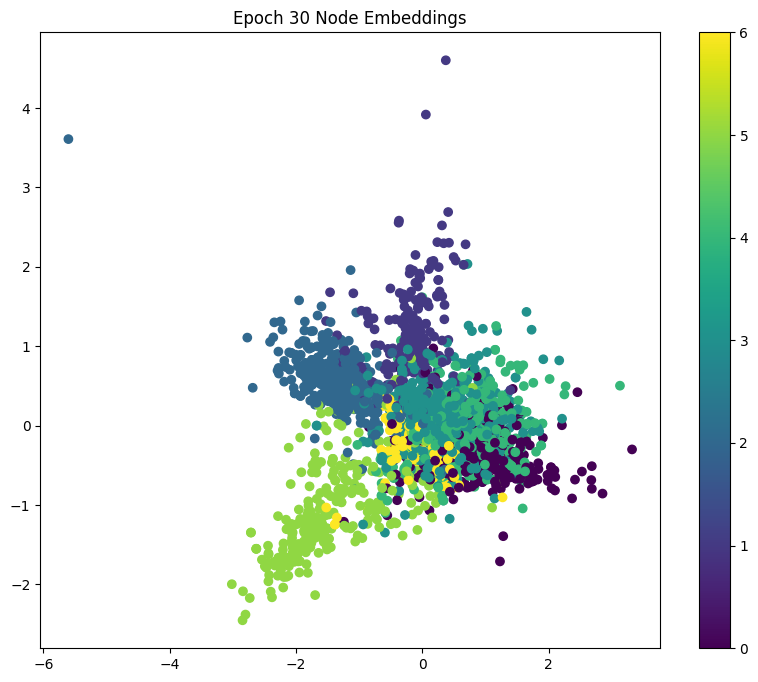

Model 3 - Epoch: 040, Loss: 0.6884, Train: 0.9714, Val: 0.7900, Test: 0.7880, Precision: 0.8106, Recall: 0.7880, F1: 0.7895
Node Embeddings (Epoch 40):
[[ 1.0337882  -0.14808625]
 [ 2.4102745  -0.51888096]
 [ 2.3340192  -0.70731556]
 ...
 [ 0.5235393   1.2165407 ]
 [ 0.9428659  -0.21467417]
 [ 0.76720506 -0.21794263]]


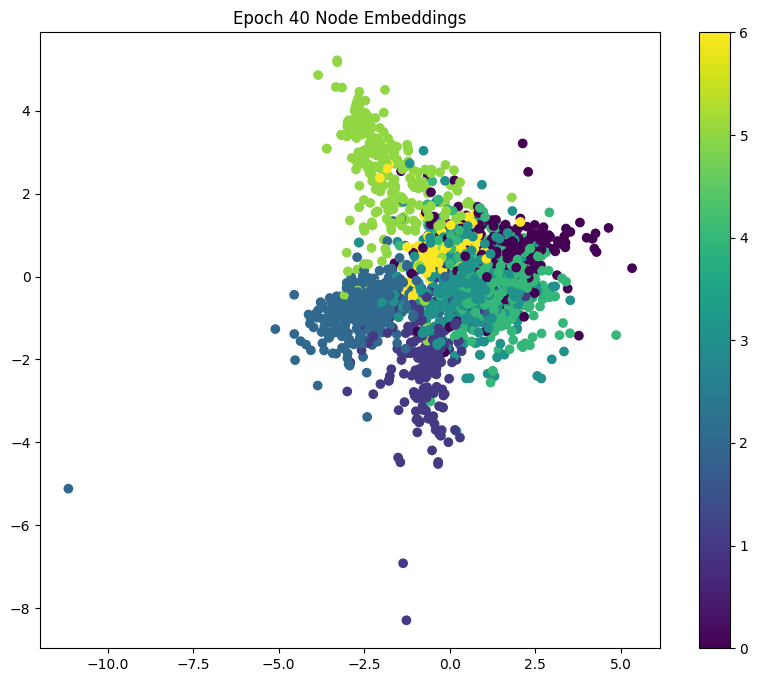

Model 3 - Epoch: 050, Loss: 0.3894, Train: 0.9929, Val: 0.7860, Test: 0.8050, Precision: 0.8177, Recall: 0.8050, F1: 0.8058
Node Embeddings (Epoch 50):
[[ 1.4656622  -0.34890535]
 [ 2.872277   -1.152364  ]
 [ 2.7067459  -1.3898653 ]
 ...
 [ 1.02122     1.5285077 ]
 [ 1.3108318  -0.7121899 ]
 [ 1.0358783  -0.6446996 ]]


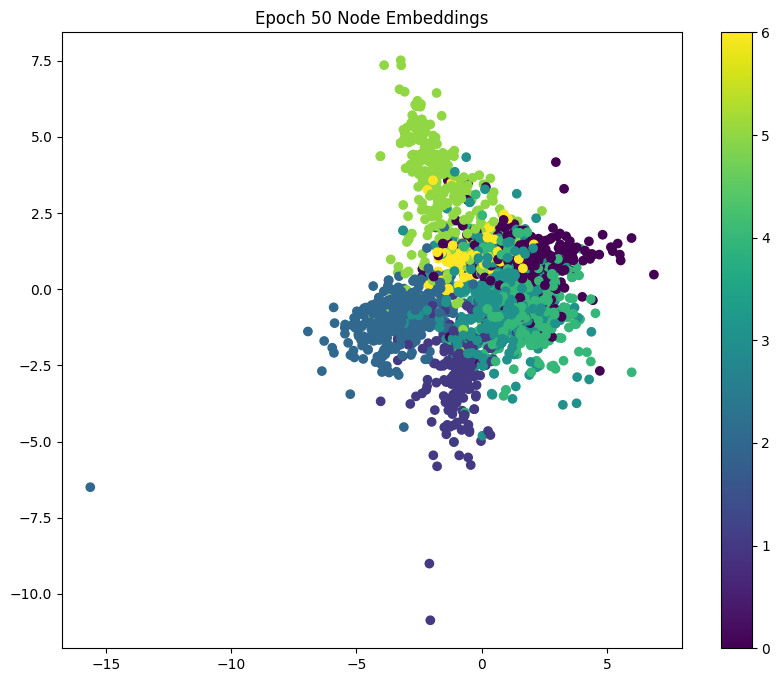

Model 3 - Epoch: 060, Loss: 0.2386, Train: 1.0000, Val: 0.7820, Test: 0.8070, Precision: 0.8185, Recall: 0.8070, F1: 0.8078
Node Embeddings (Epoch 60):
[[ 1.6211817 -0.8721415]
 [ 3.122655  -1.6457345]
 [ 2.8497078 -1.9979074]
 ...
 [ 1.4658427  1.7338728]
 [ 1.5463498 -1.3701583]
 [ 1.2205989 -1.1979666]]


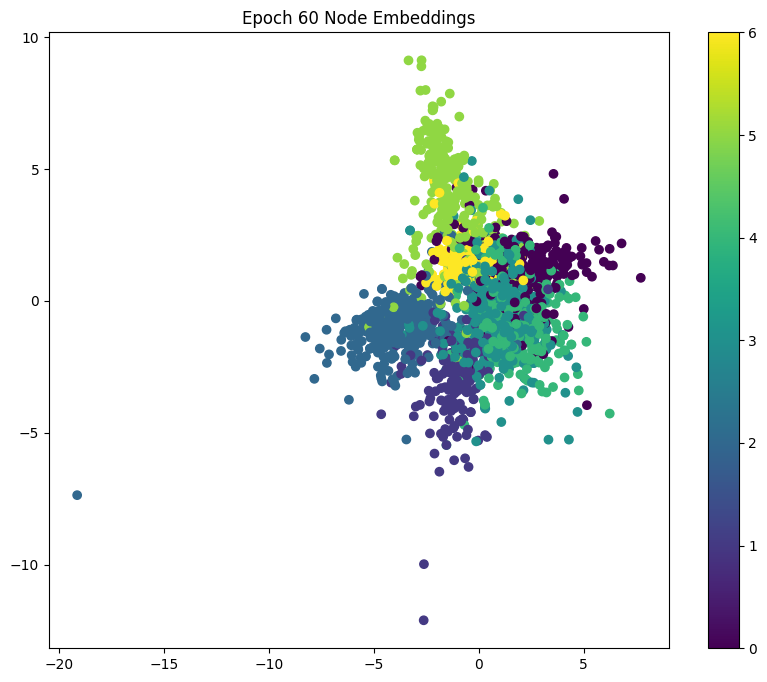

Model 3 - Epoch: 070, Loss: 0.1673, Train: 1.0000, Val: 0.7780, Test: 0.8100, Precision: 0.8196, Recall: 0.8100, F1: 0.8105
Node Embeddings (Epoch 70):
[[ 1.4849577 -1.5565473]
 [ 3.0596902 -2.275906 ]
 [ 2.6623752 -2.6647182]
 ...
 [ 2.0125842  1.7247951]
 [ 1.4012886 -2.2098212]
 [ 1.1061382 -1.8817683]]


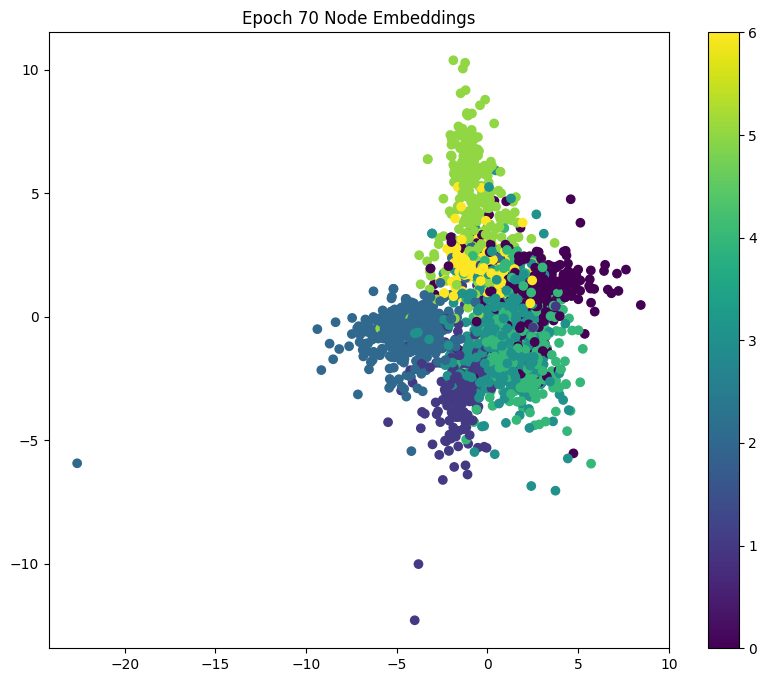

Model 3 - Epoch: 080, Loss: 0.1300, Train: 1.0000, Val: 0.7840, Test: 0.8110, Precision: 0.8205, Recall: 0.8110, F1: 0.8113
Node Embeddings (Epoch 80):
[[ 1.0945822  -2.1520474 ]
 [ 2.62852    -3.0545778 ]
 [ 2.1325228  -3.3634906 ]
 ...
 [ 2.6375165   1.4813318 ]
 [ 0.89070314 -2.887957  ]
 [ 0.6888648  -2.429757  ]]


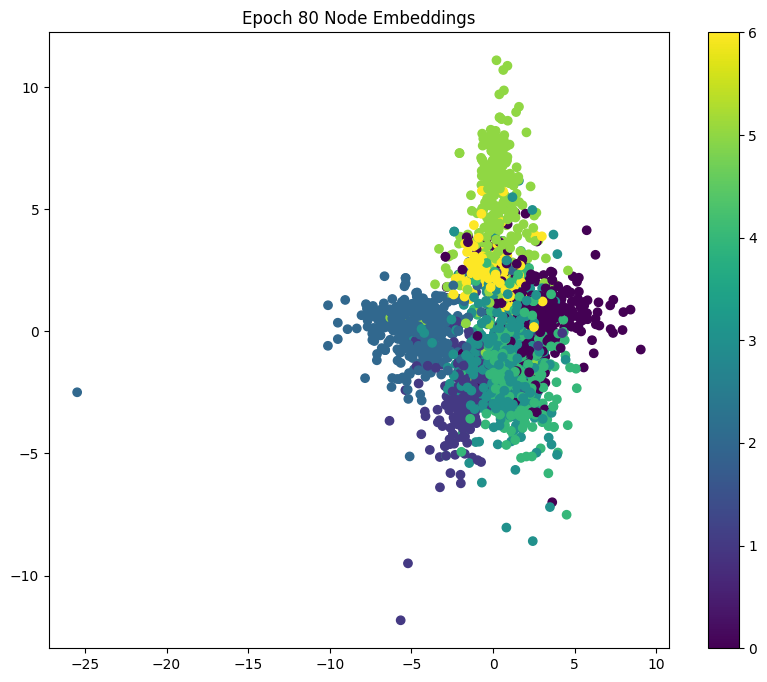

Model 3 - Epoch: 090, Loss: 0.1080, Train: 1.0000, Val: 0.7840, Test: 0.8120, Precision: 0.8221, Recall: 0.8120, F1: 0.8125
Node Embeddings (Epoch 90):
[[ 0.6210569  -2.524002  ]
 [ 2.0871544  -3.6264474 ]
 [ 1.5366079  -3.8338358 ]
 ...
 [ 3.158036    1.0582772 ]
 [ 0.32104185 -3.277373  ]
 [ 0.21531463 -2.7469811 ]]


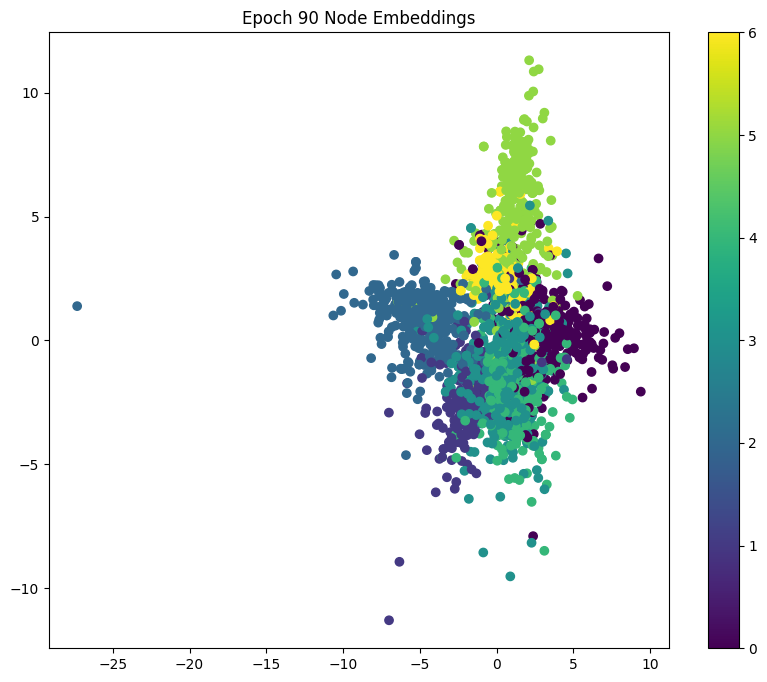

Model 3 - Epoch: 100, Loss: 0.0936, Train: 1.0000, Val: 0.7820, Test: 0.8060, Precision: 0.8160, Recall: 0.8060, F1: 0.8065
Node Embeddings (Epoch 100):
[[ 0.31900483 -2.7086127 ]
 [ 1.7886436  -3.8873386 ]
 [ 1.1989734  -4.0516634 ]
 ...
 [ 3.5558174   0.7818993 ]
 [-0.01784973 -3.4725304 ]
 [-0.06689744 -2.9046443 ]]


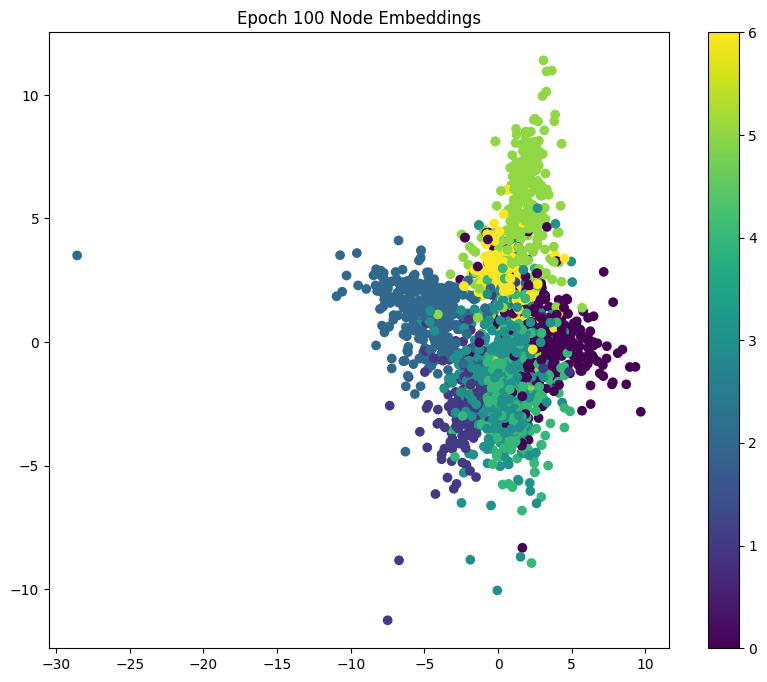

Model 3 - Epoch: 110, Loss: 0.0834, Train: 1.0000, Val: 0.7800, Test: 0.8030, Precision: 0.8133, Recall: 0.8030, F1: 0.8034
Node Embeddings (Epoch 110):
[[ 0.18794458 -2.8183136 ]
 [ 1.7067612  -3.9781072 ]
 [ 1.0864644  -4.1461573 ]
 ...
 [ 3.8382196   0.6840321 ]
 [-0.13775109 -3.5926106 ]
 [-0.16549106 -3.0012975 ]]


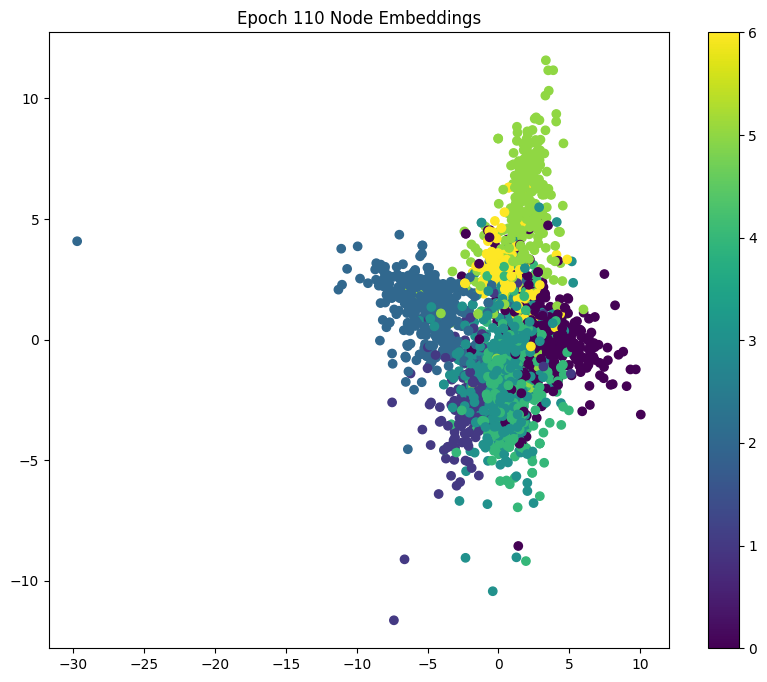

Model 3 - Epoch: 120, Loss: 0.0757, Train: 1.0000, Val: 0.7780, Test: 0.8040, Precision: 0.8145, Recall: 0.8040, F1: 0.8045
Node Embeddings (Epoch 120):
[[ 0.12851064 -2.900018  ]
 [ 1.6956953  -4.010048  ]
 [ 1.0560051  -4.1926985 ]
 ...
 [ 4.0629916   0.67372465]
 [-0.17032096 -3.6829202 ]
 [-0.19126713 -3.0752556 ]]


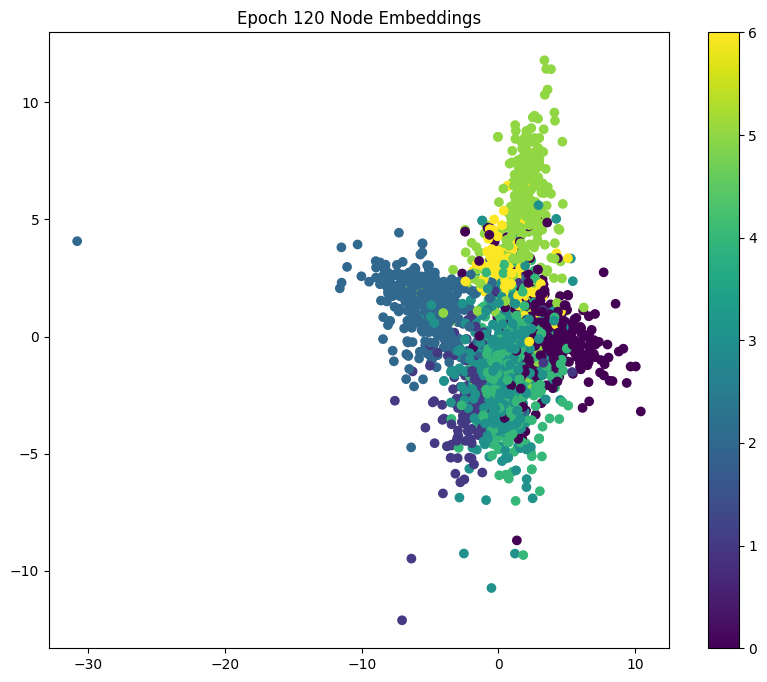

Model 3 - Epoch: 130, Loss: 0.0698, Train: 1.0000, Val: 0.7760, Test: 0.8040, Precision: 0.8141, Recall: 0.8040, F1: 0.8044
Node Embeddings (Epoch 130):
[[ 0.10100858 -2.9629364 ]
 [ 1.703754   -4.023522  ]
 [ 1.0541222  -4.2182207 ]
 ...
 [ 4.2378016   0.68038625]
 [-0.17430654 -3.7557044 ]
 [-0.1939815  -3.13511   ]]


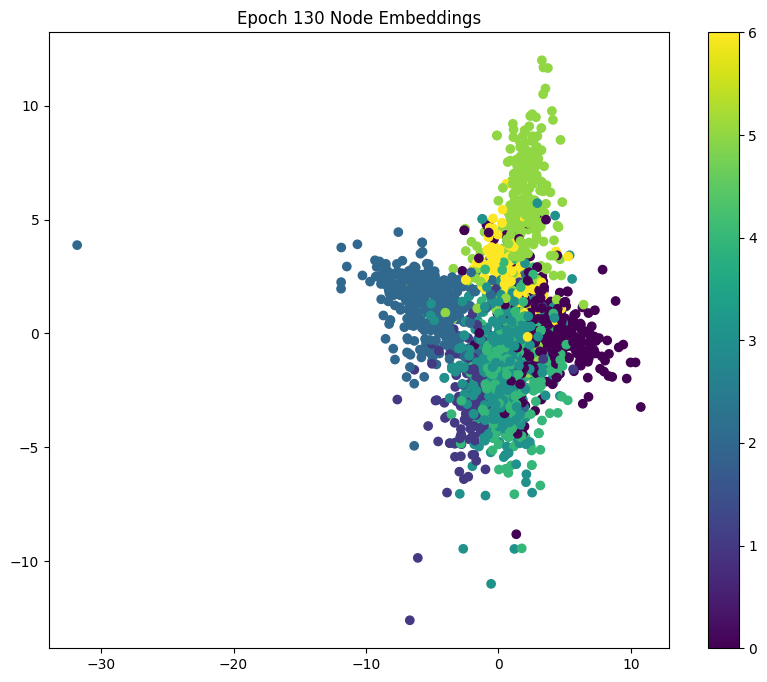

Model 3 - Epoch: 140, Loss: 0.0650, Train: 1.0000, Val: 0.7760, Test: 0.8040, Precision: 0.8141, Recall: 0.8040, F1: 0.8044
Node Embeddings (Epoch 140):
[[ 0.08836715 -3.0128887 ]
 [ 1.7264017  -4.026075  ]
 [ 1.068576   -4.230575  ]
 ...
 [ 4.3817244   0.6880469 ]
 [-0.16631559 -3.816655  ]
 [-0.18756554 -3.1839757 ]]


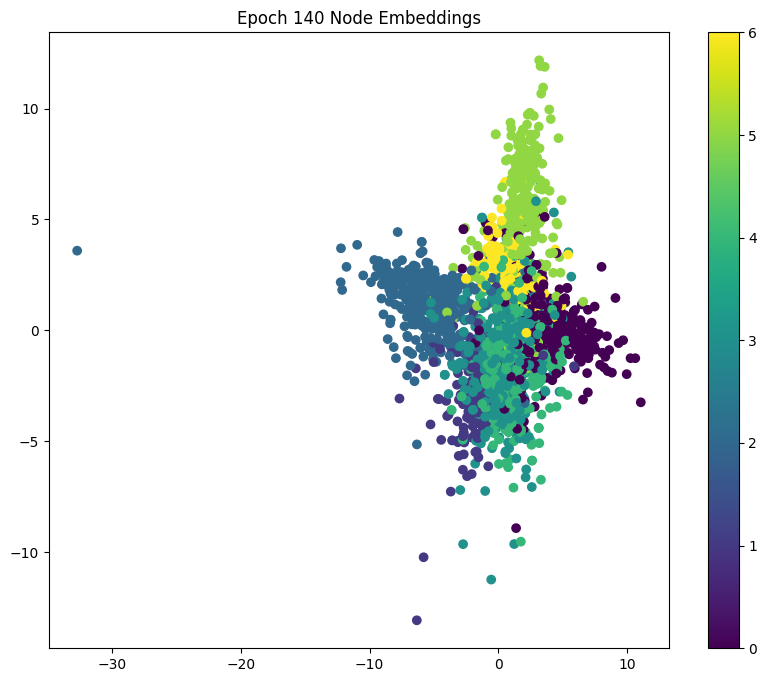

Model 3 - Epoch: 150, Loss: 0.0611, Train: 1.0000, Val: 0.7760, Test: 0.8040, Precision: 0.8140, Recall: 0.8040, F1: 0.8044
Node Embeddings (Epoch 150):
[[ 0.07768169 -3.052627  ]
 [ 1.7602406  -4.020595  ]
 [ 1.0895891  -4.2345266 ]
 ...
 [ 4.514955    0.6973749 ]
 [-0.15602276 -3.8679628 ]
 [-0.17978185 -3.2248106 ]]


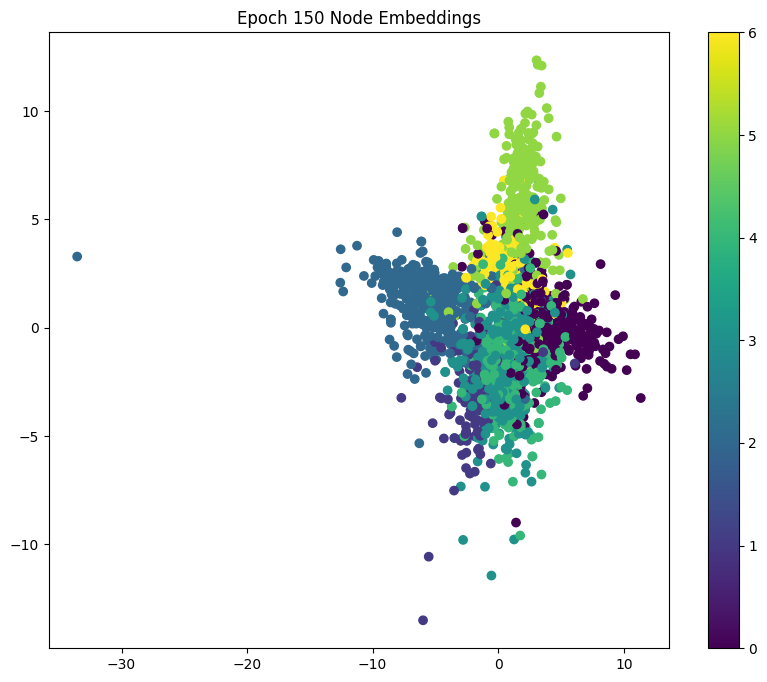

Model 3 - Epoch: 160, Loss: 0.0578, Train: 1.0000, Val: 0.7760, Test: 0.8040, Precision: 0.8140, Recall: 0.8040, F1: 0.8044
Node Embeddings (Epoch 160):
[[ 0.06777516 -3.0850816 ]
 [ 1.7988997  -4.010708  ]
 [ 1.1116984  -4.233964  ]
 ...
 [ 4.639272    0.7066345 ]
 [-0.14621699 -3.9112916 ]
 [-0.17288244 -3.2590537 ]]


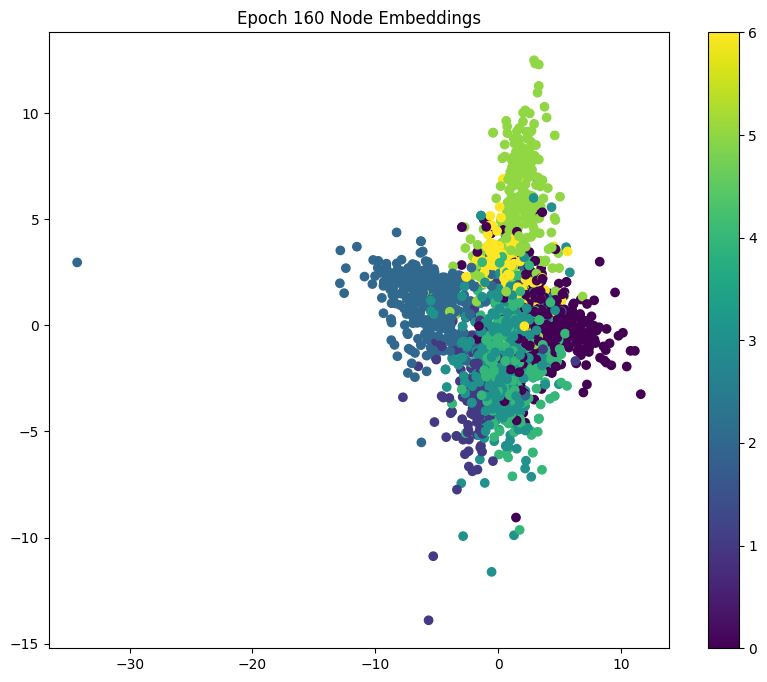

Model 3 - Epoch: 170, Loss: 0.0550, Train: 1.0000, Val: 0.7740, Test: 0.8040, Precision: 0.8139, Recall: 0.8040, F1: 0.8045
Node Embeddings (Epoch 170):
[[ 0.06098065 -3.1122296 ]
 [ 1.8380531  -3.9966636 ]
 [ 1.134318   -4.228941  ]
 ...
 [ 4.752522    0.7150797 ]
 [-0.13565275 -3.9492707 ]
 [-0.16562667 -3.2890072 ]]


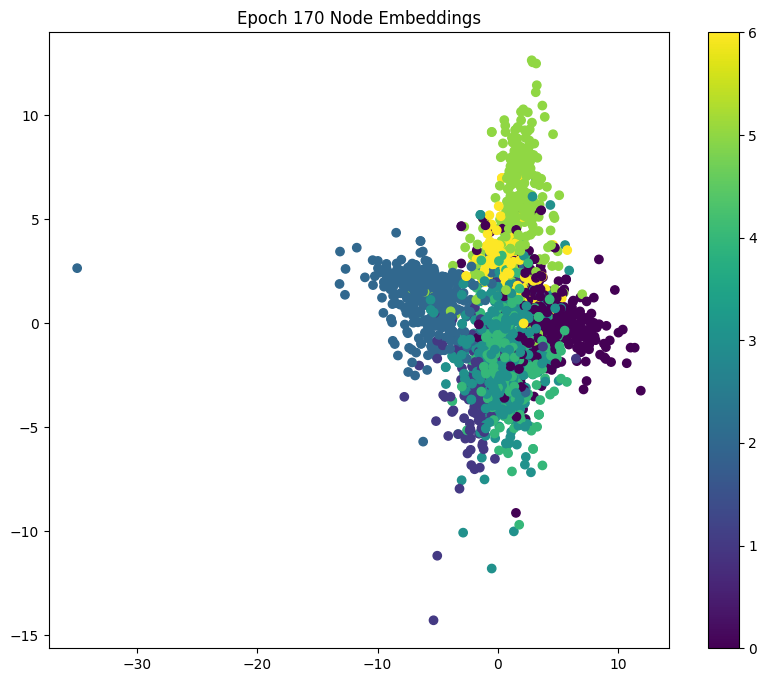

Model 3 - Epoch: 180, Loss: 0.0526, Train: 1.0000, Val: 0.7740, Test: 0.8030, Precision: 0.8128, Recall: 0.8030, F1: 0.8035
Node Embeddings (Epoch 180):
[[ 0.05547777 -3.135099  ]
 [ 1.8763067  -3.9788077 ]
 [ 1.156302   -4.2199364 ]
 ...
 [ 4.855939    0.7213115 ]
 [-0.1250763  -3.9822843 ]
 [-0.15881026 -3.3148143 ]]


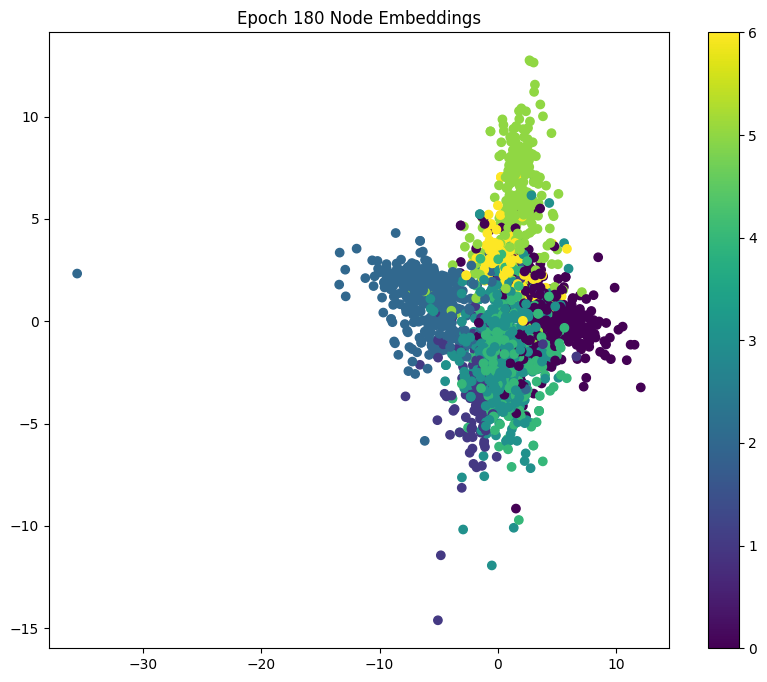

Model 3 - Epoch: 190, Loss: 0.0506, Train: 1.0000, Val: 0.7720, Test: 0.8030, Precision: 0.8128, Recall: 0.8030, F1: 0.8035
Node Embeddings (Epoch 190):
[[ 0.05054766 -3.1542242 ]
 [ 1.9137022  -3.9579003 ]
 [ 1.1775969  -4.207443  ]
 ...
 [ 4.9497967   0.7253049 ]
 [-0.11492035 -4.0109234 ]
 [-0.1526973  -3.3368716 ]]


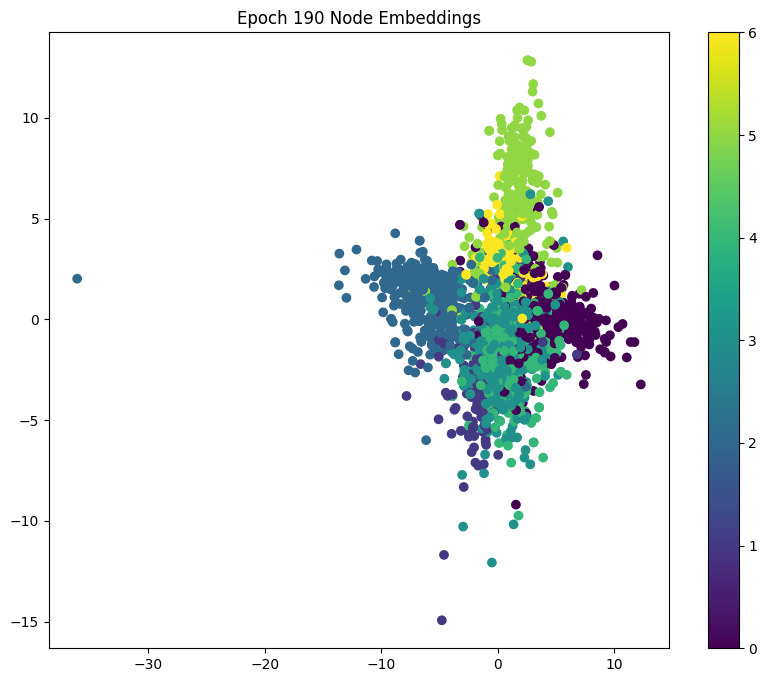

Model 3 - Epoch: 200, Loss: 0.0488, Train: 1.0000, Val: 0.7720, Test: 0.8020, Precision: 0.8119, Recall: 0.8020, F1: 0.8025
Node Embeddings (Epoch 200):
[[ 0.0458864  -3.1704063 ]
 [ 1.9495559  -3.9346588 ]
 [ 1.1974807  -4.192322  ]
 ...
 [ 5.036408    0.7271231 ]
 [-0.10545209 -4.0357246 ]
 [-0.14737788 -3.3557394 ]]


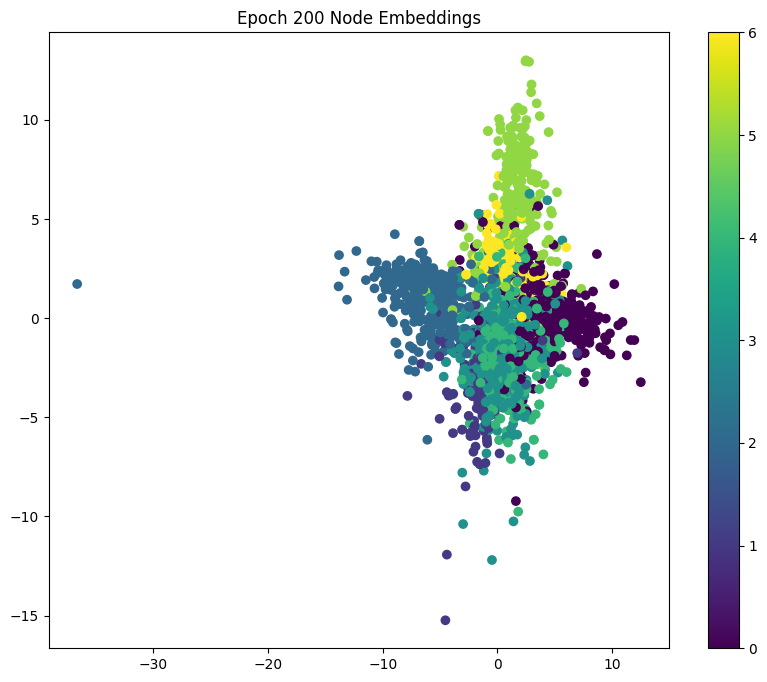

In [ ]:
writer3 = SummaryWriter('runs/model3')

epochs3 = []
train_losses3 = []
train_accuracies3 = []
val_accuracies3 = []
test_accuracies3 = []
precisions3 = []
recalls3 = []
f1_scores3 = []

for epoch in range(1, num_epochs + 1):
    loss3 = train(data, data.train_mask, model3, optimizer3, criterion3)
    train_acc3 = test(data, data.train_mask, model3)
    val_acc3 = test(data, data.val_mask, model3)
    test_acc3 = test(data, data.test_mask, model3)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model3(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs3.append(epoch)
        train_losses3.append(loss3.detach().item() if isinstance(loss3, torch.Tensor) else loss3)
        train_accuracies3.append(train_acc3.detach().item() if isinstance(train_acc3, torch.Tensor) else train_acc3)
        val_accuracies3.append(val_acc3.detach().item() if isinstance(val_acc3, torch.Tensor) else val_acc3)
        test_accuracies3.append(test_acc3.detach().item() if isinstance(test_acc3, torch.Tensor) else test_acc3)
        precisions3.append(precision)
        recalls3.append(recall)
        f1_scores3.append(f1)

        print(f'Model 3 - Epoch: {epoch:03d}, Loss: {loss3:.4f}, Train: {train_acc3:.4f}, Val: {val_acc3:.4f}, Test: {test_acc3:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        node_embeddings = model3(data.x, data.edge_index)

        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())


        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # visualizing the node embeddings using matplotlib
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer3.add_scalar('Loss/Train', loss3, epoch)
    writer3.add_scalar('Accuracy/Train', train_acc3, epoch)
    writer3.add_scalar('Accuracy/Validation', val_acc3, epoch)
    writer3.add_scalar('Accuracy/Test', test_acc3, epoch)
    writer3.add_scalar('Precision/Test', precision, epoch)
    writer3.add_scalar('Recall/Test', recall, epoch)
    writer3.add_scalar('F1-Score/Test', f1, epoch)

writer3.close()

# Metrices Documention model 3

In [ ]:
# Saving metrics to a DataFrame for Model 3
metrics3 = pd.DataFrame({
    "Epoch": epochs3,
    "Train Loss": train_losses3,
    "Train Accuracy": train_accuracies3,
    "Validation Accuracy": val_accuracies3,
    "Test Accuracy": test_accuracies3,
})

metrics3.to_csv('model3_metrics.csv', index=False)
print("Metrics for Model 3 saved to 'model3_metrics.csv'")
files.download('model3_metrics.csv')

Metrics for Model 3 saved to 'model3_metrics.csv'


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Learning Curve for Third Model | Mostapha Abdelaziz

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs3, y=train_losses3, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs3, y=train_accuracies3, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs3, y=val_accuracies3, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs3, y=test_accuracies3, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Third Model | Mostapha Abdelaziz',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# **Tensor Board For GCN Model with its Hyperparametars**

In [ ]:
%load_ext tensorboard
!tensorboard --logdir=runs --port=6006

2024-12-01 11:20:16.256660: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-01 11:20:16.283683: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-01 11:20:16.291110: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-01 11:20:17.934688: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Serving TensorBoard on localhost; to expose to 

# Run to preview on colab in case URL is not working on colab

In [ ]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

# Run in case you want to stop the currently running TensorBoard instance

In [ ]:
!kill 24684

/bin/bash: line 1: kill: (24684) - No such process




---



# **GCN Models Performance Analysis**

## 1. Model Architectures and Hyperparameters
- **Model 1**: 2 layers, ReLU activation, Learning Rate = 0.01
- **Model 2**: 3 layers, Tanh activation, Learning Rate = 0.005
- **Model 3**: 2 layers, Sigmoid activation, Learning Rate = 0.01

---

## 2. Training and Validation Metrics
### **Model 1**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 1.2747     | 59.29%         | 46.0%               | 46.4%         |
| 20    | 0.5749     | 94.29%         | 69.8%               | 69.6%         |
| 30    | 0.1912     | 98.57%         | 72.6%               | 73.4%         |
| 70    | 0.0056     | 100%           | 74.2%               | 74.6%         |
| 190   | 0.0009     | 100%           | 73.6%               | 74.7%         |

### **Model 2**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 1.1414     | 90.00%         | 71.8%               | 71.9%         |
| 20    | 0.5969     | 97.14%         | 75.8%               | 73.9%         |
| 30    | 0.3126     | 100%           | 75.0%               | 75.5%         |
| 70    | 0.0520     | 100%           | 73.0%               | 74.2%         |
| 190   | 0.0107     | 100%           | 70.8%               | 71.9%         |

### **Model 3**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 1.8342     | 35.71%         | 38.6%               | 39.1%         |
| 20    | 1.5279     | 84.29%         | 50.2%               | 51.7%         |
| 30    | 1.0848     | 92.14%         | 70.8%               | 72.1%         |
| 70    | 0.1966     | 100%           | 78.8%               | 81.5%         |
| 190   | 0.0511     | 100%           | 79.8%               | 81.6%         |

---

## 3. Learning Curves

### Model 1
- **Train Loss Over Epochs**:
  - The train loss started at **1.2747** and decreased steadily, reaching **0.0009** by epoch 190.
  - The most significant reduction occurred in the first 40 epochs, stabilizing near-zero values after epoch 150.
- **Accuracy Curves**:
  - Train accuracy began at **59.29%** and quickly improved to **100%** by epoch 40.
  - Validation accuracy showed gradual improvement, starting at **46.0%**, peaking at **74.2%**, and stabilizing around that range.
  - Test accuracy also improved from **46.4%** to a maximum of **74.7%**, with stable performance above **74%** after epoch 160.

### Model 2
- **Train Loss Over Epochs**:
  - Train loss began at **1.1414** and decreased steadily to **0.0107** by epoch 190.
  - The decline was more gradual than Model 1, with a noticeable plateau around epoch 120.
- **Accuracy Curves**:
  - Train accuracy started at **90.00%**, reaching **100%** by epoch 30.
  - Validation accuracy peaked early at **75.8%** but showed a slight decline to **70.8%** over time, suggesting potential overfitting.
  - Test accuracy peaked at **73.9%** by epoch 20 and gradually decreased to **71.9%** by epoch 190.

### Model 3
- **Train Loss Over Epochs**:
  - Train loss was initially high at **1.8342** but dropped to **0.0511** by epoch 190, with steady reductions throughout the training process.
  - The loss declined more gradually compared to the other models, especially after epoch 50.
- **Accuracy Curves**:
  - Train accuracy began at **35.71%**, reaching **100%** by epoch 60.
  - Validation accuracy showed a peak of **78.8%** around epoch 70 but remained slightly inconsistent, fluctuating around **79%**.
  - Test accuracy peaked at **81.5%** near epoch 70 and stabilized at **81.6%** by the end of training, indicating strong generalization performance.

---

## 4. Observations
- **Model 3** achieved the highest **Test Accuracy** of **81.6%** and showed stable performance across epochs.
- **Model 1** showed strong convergence but slightly lower performance compared to Models 2 and 3.
- **Model 2** had initial strong performance but experienced some degradation in later epochs due to possible overfitting.
- Adding more layers (**Model 3**) initially improved performance but plateaued, highlighting diminishing returns in deeper architectures.

---

## 5. Conclusion
- **Model 3** is the best-performing model, achieving the highest **Test Accuracy** and robust generalization performance.




---



# **2. SAGE Architecture | Abdelrahman Gamal and Karim Yasser**

In [ ]:
import torch
from torch_geometric.datasets import Planetoid
from torch_geometric.data import DataLoader
from torch.nn import CrossEntropyLoss
import torch.optim as optim
from torch_geometric.nn import SAGEConv
from torch.nn import functional as F

class GraphSAGE(torch.nn.Module):
    def __init__(self, hidden_dimension, num_layers=2, activation_func="ReLU", num_features=None, num_classes=None):
        super(GraphSAGE, self).__init__()

        self.num_layers = num_layers
        self.activation_func = activation_func

        # GraphSAGE layers
        self.conv1 = SAGEConv(num_features, hidden_dimension)  # First layer (from input to hidden)
        self.convs = torch.nn.ModuleList([SAGEConv(hidden_dimension, hidden_dimension) for _ in range(num_layers - 1)])  # Additional hidden layers
        self.conv_last = SAGEConv(hidden_dimension, num_classes)  # Last layer (from hidden to output)

    def forward(self, x, edge_index):
        # First layer
        x = self.conv1(x, edge_index)
        x = self.applyActivation(x)

        # Hidden layers
        for conv in self.convs:
            x = conv(x, edge_index)
            x = self.applyActivation(x)

        # Last layer (output layer)
        x = self.conv_last(x, edge_index)
        return x

    def applyActivation(self, x):
        if self.activation_func == "ReLU":
            return F.relu(x)
        elif self.activation_func == "Sigmoid":
            return torch.sigmoid(x)
        elif self.activation_func == "Tanh":
            return torch.tanh(x)
        else:
            raise ValueError("Unsupported activation function !!")


# Train and test

In [ ]:
def train(data, mask, model, optimizer, criterion):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = criterion(out[mask], data.y[mask])
    loss.backward()
    optimizer.step()
    return loss

def test(data, mask, model):
    model.eval()
    out = model(data.x, data.edge_index)
    predictedC = out.argmax(dim=1)
    correct = predictedC[mask] == data.y[mask]
    acc = int(correct.sum()) / int(mask.sum())
    return acc


# Models building

In [ ]:
# 'First' Base model - Abdelrahman Gamal and Karim Yasser
model4 = GraphSAGE(hidden_dimension=8, num_layers=2, activation_func="ReLU", num_features=num_features, num_classes=num_classes)
optimizer4 = torch.optim.Adam(model4.parameters(), lr=0.01)
criterion4 = torch.nn.CrossEntropyLoss()

# 'Second' model after tuning - Abdelrahman Gamal
model5 = GraphSAGE(hidden_dimension=16, num_layers=3, activation_func="Tanh", num_features=num_features, num_classes=num_classes)
optimizer5 = torch.optim.Adam(model5.parameters(), lr=0.005, weight_decay=0)
criterion5 = torch.nn.CrossEntropyLoss()

# 'Third' model after tuning - Karim Yasser
model6 = GraphSAGE(hidden_dimension=32, num_layers=2, activation_func="Sigmoid", num_features=num_features, num_classes=num_classes)
optimizer6 = torch.optim.Adam(model6.parameters(), lr=0.01, weight_decay=5e-4)
criterion6 = torch.nn.CrossEntropyLoss()

# Base Model (model4) embeddings | SAGE

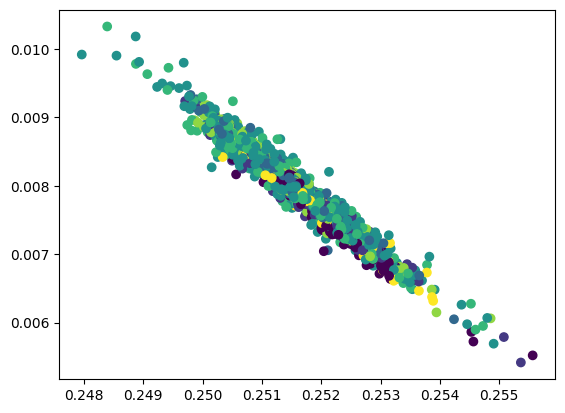

In [ ]:
embeddings = model4(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Model 5 embeddings | Karim Yasser

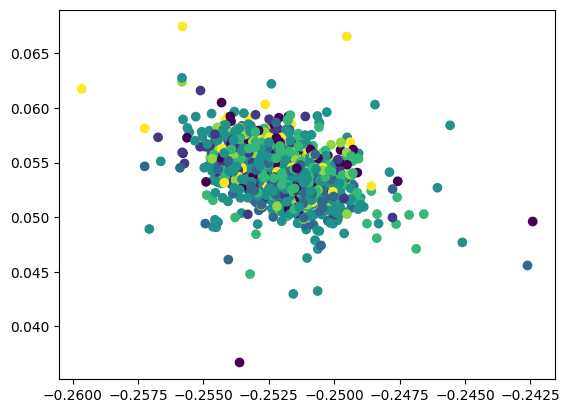

In [ ]:
embeddings = model5(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Model 6 embeddings | Abdelrahman Gamal

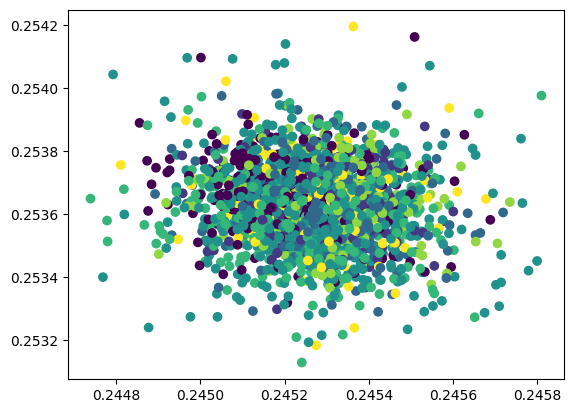

In [ ]:
embeddings = model6(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Train and test 'Base model'

Model 4 - Epoch: 010, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5280, Precision: 0.6244, Recall: 0.5280, F1: 0.5455
Node Embeddings (Epoch 10):
[[-15.716657    7.9013867]
 [  6.922471   13.614932 ]
 [  3.7277162  13.243237 ]
 ...
 [  4.401635    4.432466 ]
 [ -9.650286    6.0442333]
 [-10.880709    9.103771 ]]


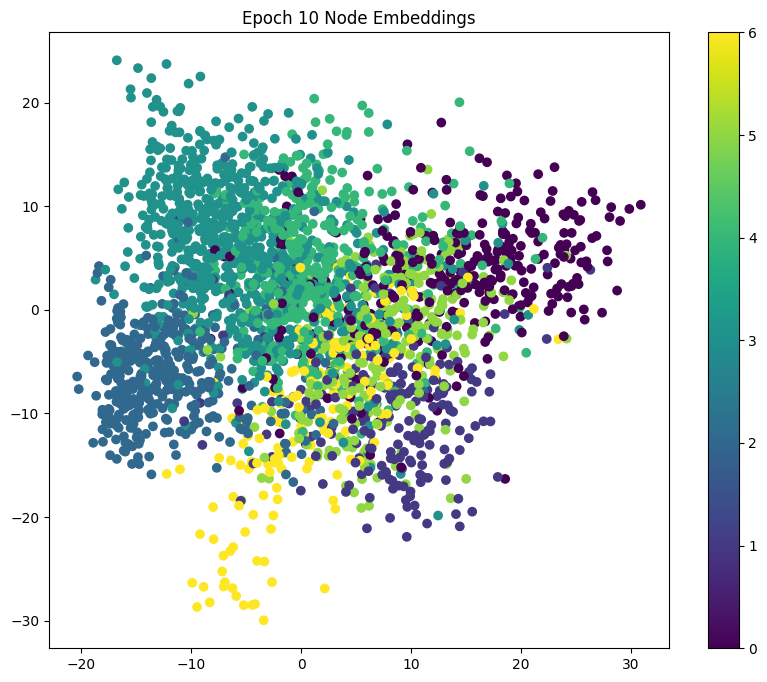

Model 4 - Epoch: 020, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5290, Precision: 0.6239, Recall: 0.5290, F1: 0.5461
Node Embeddings (Epoch 20):
[[-15.712122    7.9362965]
 [  6.939213   13.618894 ]
 [  3.749685   13.26412  ]
 ...
 [  4.417938    4.423664 ]
 [ -9.648614    6.0719604]
 [-10.87194     9.140889 ]]


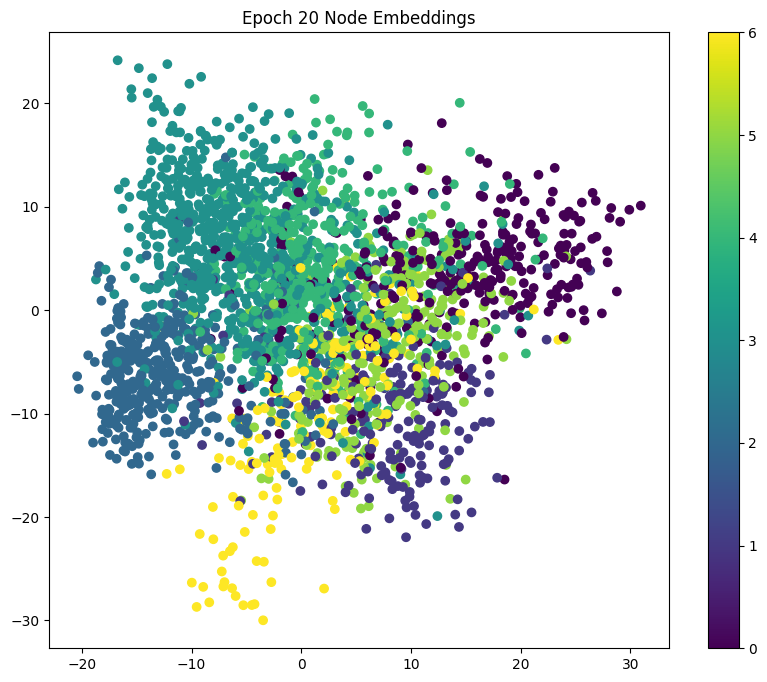

Model 4 - Epoch: 030, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5280, Precision: 0.6224, Recall: 0.5280, F1: 0.5450
Node Embeddings (Epoch 30):
[[-15.708019    7.969949 ]
 [  6.955071   13.622941 ]
 [  3.7705855  13.284803 ]
 ...
 [  4.4337716   4.4153194]
 [ -9.647368    6.0987105]
 [-10.863876    9.176683 ]]


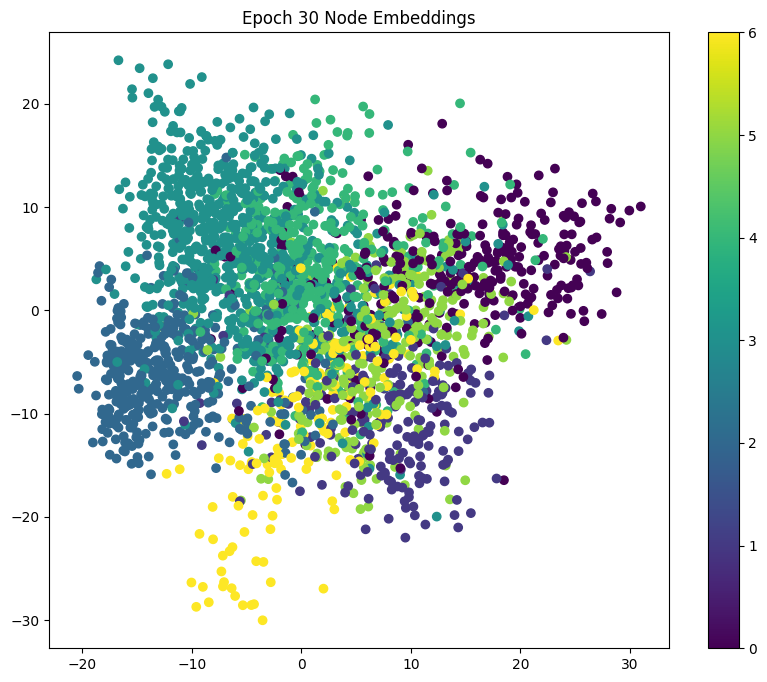

Model 4 - Epoch: 040, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5280, Precision: 0.6224, Recall: 0.5280, F1: 0.5450
Node Embeddings (Epoch 40):
[[-15.704016    8.0028925]
 [  6.9705043  13.626845 ]
 [  3.7909412  13.305084 ]
 ...
 [  4.4493775   4.407181 ]
 [ -9.646278    6.124854 ]
 [-10.856152    9.211559 ]]


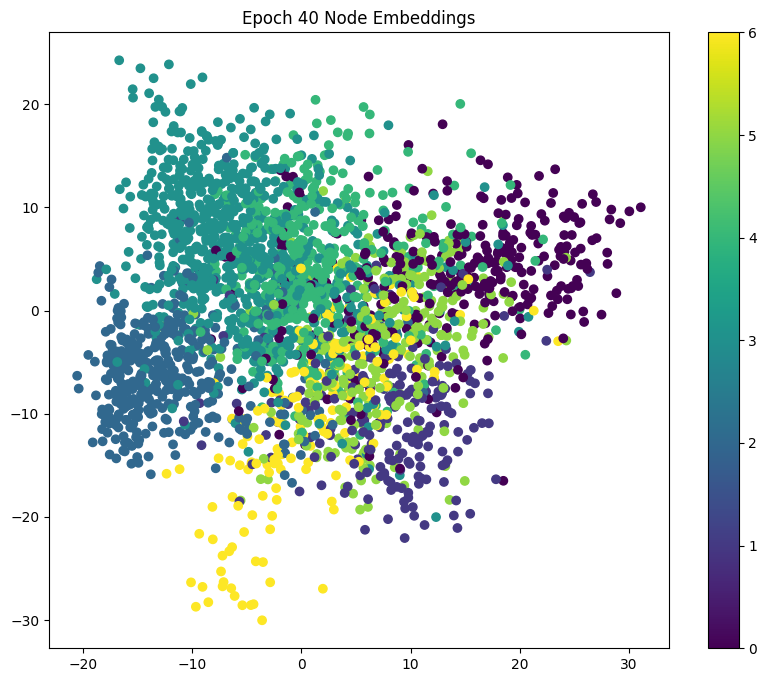

Model 4 - Epoch: 050, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5290, Precision: 0.6230, Recall: 0.5290, F1: 0.5458
Node Embeddings (Epoch 50):
[[-15.700057    8.0353775]
 [  6.985339   13.630018 ]
 [  3.8107495  13.324734 ]
 ...
 [  4.4647455   4.3993545]
 [ -9.645275    6.150543 ]
 [-10.848682    9.245734 ]]


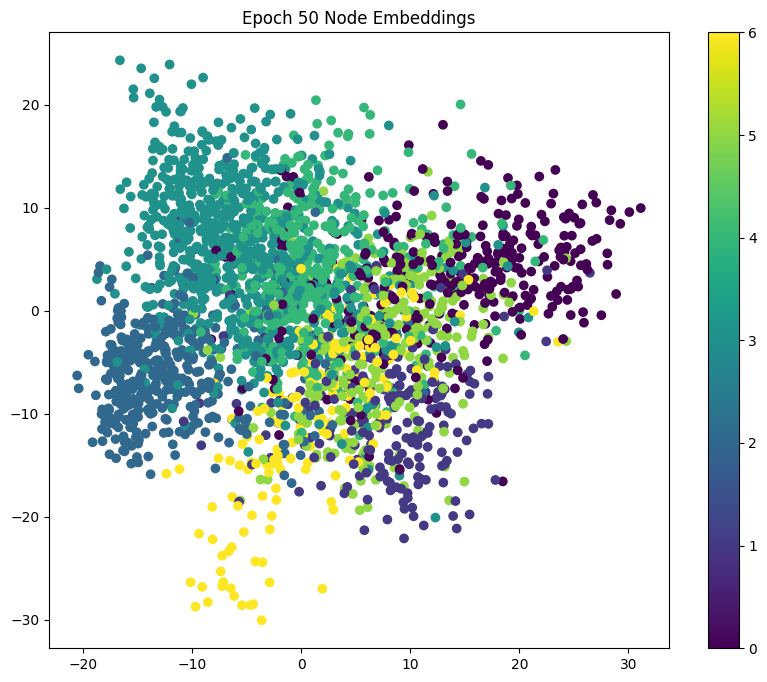

Model 4 - Epoch: 060, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5290, Precision: 0.6230, Recall: 0.5290, F1: 0.5458
Node Embeddings (Epoch 60):
[[-15.696524    8.066681 ]
 [  6.999775   13.631863 ]
 [  3.8298218  13.343334 ]
 ...
 [  4.479748    4.3921423]
 [ -9.6446295   6.1753454]
 [-10.841821    9.27866  ]]


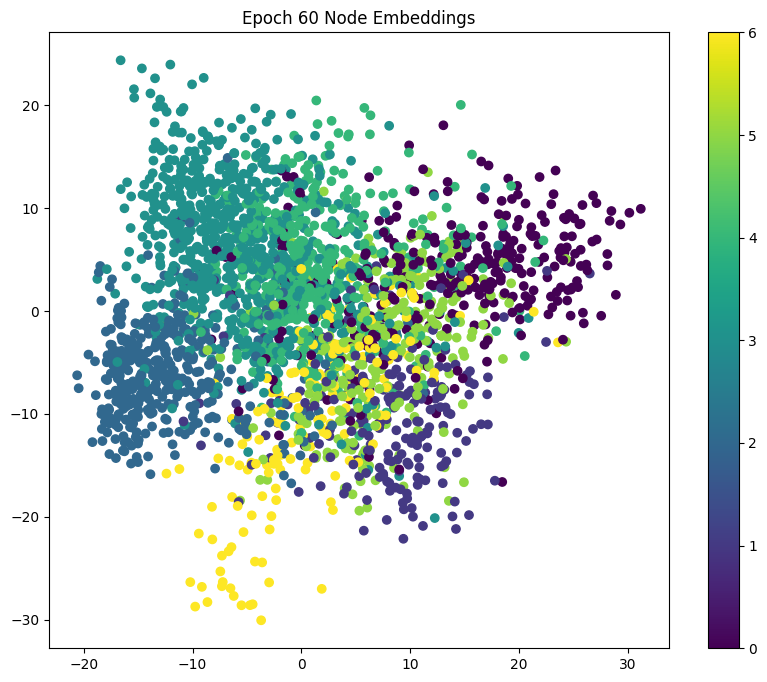

Model 4 - Epoch: 070, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5290, Precision: 0.6230, Recall: 0.5290, F1: 0.5458
Node Embeddings (Epoch 70):
[[-15.693075    8.097458 ]
 [  7.0137944  13.632884 ]
 [  3.8485694  13.361188 ]
 ...
 [  4.494579    4.385187 ]
 [ -9.643978    6.199781 ]
 [-10.835068    9.311059 ]]


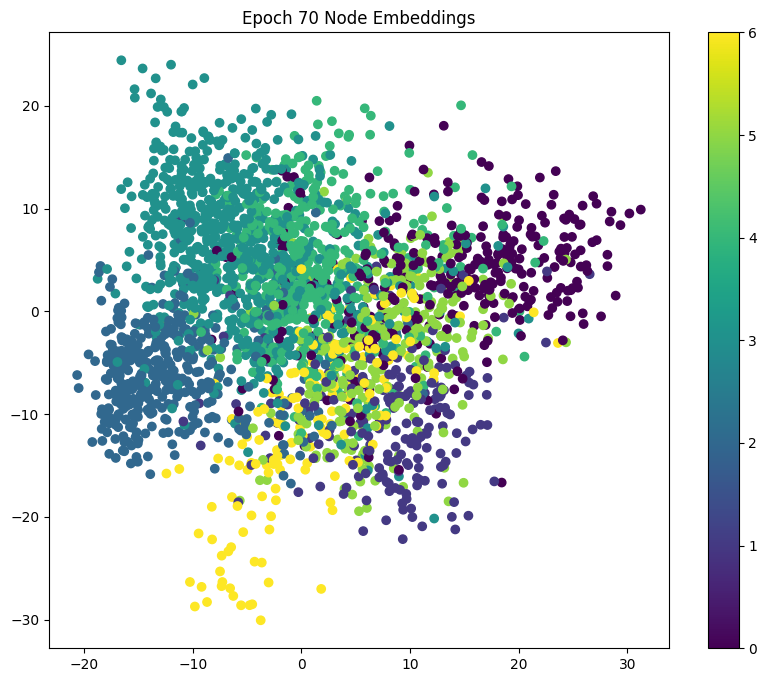

Model 4 - Epoch: 080, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6234, Recall: 0.5300, F1: 0.5468
Node Embeddings (Epoch 80):
[[-15.689608    8.127937 ]
 [  7.027849   13.633738 ]
 [  3.867162   13.378618 ]
 ...
 [  4.5091963   4.3782673]
 [ -9.6433      6.223904 ]
 [-10.82839     9.342974 ]]


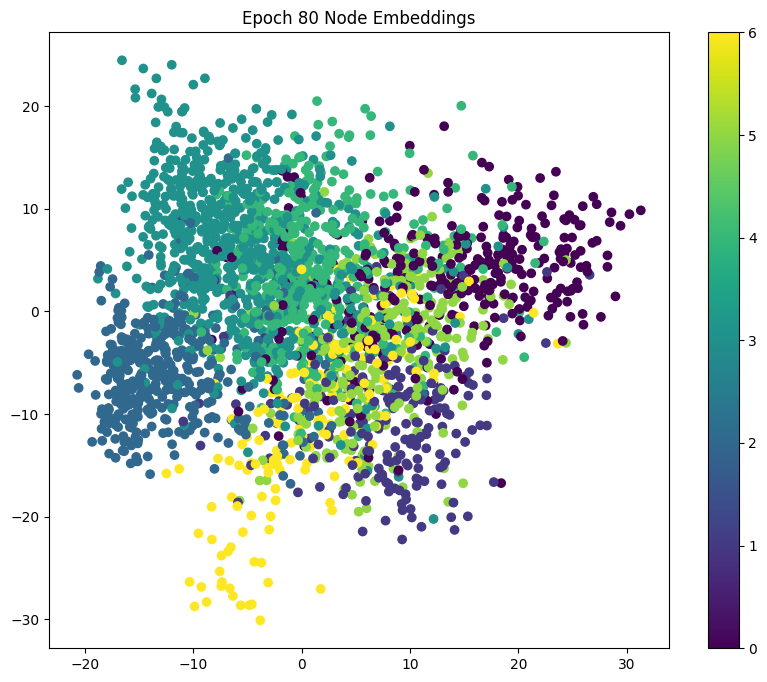

Model 4 - Epoch: 090, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6234, Recall: 0.5300, F1: 0.5468
Node Embeddings (Epoch 90):
[[-15.686128    8.158161 ]
 [  7.041872   13.634369 ]
 [  3.885606   13.395672 ]
 ...
 [  4.5236483   4.3713255]
 [ -9.642595    6.2476993]
 [-10.821758    9.374413 ]]


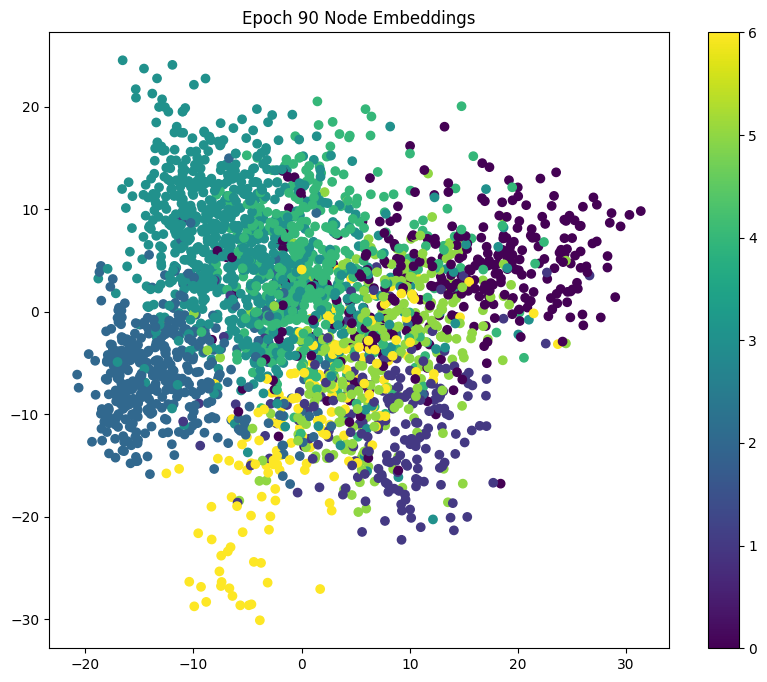

Model 4 - Epoch: 100, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6234, Recall: 0.5300, F1: 0.5468
Node Embeddings (Epoch 100):
[[-15.682495    8.18809  ]
 [  7.0564585  13.634829 ]
 [  3.9041152  13.412511 ]
 ...
 [  4.537972    4.3642726]
 [ -9.641795    6.2711077]
 [-10.815062    9.405388 ]]


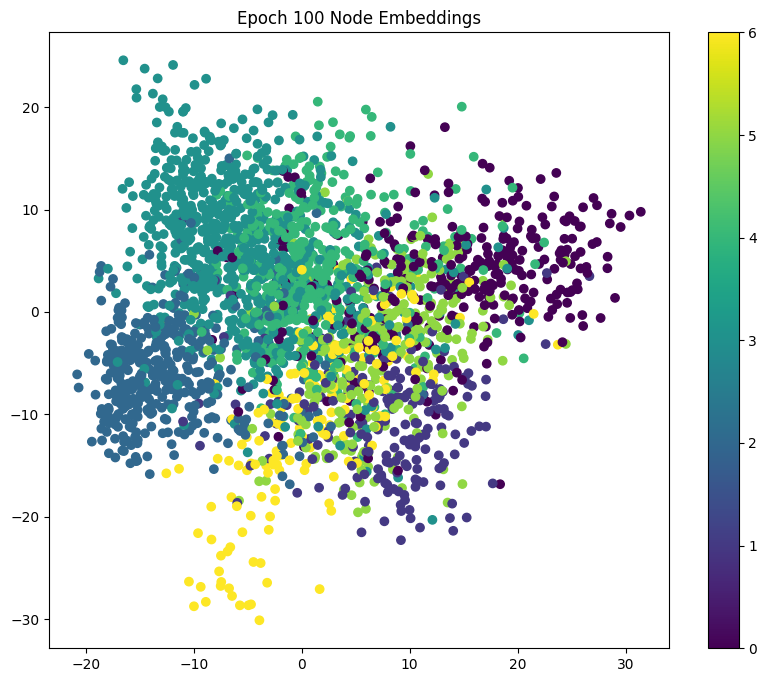

Model 4 - Epoch: 110, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5310, Precision: 0.6241, Recall: 0.5310, F1: 0.5476
Node Embeddings (Epoch 110):
[[-15.678757    8.217669 ]
 [  7.071222   13.635045 ]
 [  3.922449   13.429182 ]
 ...
 [  4.552159    4.356963 ]
 [ -9.640963    6.2940173]
 [-10.808424    9.435664 ]]


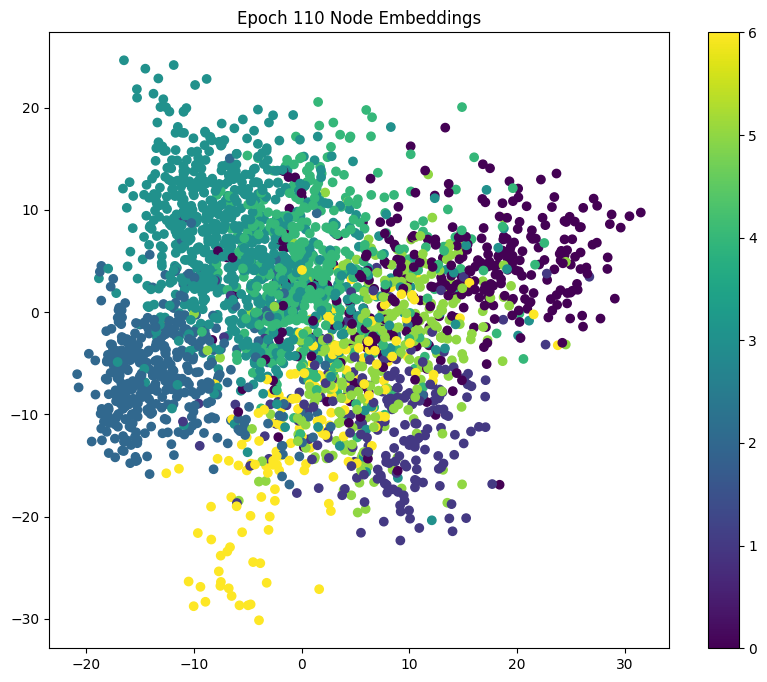

Model 4 - Epoch: 120, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5310, Precision: 0.6241, Recall: 0.5310, F1: 0.5476
Node Embeddings (Epoch 120):
[[-15.675091    8.246592 ]
 [  7.085677   13.635246 ]
 [  3.940264   13.445688 ]
 ...
 [  4.5661077   4.3494787]
 [ -9.640263    6.316247 ]
 [-10.8021      9.465018 ]]


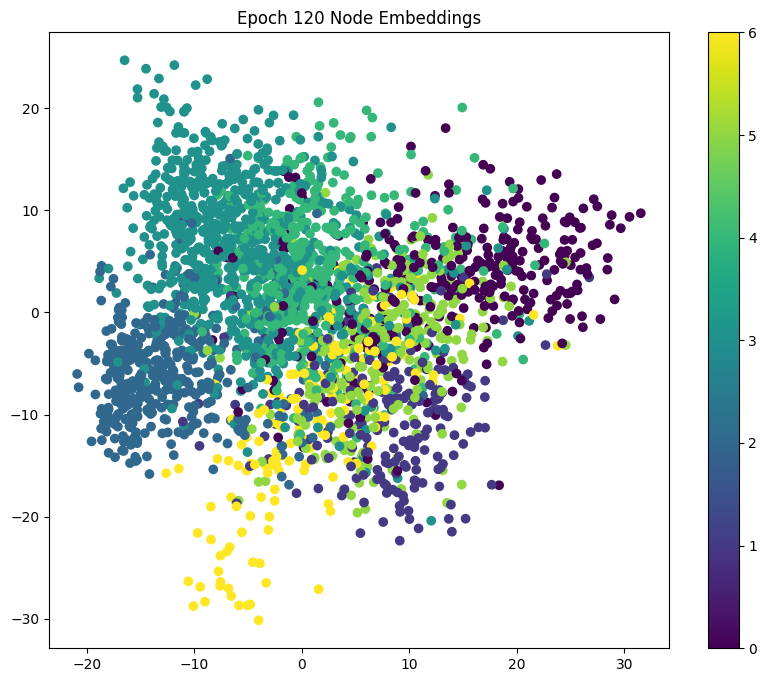

Model 4 - Epoch: 130, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5310, Precision: 0.6241, Recall: 0.5310, F1: 0.5476
Node Embeddings (Epoch 130):
[[-15.671612    8.274214 ]
 [  7.099737   13.635189 ]
 [  3.9571528  13.461673 ]
 ...
 [  4.579706    4.3416243]
 [ -9.639832    6.3371587]
 [-10.796286    9.492779 ]]


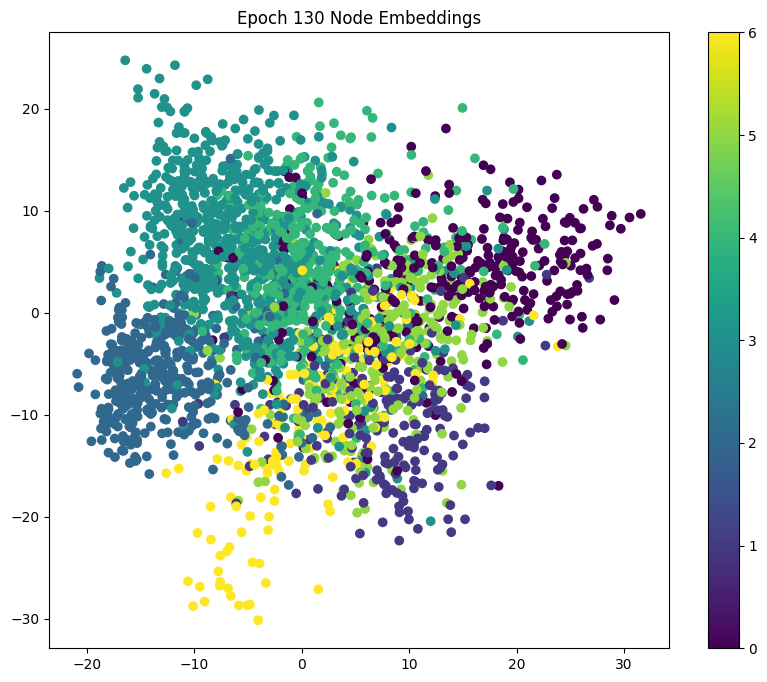

Model 4 - Epoch: 140, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6235, Recall: 0.5300, F1: 0.5470
Node Embeddings (Epoch 140):
[[-15.668528    8.30022  ]
 [  7.113083   13.635056 ]
 [  3.9727862  13.477165 ]
 ...
 [  4.5927277   4.333454 ]
 [ -9.639934    6.356519 ]
 [-10.791301    9.51865  ]]


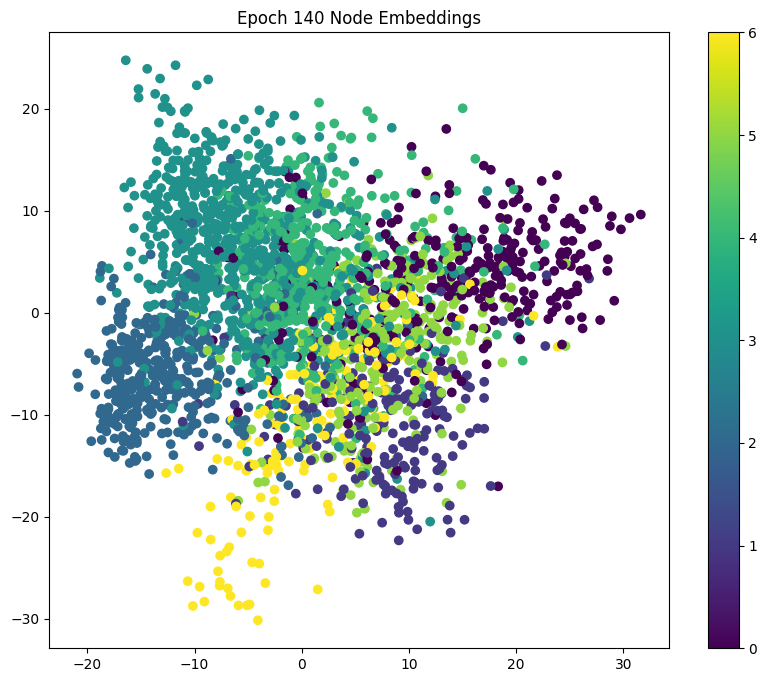

Model 4 - Epoch: 150, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6235, Recall: 0.5300, F1: 0.5470
Node Embeddings (Epoch 150):
[[-15.665651    8.324697 ]
 [  7.12598    13.634468 ]
 [  3.9875813  13.49179  ]
 ...
 [  4.6051536   4.3245792]
 [ -9.640373    6.374202 ]
 [-10.786842    9.542502 ]]


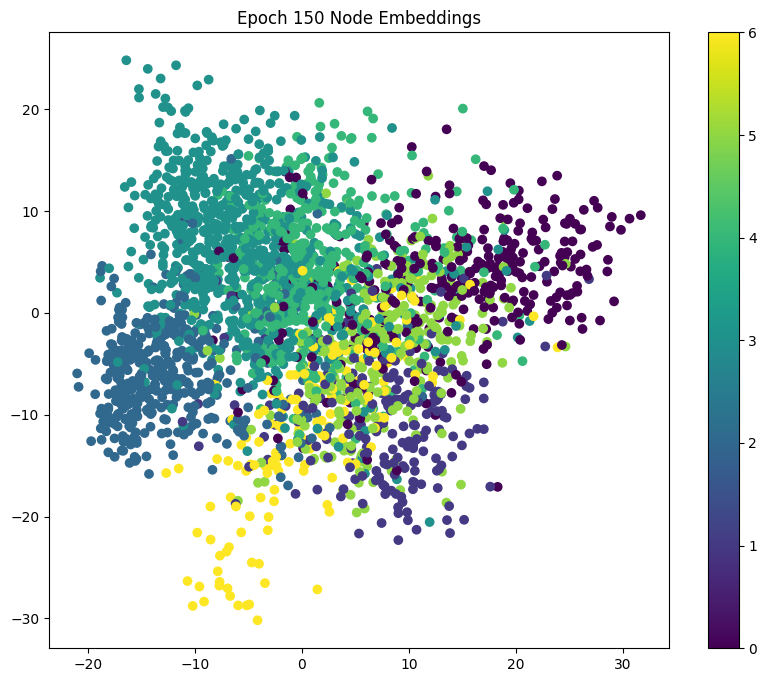

Model 4 - Epoch: 160, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6231, Recall: 0.5300, F1: 0.5469
Node Embeddings (Epoch 160):
[[-15.663374    8.347174 ]
 [  7.137801   13.633265 ]
 [  4.000952   13.505545 ]
 ...
 [  4.616871    4.31498  ]
 [ -9.641573    6.3903093]
 [-10.783584    9.564456 ]]


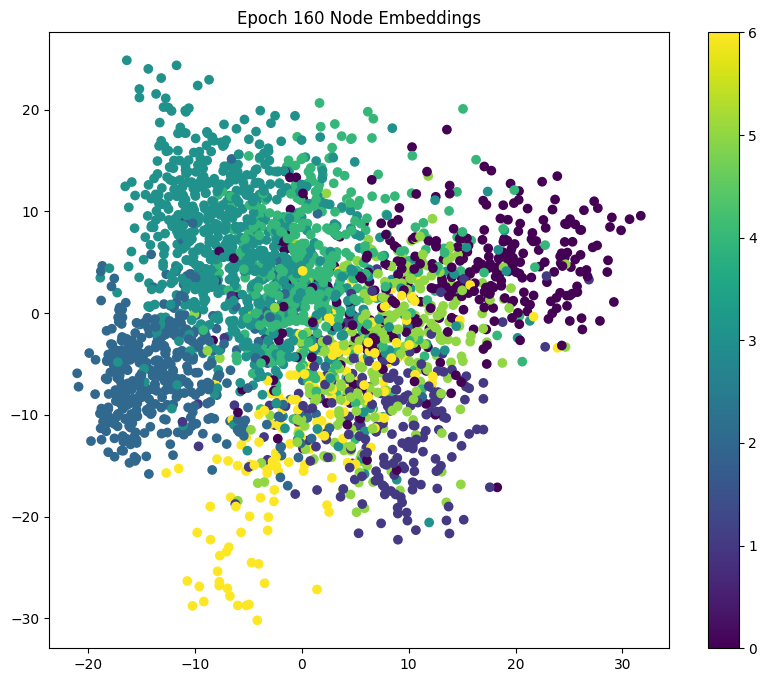

Model 4 - Epoch: 170, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6231, Recall: 0.5300, F1: 0.5469
Node Embeddings (Epoch 170):
[[-15.66147     8.36812  ]
 [  7.1491594  13.630744 ]
 [  4.0136585  13.517946 ]
 ...
 [  4.627964    4.3040996]
 [ -9.643148    6.4051013]
 [-10.780932    9.584865 ]]


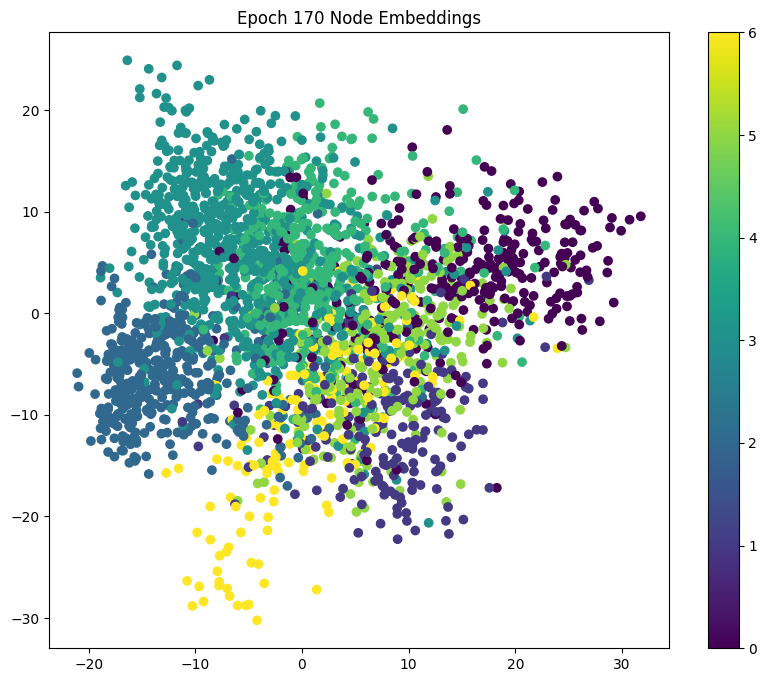

Model 4 - Epoch: 180, Loss: 0.0000, Train: 1.0000, Val: 0.5160, Test: 0.5310, Precision: 0.6236, Recall: 0.5310, F1: 0.5479
Node Embeddings (Epoch 180):
[[-15.658962    8.388754 ]
 [  7.162096   13.625465 ]
 [  4.0279503  13.528013 ]
 ...
 [  4.6346188   4.2995777]
 [ -9.643822    6.4189634]
 [-10.77695     9.604282 ]]


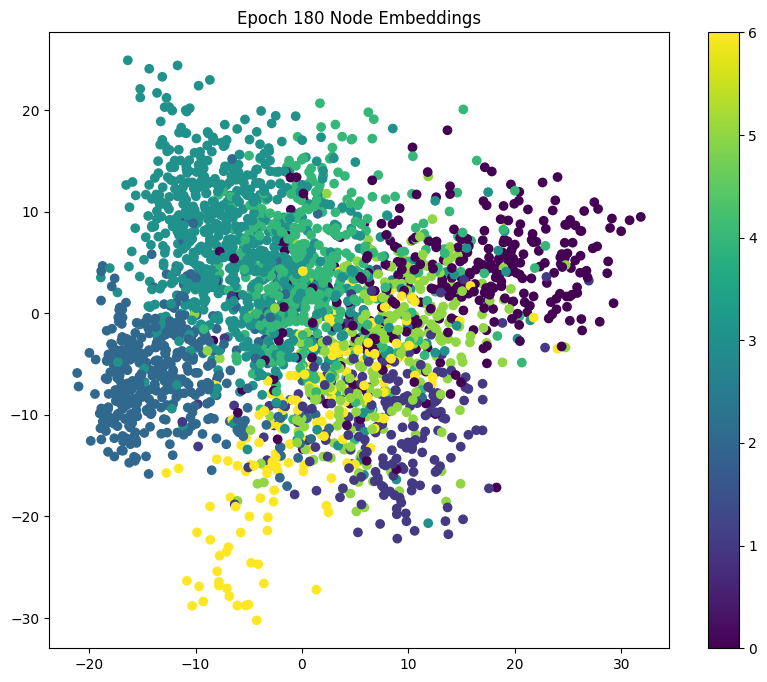

Model 4 - Epoch: 190, Loss: 0.0000, Train: 1.0000, Val: 0.5160, Test: 0.5330, Precision: 0.6251, Recall: 0.5330, F1: 0.5491
Node Embeddings (Epoch 190):
[[-15.654652    8.410479 ]
 [  7.178988   13.615117 ]
 [  4.045965   13.535344 ]
 ...
 [  4.6373353   4.299822 ]
 [ -9.640898    6.4395604]
 [-10.769526    9.624512 ]]


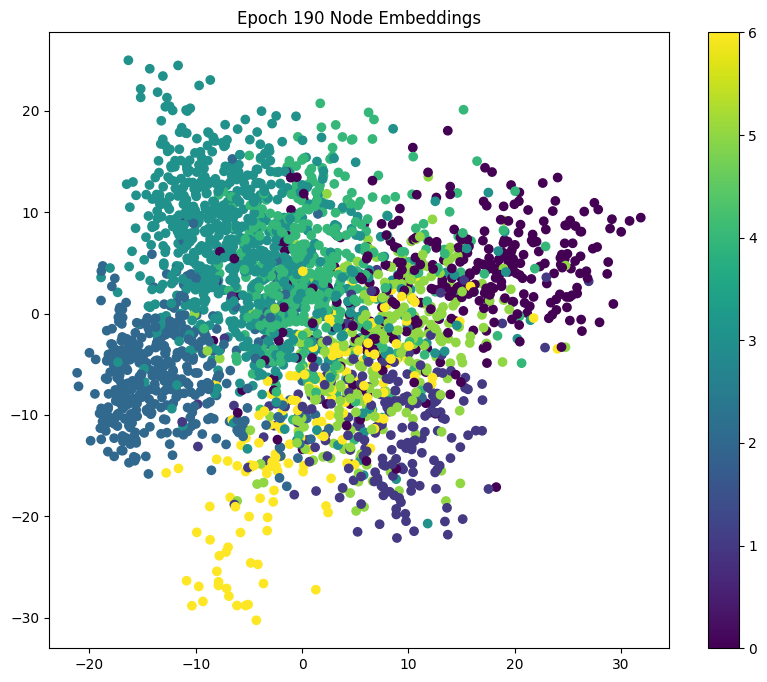

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Train and test 'Fourth' model - Base model with 8 hidden units and ReLU activation
writer4 = SummaryWriter('runs/model4')

epochs4 = []
train_losses4 = []
train_accuracies4 = []
val_accuracies4 = []
test_accuracies4 = []
precisions4 = []
recalls4 = []
f1_scores4 = []

num_epochs = 200
for epoch in range(1, num_epochs):

    loss4 = train(data, data.train_mask, model4, optimizer4, criterion4)
    train_acc4 = test(data, data.train_mask, model4)
    val_acc4 = test(data, data.val_mask, model4)
    test_acc4 = test(data, data.test_mask, model4)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model4(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs4.append(epoch)
        train_losses4.append(loss4.detach().item())
        train_accuracies4.append(train_acc4)
        val_accuracies4.append(val_acc4)
        test_accuracies4.append(test_acc4)
        precisions4.append(precision)
        recalls4.append(recall)
        f1_scores4.append(f1)

        print(f'Model 4 - Epoch: {epoch:03d}, Loss: {loss4:.4f}, Train: {train_acc4:.4f}, Val: {val_acc4:.4f}, Test: {test_acc4:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        # Node embeddings
        node_embeddings = model4(data.x, data.edge_index)

        # Reducing dimensions using PCA for visualization
        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        # Printing the node embeddings for the current epoch
        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # Visualizing the node embeddings
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer4.add_scalar('Loss/Train', loss4, epoch)
    writer4.add_scalar('Accuracy/Train', train_acc4, epoch)
    writer4.add_scalar('Accuracy/Validation', val_acc4, epoch)
    writer4.add_scalar('Accuracy/Test', test_acc4, epoch)
    writer4.add_scalar('Precision/Test', precision, epoch)
    writer4.add_scalar('Recall/Test', recall, epoch)
    writer4.add_scalar('F1-Score/Test', f1, epoch)

writer4.close()


# Metrices Documention model 4

In [ ]:
# Saving metrics to a DataFrame
metrics4 = pd.DataFrame({
    "Epoch": epochs4,
    "Train Loss": train_losses4,
    "Train Accuracy": train_accuracies4,
    "Validation Accuracy": val_accuracies4,
    "Test Accuracy": test_accuracies4,
})

metrics4.to_csv('model4_metrics.csv', index=False)

print("Metrics for Model 4 saved to 'model4_metrics.csv'")

files.download('model4_metrics.csv')

Metrics for Model 4 saved to 'model4_metrics.csv'


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Learning Curve for Base Model

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs4, y=train_losses4, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs4, y=train_accuracies4, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs4, y=val_accuracies4, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs4, y=test_accuracies4, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Default Model | Abdelrahman Gamal and Karim Yasser',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# Train and test 'Fifth' model after tuning - Karim Yasser

Model 5 - Epoch: 010, Loss: 0.0018, Train: 1.0000, Val: 0.6600, Test: 0.6490, Precision: 0.6432, Recall: 0.6490, F1: 0.6415
Node Embeddings (Epoch 10):
[[-4.8743067   3.010159  ]
 [-3.113881   -3.1648338 ]
 [-2.3509953  -2.3672109 ]
 ...
 [-0.89464366 -6.1692276 ]
 [-2.5163245  -1.2418182 ]
 [-2.7436602   0.9267923 ]]


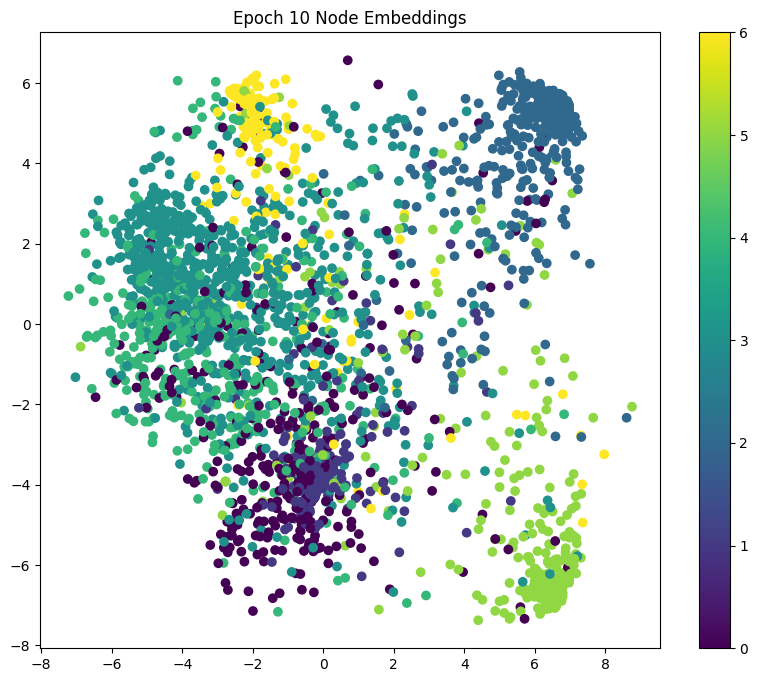

Model 5 - Epoch: 020, Loss: 0.0017, Train: 1.0000, Val: 0.6560, Test: 0.6510, Precision: 0.6455, Recall: 0.6510, F1: 0.6437
Node Embeddings (Epoch 20):
[[-4.869216    3.0558877 ]
 [-3.1795337  -3.1213093 ]
 [-2.3980787  -2.3371177 ]
 ...
 [-1.0297024  -6.179367  ]
 [-2.5775206  -1.2146271 ]
 [-2.7738516   0.94255865]]


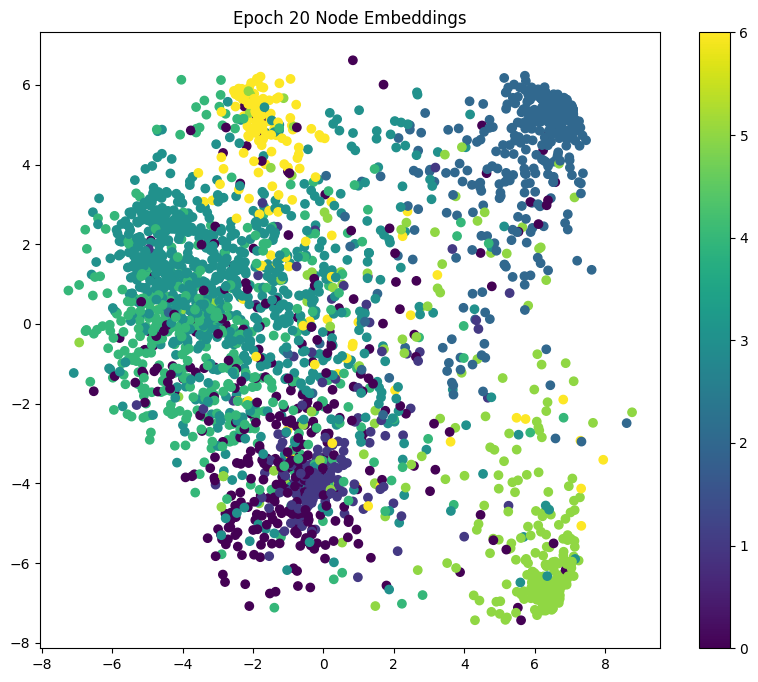

Model 5 - Epoch: 030, Loss: 0.0016, Train: 1.0000, Val: 0.6560, Test: 0.6510, Precision: 0.6452, Recall: 0.6510, F1: 0.6434
Node Embeddings (Epoch 30):
[[-4.8670764  3.0938497]
 [-3.240388  -3.0801058]
 [-2.441711  -2.3076255]
 ...
 [-1.154834  -6.1845837]
 [-2.6339145 -1.1868244]
 [-2.8030117  0.9565555]]


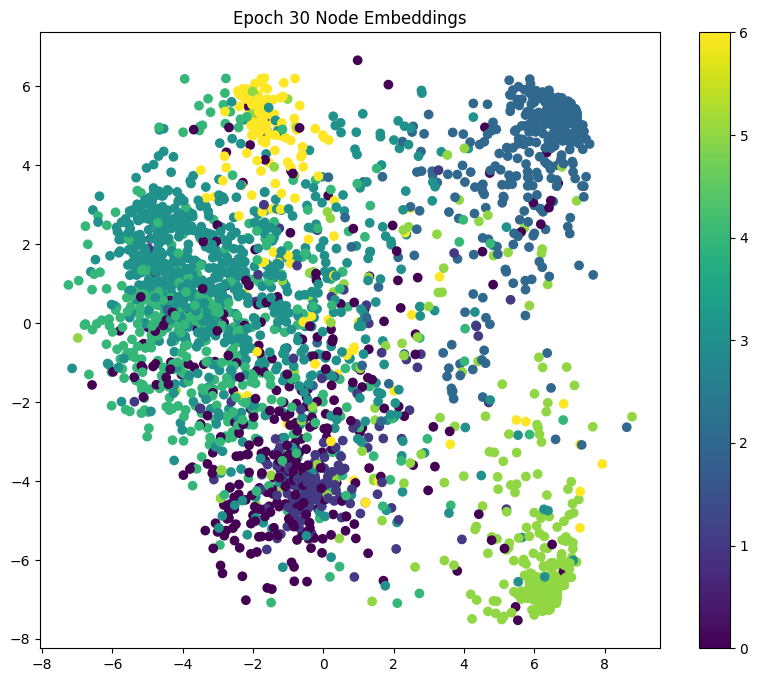

Model 5 - Epoch: 040, Loss: 0.0015, Train: 1.0000, Val: 0.6580, Test: 0.6520, Precision: 0.6459, Recall: 0.6520, F1: 0.6442
Node Embeddings (Epoch 40):
[[-4.867585   3.1254644]
 [-3.2970557 -3.0411503]
 [-2.482359  -2.2788162]
 ...
 [-1.2706271 -6.18556  ]
 [-2.6860287 -1.1585461]
 [-2.8311932  0.9691349]]


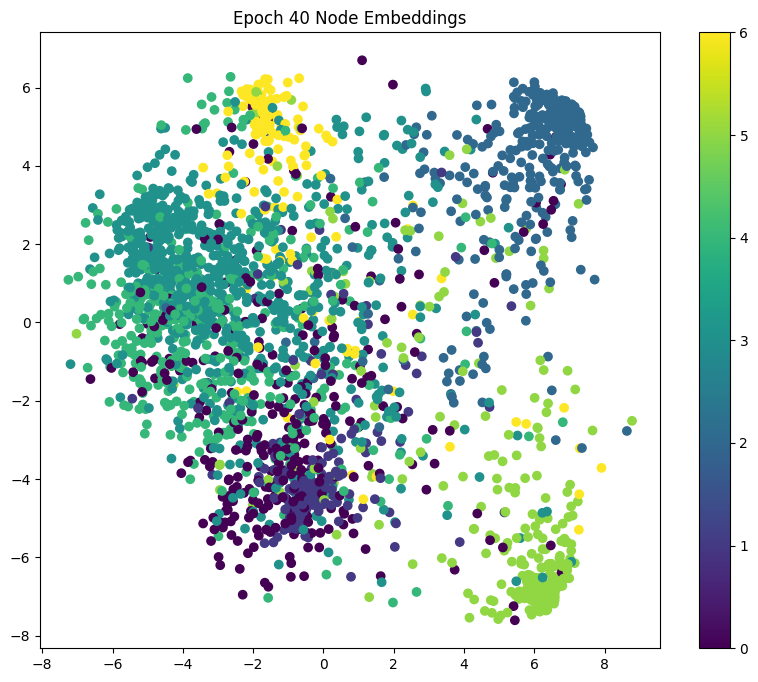

Model 5 - Epoch: 050, Loss: 0.0014, Train: 1.0000, Val: 0.6600, Test: 0.6530, Precision: 0.6468, Recall: 0.6530, F1: 0.6454
Node Embeddings (Epoch 50):
[[-4.8703547   3.1519969 ]
 [-3.350068   -3.004311  ]
 [-2.5204425  -2.2507262 ]
 ...
 [-1.3778046  -6.1829243 ]
 [-2.7343578  -1.1299067 ]
 [-2.858457    0.98060143]]


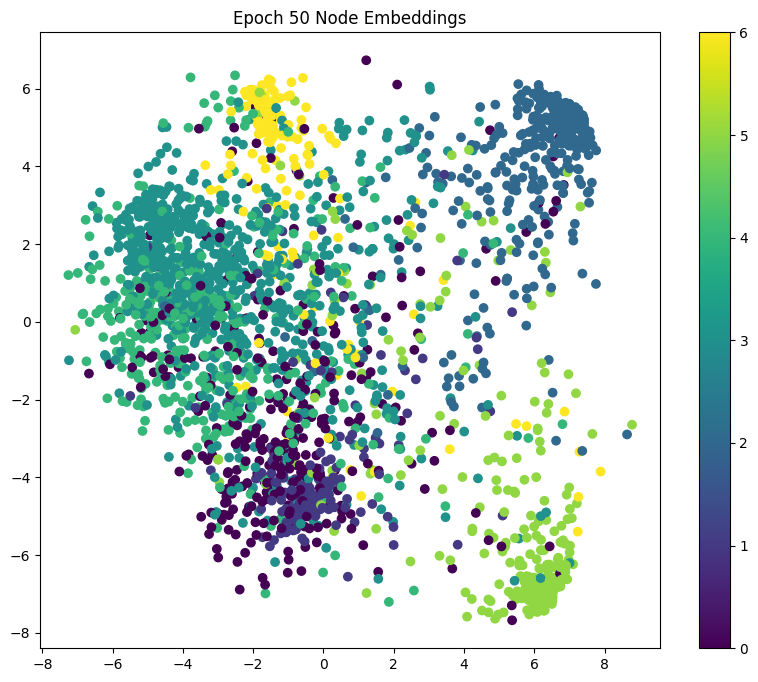

Model 5 - Epoch: 060, Loss: 0.0013, Train: 1.0000, Val: 0.6560, Test: 0.6500, Precision: 0.6426, Recall: 0.6500, F1: 0.6417
Node Embeddings (Epoch 60):
[[-4.874953    3.17457   ]
 [-3.3998823  -2.9694161 ]
 [-2.556324   -2.2233567 ]
 ...
 [-1.4771599  -6.177227  ]
 [-2.7793517  -1.1009889 ]
 [-2.8848557   0.99123096]]


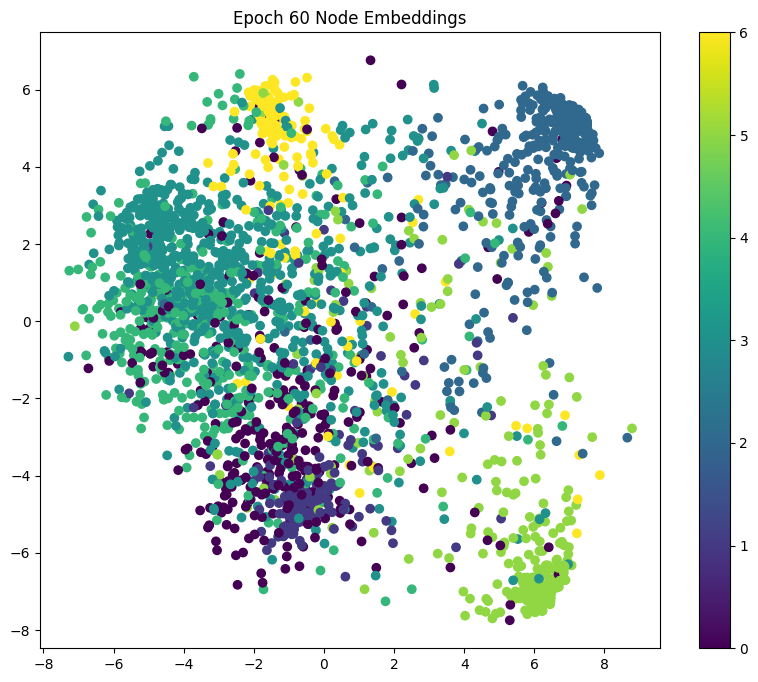

Model 5 - Epoch: 070, Loss: 0.0012, Train: 1.0000, Val: 0.6580, Test: 0.6510, Precision: 0.6430, Recall: 0.6510, F1: 0.6425
Node Embeddings (Epoch 70):
[[-4.880918   3.1941495]
 [-3.446907  -2.9362588]
 [-2.5903325 -2.1966696]
 ...
 [-1.5695336 -6.168951 ]
 [-2.821414  -1.0718496]
 [-2.9104257  1.0012687]]


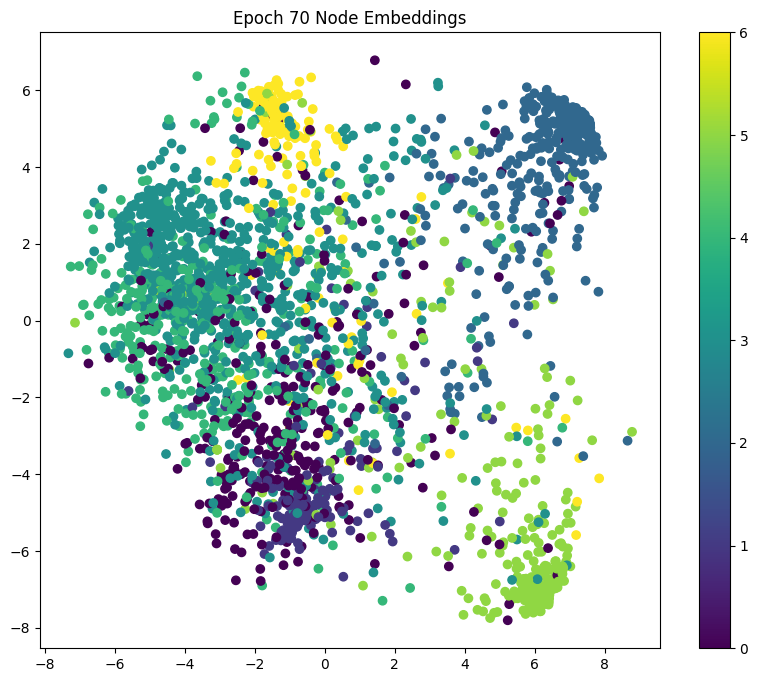

Model 5 - Epoch: 080, Loss: 0.0011, Train: 1.0000, Val: 0.6560, Test: 0.6500, Precision: 0.6415, Recall: 0.6500, F1: 0.6411
Node Embeddings (Epoch 80):
[[-4.887834   3.2115417]
 [-3.491479  -2.9046445]
 [-2.6227307 -2.1706276]
 ...
 [-1.6557155 -6.1585164]
 [-2.8608909 -1.0425313]
 [-2.9352038  1.0109303]]


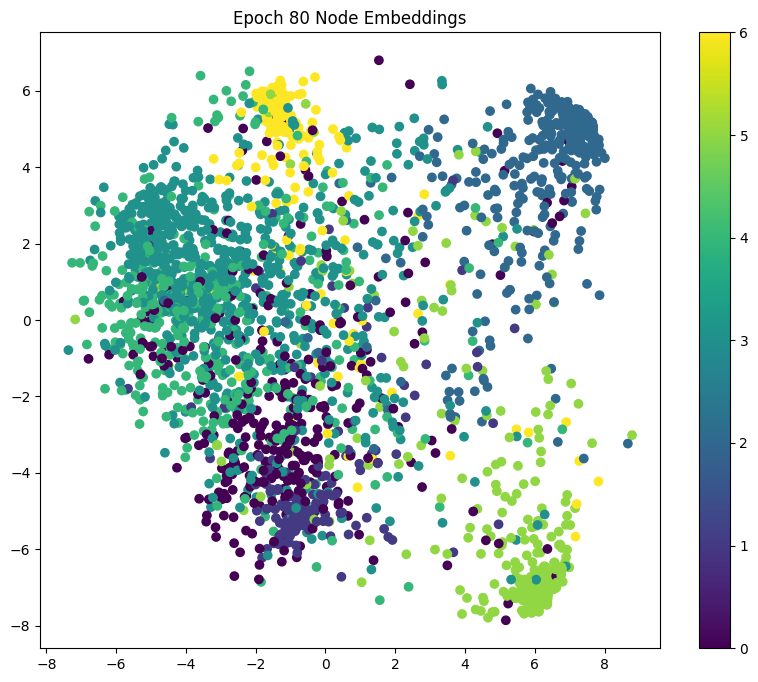

Model 5 - Epoch: 090, Loss: 0.0011, Train: 1.0000, Val: 0.6540, Test: 0.6500, Precision: 0.6415, Recall: 0.6500, F1: 0.6411
Node Embeddings (Epoch 90):
[[-4.89532    3.227398 ]
 [-3.5338874 -2.8743753]
 [-2.653741  -2.145175 ]
 ...
 [-1.7364428 -6.1462774]
 [-2.8980806 -1.013063 ]
 [-2.9592116  1.020402 ]]


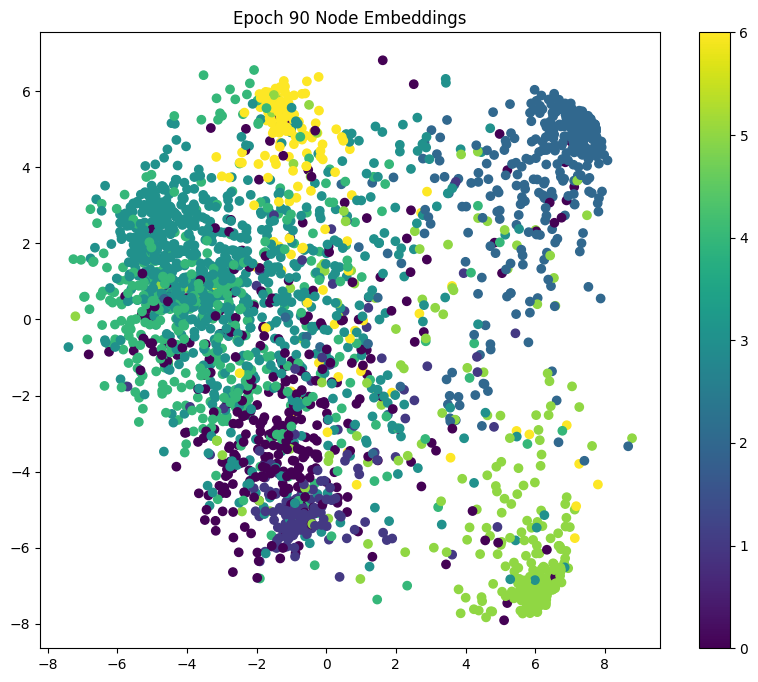

Model 5 - Epoch: 100, Loss: 0.0010, Train: 1.0000, Val: 0.6540, Test: 0.6510, Precision: 0.6423, Recall: 0.6510, F1: 0.6420
Node Embeddings (Epoch 100):
[[-4.903075   3.2422218]
 [-3.5743616 -2.8452902]
 [-2.683534  -2.1202714]
 ...
 [-1.8123531 -6.1325455]
 [-2.9332342 -0.9834734]
 [-2.982481   1.0298339]]


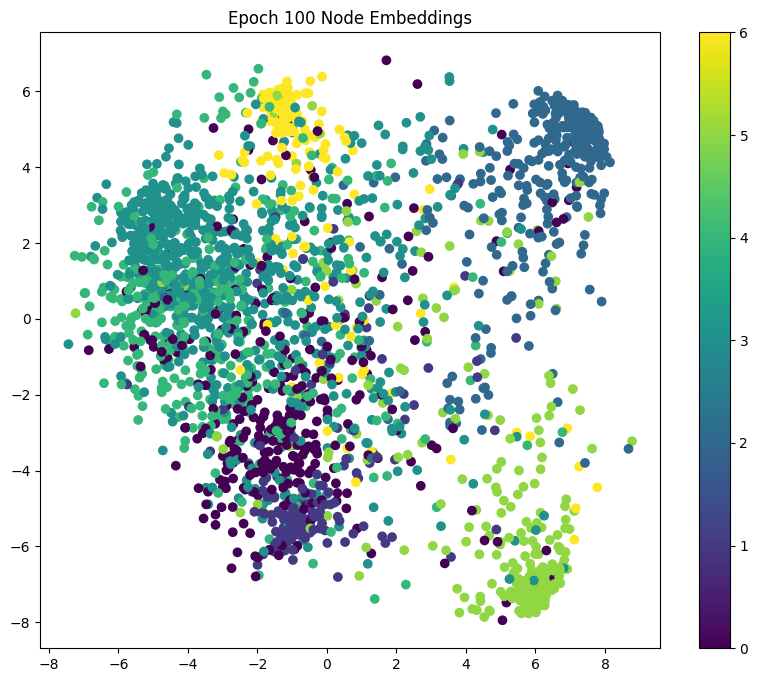

Model 5 - Epoch: 110, Loss: 0.0010, Train: 1.0000, Val: 0.6560, Test: 0.6520, Precision: 0.6431, Recall: 0.6520, F1: 0.6429
Node Embeddings (Epoch 110):
[[-4.9108562  3.2563975]
 [-3.6131005 -2.8172493]
 [-2.7122517 -2.0958788]
 ...
 [-1.8840094 -6.1175866]
 [-2.9665627 -0.9537911]
 [-3.0050325  1.0393467]]


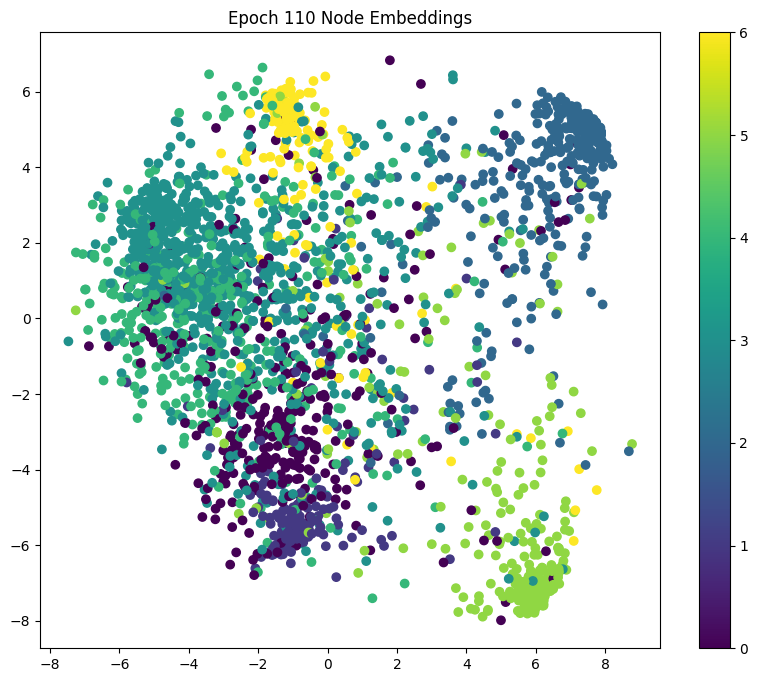

Model 5 - Epoch: 120, Loss: 0.0009, Train: 1.0000, Val: 0.6560, Test: 0.6520, Precision: 0.6431, Recall: 0.6520, F1: 0.6429
Node Embeddings (Epoch 120):
[[-4.918495   3.2701952]
 [-3.6502578 -2.7901452]
 [-2.7400005 -2.0719743]
 ...
 [-1.9518743 -6.101637 ]
 [-2.998246  -0.9240494]
 [-3.0268993  1.0490253]]


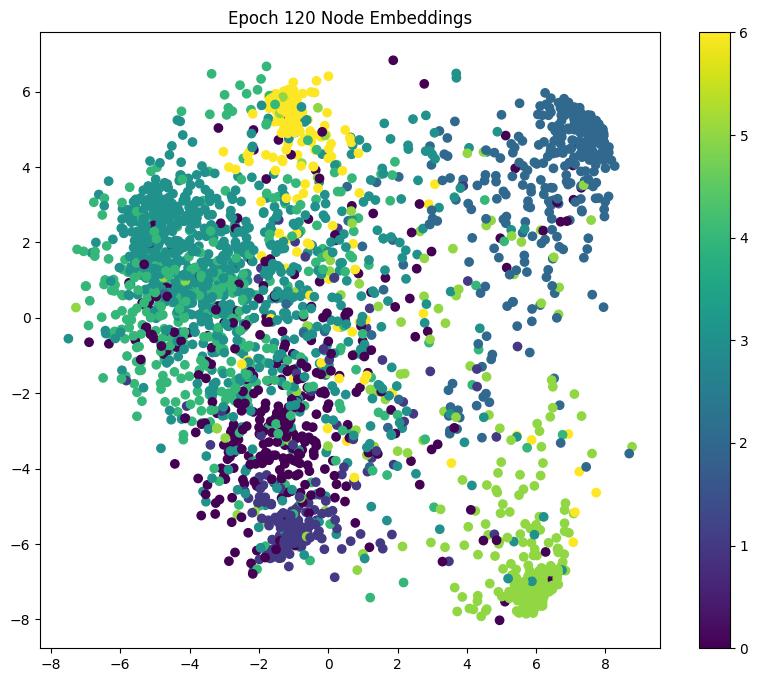

Model 5 - Epoch: 130, Loss: 0.0009, Train: 1.0000, Val: 0.6560, Test: 0.6530, Precision: 0.6440, Recall: 0.6530, F1: 0.6437
Node Embeddings (Epoch 130):
[[-4.9258785 -3.283794 ]
 [-3.6859612  2.7638986]
 [-2.7668626  2.0485451]
 ...
 [-2.016333   6.0849032]
 [-3.028432   0.8942925]
 [-3.048111  -1.0589243]]


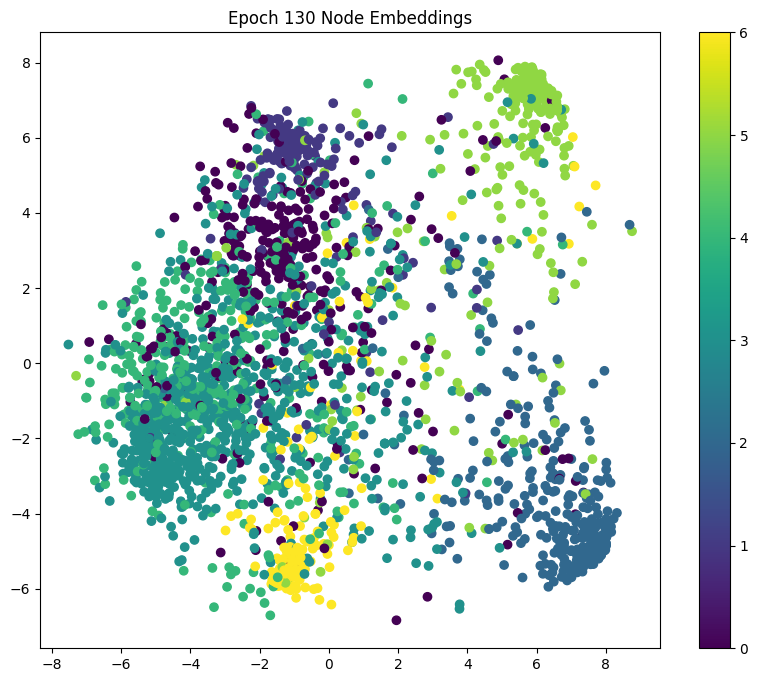

Model 5 - Epoch: 140, Loss: 0.0008, Train: 1.0000, Val: 0.6560, Test: 0.6530, Precision: 0.6440, Recall: 0.6530, F1: 0.6437
Node Embeddings (Epoch 140):
[[-4.9329348 -3.2973251]
 [-3.7203207  2.7384398]
 [-2.792911   2.025579 ]
 ...
 [-2.0777192  6.0675616]
 [-3.0572543  0.8645567]
 [-3.0687003 -1.0690833]]


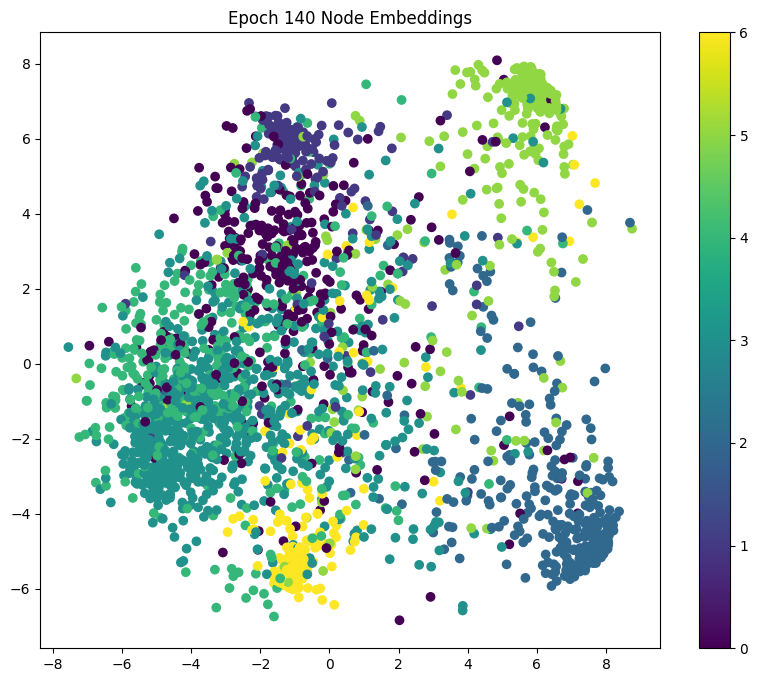

Model 5 - Epoch: 150, Loss: 0.0008, Train: 1.0000, Val: 0.6560, Test: 0.6540, Precision: 0.6455, Recall: 0.6540, F1: 0.6449
Node Embeddings (Epoch 150):
[[-4.9396353 -3.3108578]
 [-3.753426   2.7137232]
 [-2.8181982  2.003073 ]
 ...
 [-2.136301   6.0497704]
 [-3.084825   0.8348894]
 [-3.0887015 -1.079516 ]]


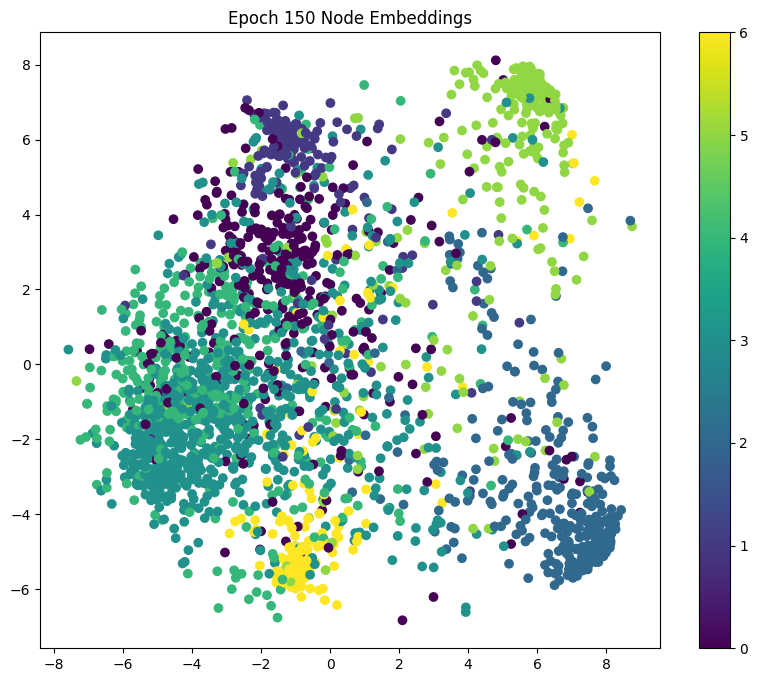

Model 5 - Epoch: 160, Loss: 0.0008, Train: 1.0000, Val: 0.6560, Test: 0.6540, Precision: 0.6453, Recall: 0.6540, F1: 0.6448
Node Embeddings (Epoch 160):
[[-4.9459662 -3.3244426]
 [-3.7853575  2.6897068]
 [-2.8427706  1.9810252]
 ...
 [-2.1923194  6.031664 ]
 [-3.111246   0.8053272]
 [-3.1081467 -1.0902328]]


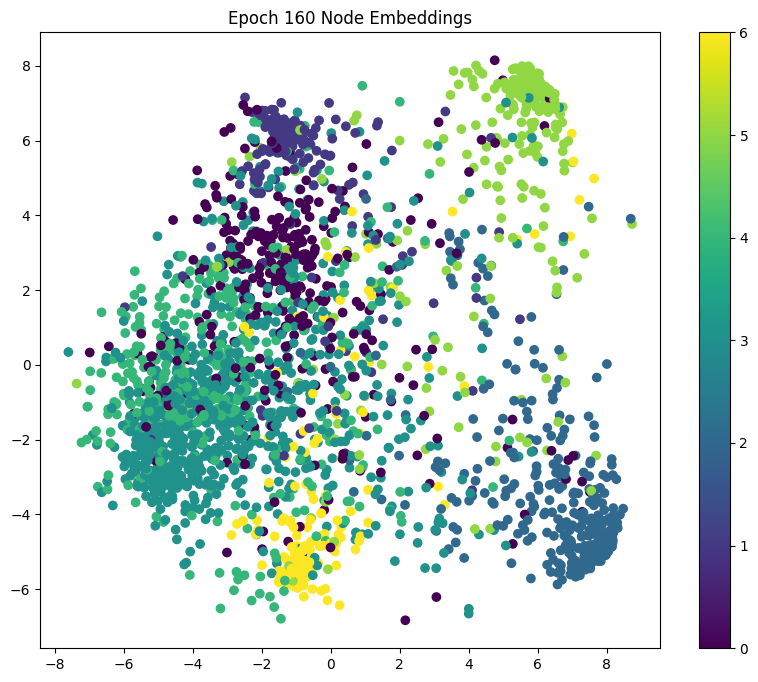

Model 5 - Epoch: 170, Loss: 0.0007, Train: 1.0000, Val: 0.6560, Test: 0.6540, Precision: 0.6451, Recall: 0.6540, F1: 0.6446
Node Embeddings (Epoch 170):
[[-4.9519424  -3.3380883 ]
 [-3.8161821   2.6663632 ]
 [-2.8666677   1.9594369 ]
 ...
 [-2.2459648   6.0133605 ]
 [-3.1366043   0.77591836]
 [-3.127068   -1.1012208 ]]


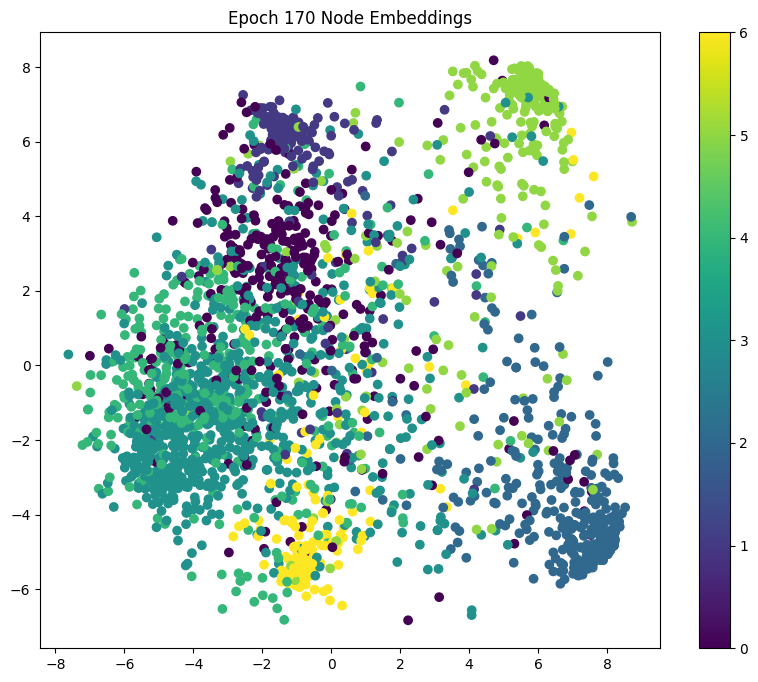

Model 5 - Epoch: 180, Loss: 0.0007, Train: 1.0000, Val: 0.6540, Test: 0.6540, Precision: 0.6451, Recall: 0.6540, F1: 0.6446
Node Embeddings (Epoch 180):
[[-4.957582  -3.3518064]
 [-3.845962   2.6436687]
 [-2.8899238  1.938309 ]
 ...
 [-2.2974138  5.9949627]
 [-3.160979   0.7466963]
 [-3.1454968 -1.112473 ]]


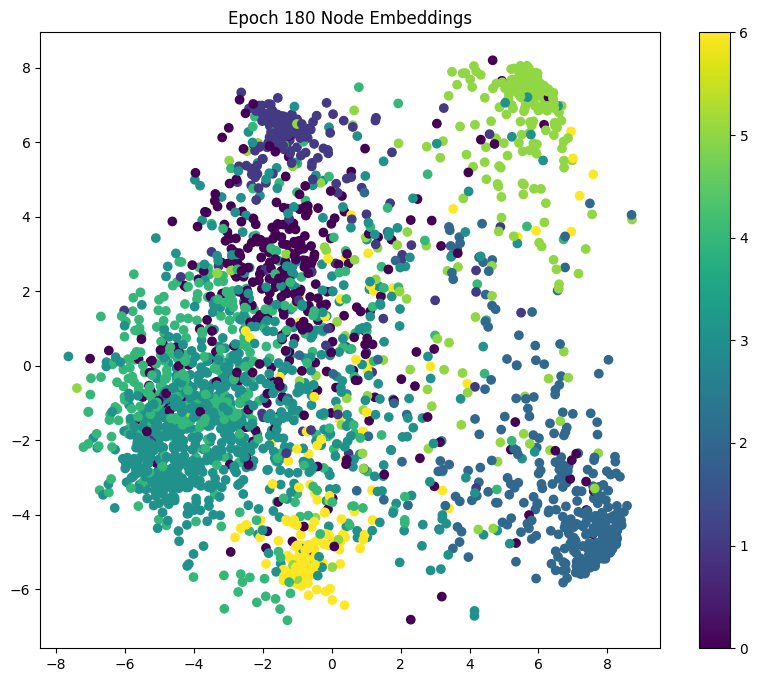

Model 5 - Epoch: 190, Loss: 0.0007, Train: 1.0000, Val: 0.6520, Test: 0.6540, Precision: 0.6450, Recall: 0.6540, F1: 0.6445
Node Embeddings (Epoch 190):
[[-4.9629097  -3.3655858 ]
 [-3.8747542   2.6216006 ]
 [-2.912573    1.917641  ]
 ...
 [-2.3468184   5.976556  ]
 [-3.1844428   0.71769893]
 [-3.1634593  -1.1239699 ]]


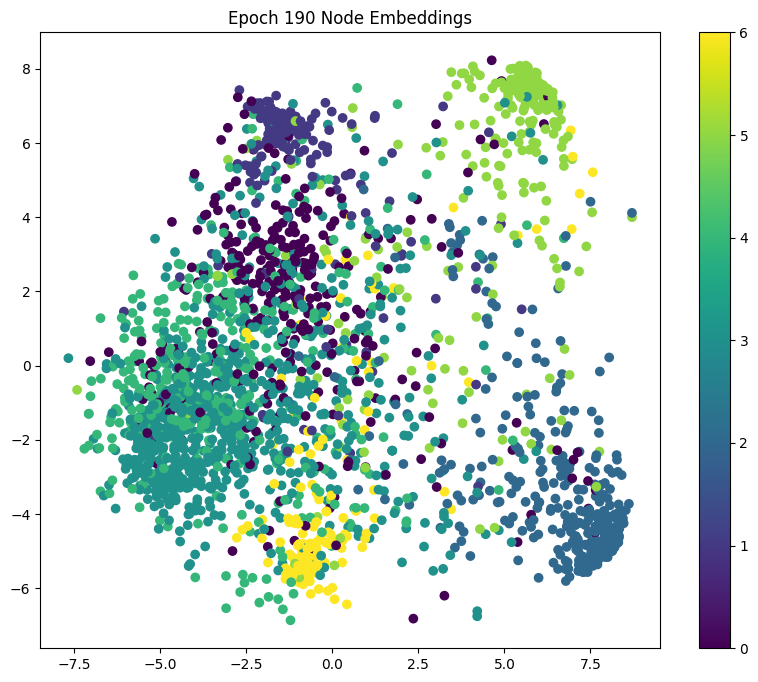

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Train and test 'Fifth' model - Model with 16 hidden units and Tanh activation
writer5 = SummaryWriter('runs/model5')

epochs5 = []
train_losses5 = []
train_accuracies5 = []
val_accuracies5 = []
test_accuracies5 = []
precisions5 = []
recalls5 = []
f1_scores5 = []

num_epochs = 200
for epoch in range(1, num_epochs):

    loss5 = train(data, data.train_mask, model5, optimizer5, criterion5)
    train_acc5 = test(data, data.train_mask, model5)
    val_acc5 = test(data, data.val_mask, model5)
    test_acc5 = test(data, data.test_mask, model5)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model5(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs5.append(epoch)
        train_losses5.append(loss5.detach().item())
        train_accuracies5.append(train_acc5)
        val_accuracies5.append(val_acc5)
        test_accuracies5.append(test_acc5)
        precisions5.append(precision)
        recalls5.append(recall)
        f1_scores5.append(f1)

        print(f'Model 5 - Epoch: {epoch:03d}, Loss: {loss5:.4f}, Train: {train_acc5:.4f}, Val: {val_acc5:.4f}, Test: {test_acc5:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        # Node embeddings
        node_embeddings = model5(data.x, data.edge_index)

        # Reducing dimensions using PCA for visualization
        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        # Printing the node embeddings for the current epoch
        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # Visualizing the node embeddings
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer5.add_scalar('Loss/Train', loss5, epoch)
    writer5.add_scalar('Accuracy/Train', train_acc5, epoch)
    writer5.add_scalar('Accuracy/Validation', val_acc5, epoch)
    writer5.add_scalar('Accuracy/Test', test_acc5, epoch)
    writer5.add_scalar('Precision/Test', precision, epoch)
    writer5.add_scalar('Recall/Test', recall, epoch)
    writer5.add_scalar('F1-Score/Test', f1, epoch)

writer5.close()


# Metrices Documention model 5

In [ ]:
# Saving metrics to a DataFrame for Model 2
metrics5 = pd.DataFrame({
    "Epoch": epochs5,
    "Train Loss": train_losses5,
    "Train Accuracy": train_accuracies5,
    "Validation Accuracy": val_accuracies5,
    "Test Accuracy": test_accuracies5,
})

metrics5.to_csv('model5_metrics.csv', index=False)

print("Metrics for Model 5 saved to 'model5_metrics.csv'")

files.download('model5_metrics.csv')

Metrics for Model 5 saved to 'model5_metrics.csv'


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Learning Curve for Second Model | Karim Yasser

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs5, y=train_losses5, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs5, y=train_accuracies5, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs5, y=val_accuracies5, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs5, y=test_accuracies5, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Fifth Model | Karim Yasser',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# Train and test 'Sixth' model after tuning -  Abdelrahman Gamal

Model 6 - Epoch: 010, Loss: 1.5398, Train: 0.9000, Val: 0.6680, Test: 0.6490, Precision: 0.7707, Recall: 0.6490, F1: 0.6169
Node Embeddings (Epoch 10):
[[-0.11464086  0.6785454 ]
 [-0.7104261  -0.24157608]
 [-0.60026205 -0.00931716]
 ...
 [-0.2059589  -0.07353204]
 [-0.34513587  0.257104  ]
 [-0.3258374   0.33247396]]


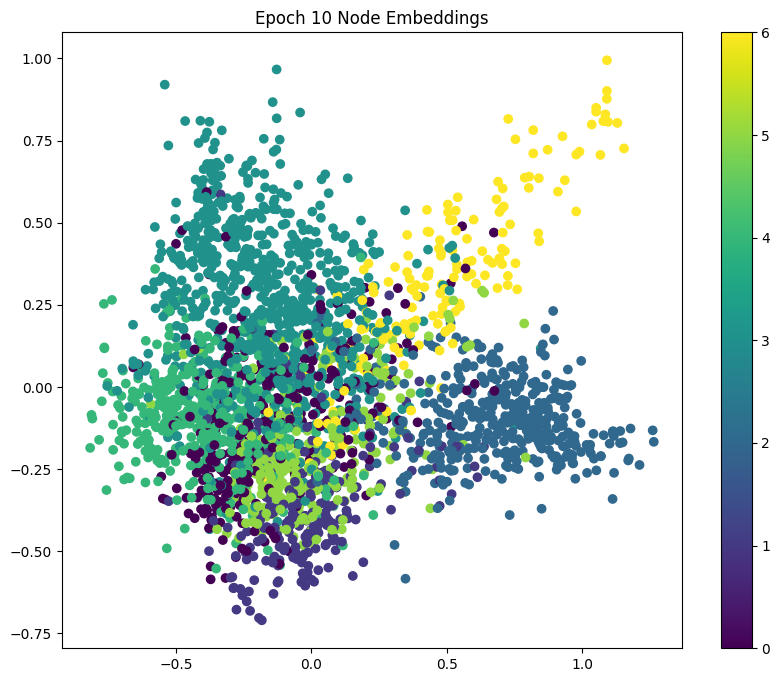

Model 6 - Epoch: 020, Loss: 0.5810, Train: 1.0000, Val: 0.7500, Test: 0.7790, Precision: 0.7975, Recall: 0.7790, F1: 0.7795
Node Embeddings (Epoch 20):
[[-1.9929277   2.3916225 ]
 [-2.9718819  -1.0148625 ]
 [-2.8138194  -0.32952762]
 ...
 [-0.83945787 -1.0541873 ]
 [-2.2530937   0.72645885]
 [-2.2533517   0.8961904 ]]


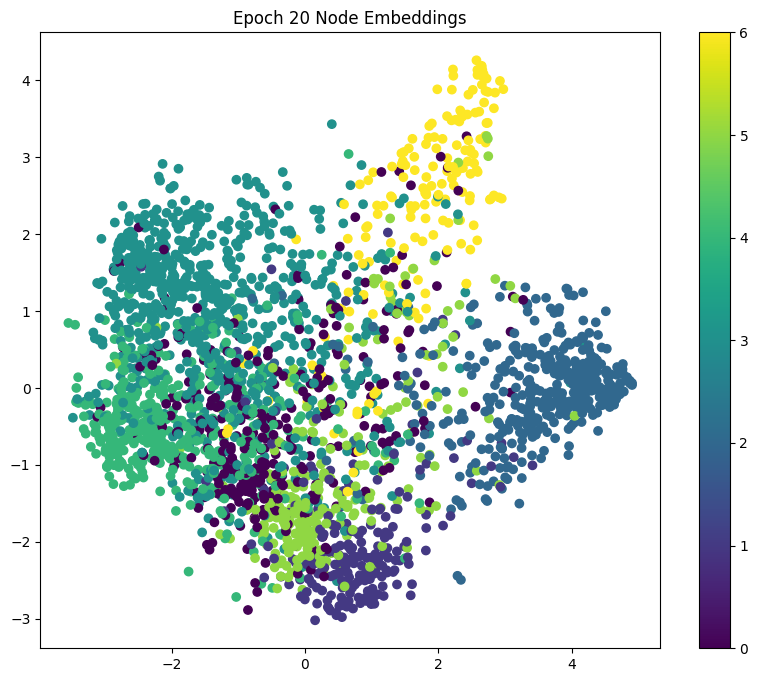

Model 6 - Epoch: 030, Loss: 0.1278, Train: 1.0000, Val: 0.7640, Test: 0.7880, Precision: 0.8048, Recall: 0.7880, F1: 0.7899
Node Embeddings (Epoch 30):
[[-4.238261    2.1225076 ]
 [-4.036891   -1.8711216 ]
 [-3.9126973  -1.1422603 ]
 ...
 [-0.16249472 -2.1464229 ]
 [-3.6449065   0.02691948]
 [-3.6595058   0.01203701]]


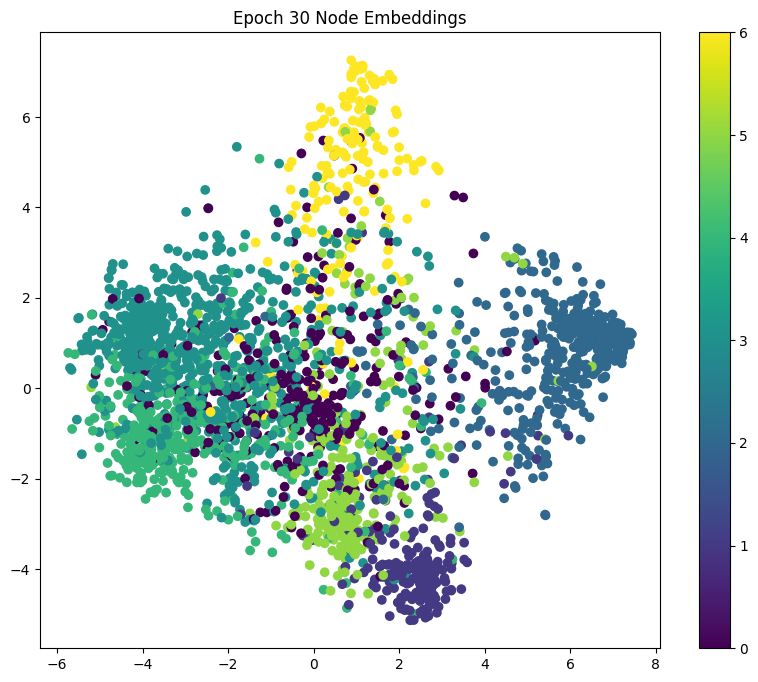

Model 6 - Epoch: 040, Loss: 0.0500, Train: 1.0000, Val: 0.7800, Test: 0.7930, Precision: 0.8062, Recall: 0.7930, F1: 0.7946
Node Embeddings (Epoch 40):
[[-5.015376    1.7848687 ]
 [-4.4129605  -1.347573  ]
 [-4.2088356  -0.99576324]
 ...
 [-0.36728054 -1.645916  ]
 [-4.714764   -0.558743  ]
 [-4.5971994  -0.7242722 ]]


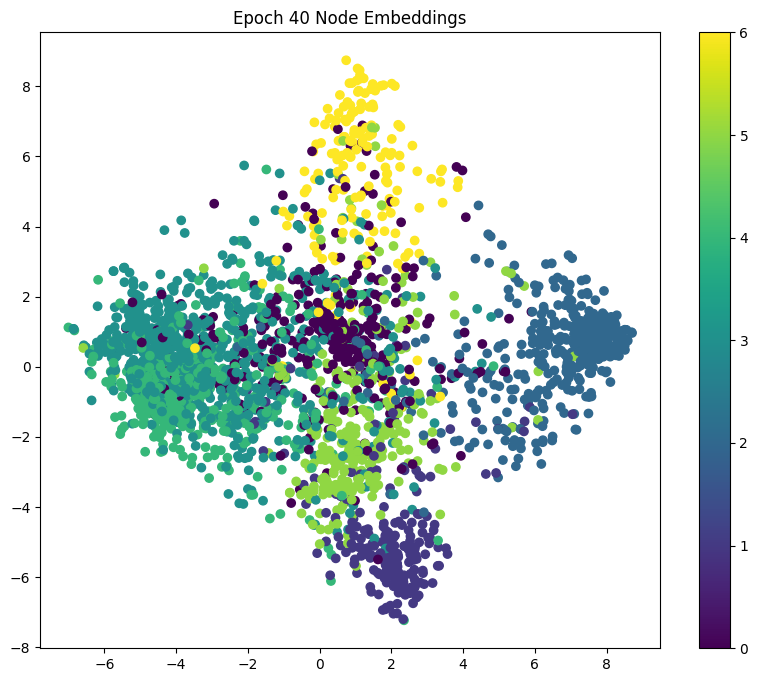

Model 6 - Epoch: 050, Loss: 0.0351, Train: 1.0000, Val: 0.7780, Test: 0.8010, Precision: 0.8140, Recall: 0.8010, F1: 0.8033
Node Embeddings (Epoch 50):
[[-5.5306025   1.1974175 ]
 [-4.3169403  -1.0148765 ]
 [-4.157305   -0.76863766]
 ...
 [-0.34011757 -1.2686622 ]
 [-5.43495    -1.0874556 ]
 [-5.3242207  -1.3018156 ]]


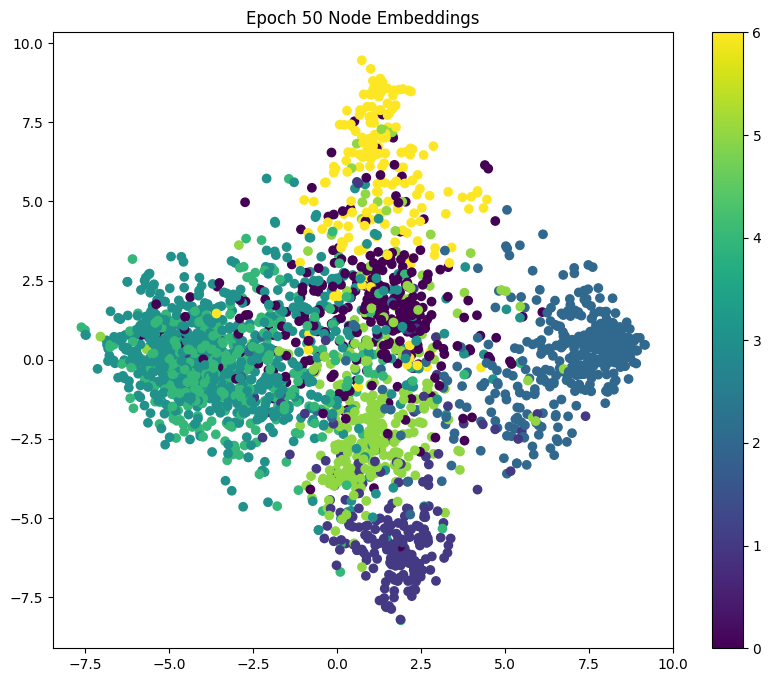

Model 6 - Epoch: 060, Loss: 0.0270, Train: 1.0000, Val: 0.7760, Test: 0.7960, Precision: 0.8091, Recall: 0.7960, F1: 0.7982
Node Embeddings (Epoch 60):
[[-5.7827263   0.70099837]
 [-4.2381725  -0.47949553]
 [-4.160077   -0.20037957]
 ...
 [ 0.01190865 -1.2918686 ]
 [-5.6647596  -1.6189685 ]
 [-5.5883017  -1.7945315 ]]


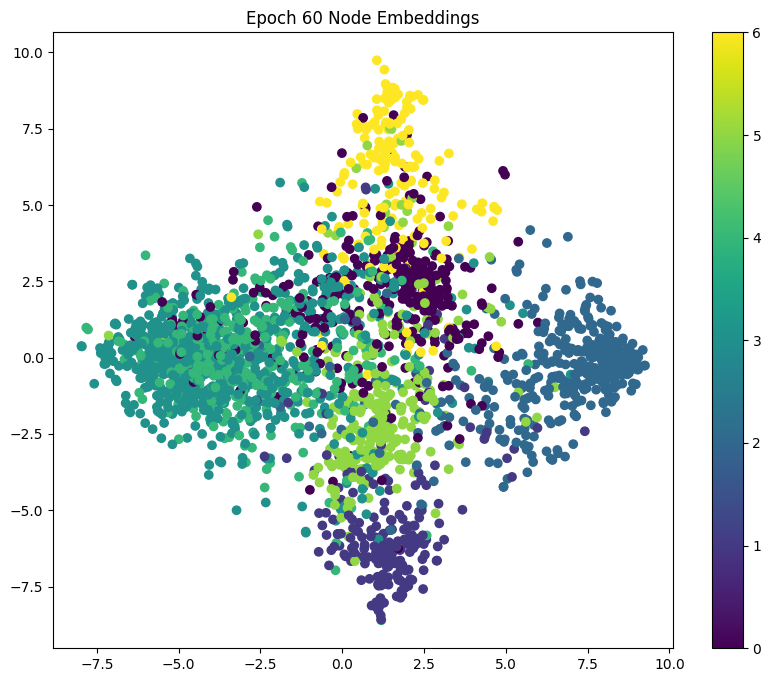

Model 6 - Epoch: 070, Loss: 0.0232, Train: 1.0000, Val: 0.7780, Test: 0.8000, Precision: 0.8122, Recall: 0.8000, F1: 0.8021
Node Embeddings (Epoch 70):
[[-5.978698   -0.43735534]
 [-4.1449943  -0.00817239]
 [-4.1152105  -0.20397696]
 ...
 [ 0.09450442  1.2268263 ]
 [-5.827033    1.866679  ]
 [-5.7572217   2.0174234 ]]


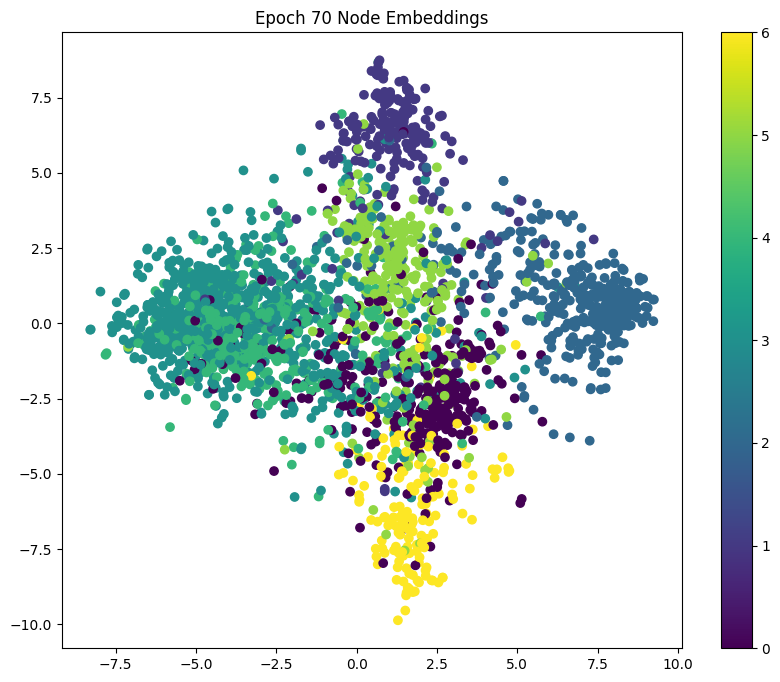

Model 6 - Epoch: 080, Loss: 0.0209, Train: 1.0000, Val: 0.7780, Test: 0.7980, Precision: 0.8103, Recall: 0.7980, F1: 0.8002
Node Embeddings (Epoch 80):
[[ 6.143985   -0.2052768 ]
 [ 4.0012116  -0.5184963 ]
 [ 4.030392   -0.6037857 ]
 ...
 [-0.05747557  1.04214   ]
 [ 5.9421916   1.9844307 ]
 [ 5.876308    2.1734164 ]]


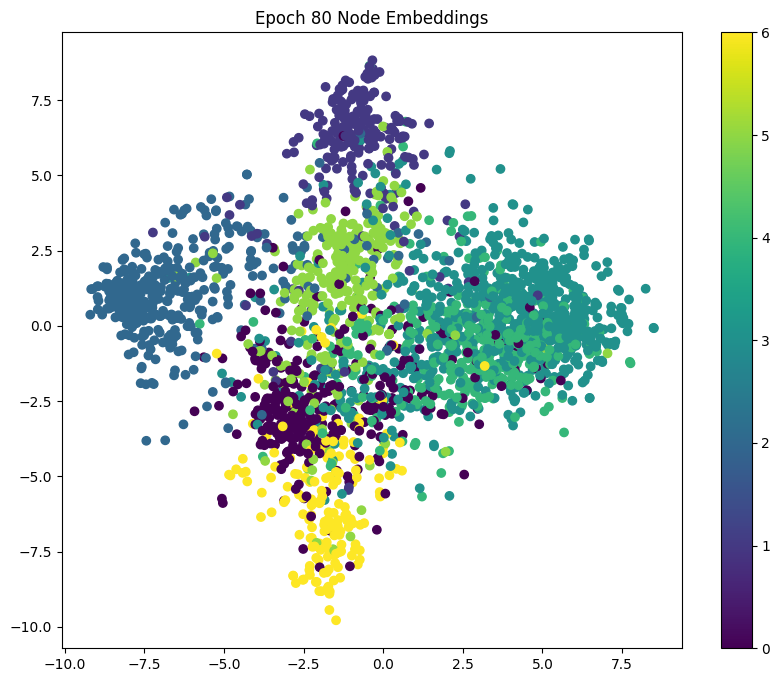

Model 6 - Epoch: 090, Loss: 0.0193, Train: 1.0000, Val: 0.7760, Test: 0.7950, Precision: 0.8078, Recall: 0.7950, F1: 0.7972
Node Embeddings (Epoch 90):
[[ 6.2991614  -0.11341388]
 [ 3.8423066  -0.876091  ]
 [ 3.918457   -0.8932666 ]
 ...
 [-0.05186099  0.9247215 ]
 [ 6.039193    2.0156128 ]
 [ 5.9821625   2.2402387 ]]


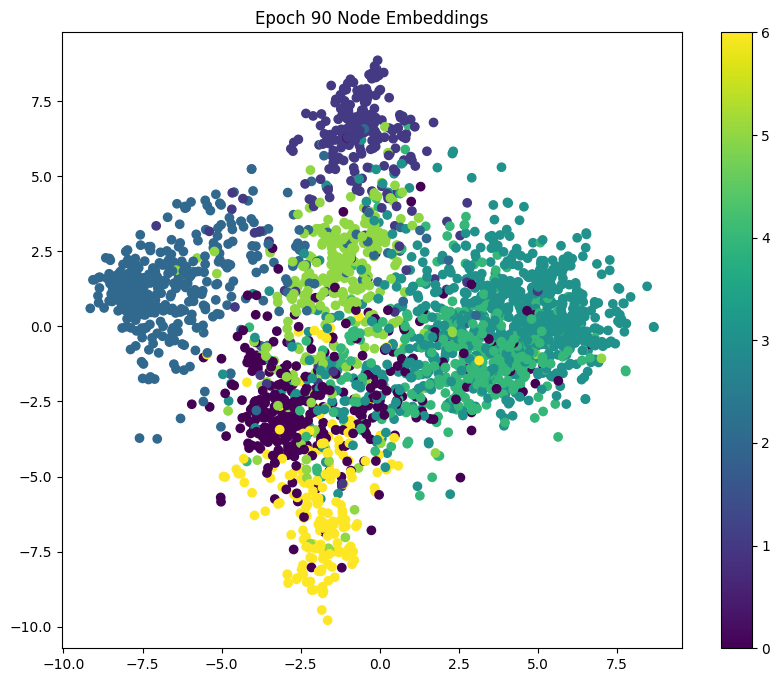

Model 6 - Epoch: 100, Loss: 0.0181, Train: 1.0000, Val: 0.7760, Test: 0.7920, Precision: 0.8047, Recall: 0.7920, F1: 0.7942
Node Embeddings (Epoch 100):
[[ 6.435656   -0.09379288]
 [ 3.638228   -1.1507494 ]
 [ 3.759673   -1.1289761 ]
 ...
 [-0.08887863  0.89610946]
 [ 6.1342235   2.0331197 ]
 [ 6.0794425   2.273625  ]]


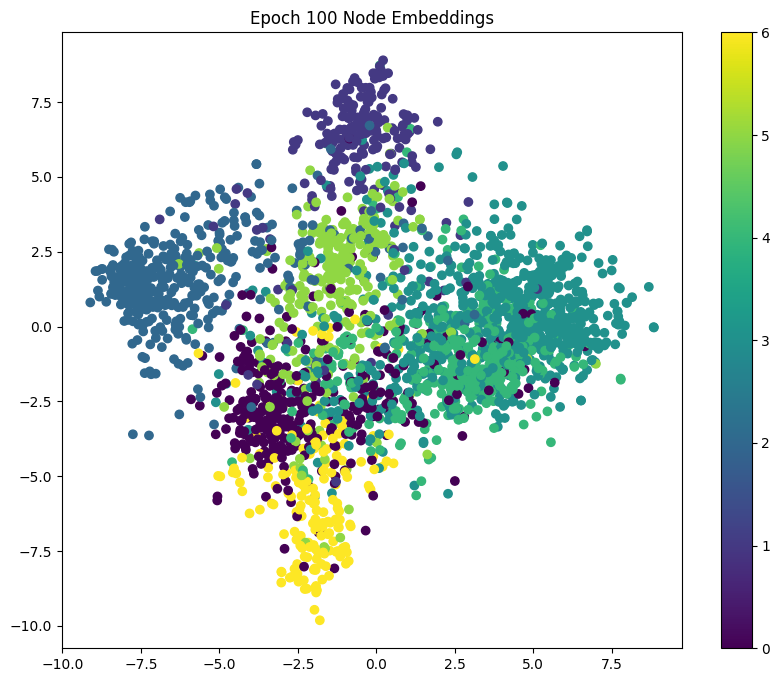

Model 6 - Epoch: 110, Loss: 0.0172, Train: 1.0000, Val: 0.7760, Test: 0.7930, Precision: 0.8056, Recall: 0.7930, F1: 0.7951
Node Embeddings (Epoch 110):
[[ 6.5871863  -0.12861407]
 [ 3.4349847  -1.366281  ]
 [ 3.6041217  -1.3137743 ]
 ...
 [-0.12143505  0.9317639 ]
 [ 6.2455554   2.0059652 ]
 [ 6.194881    2.25763   ]]


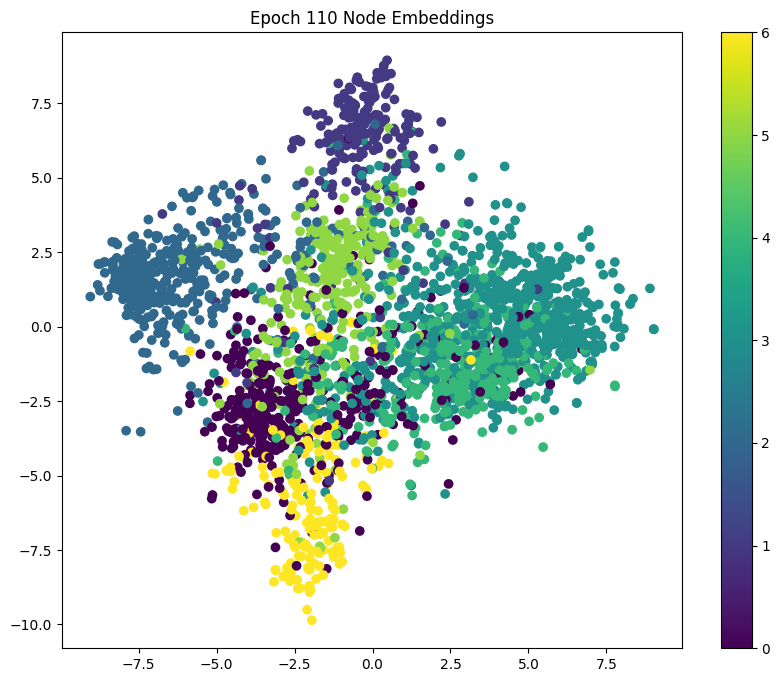

Model 6 - Epoch: 120, Loss: 0.0164, Train: 1.0000, Val: 0.7780, Test: 0.7930, Precision: 0.8056, Recall: 0.7930, F1: 0.7951
Node Embeddings (Epoch 120):
[[ 6.72881    -0.19861867]
 [ 3.214571   -1.5376483 ]
 [ 3.4386034  -1.4641634 ]
 ...
 [-0.15717632  0.95210767]
 [ 6.363892    1.9458405 ]
 [ 6.3224425   2.2139945 ]]


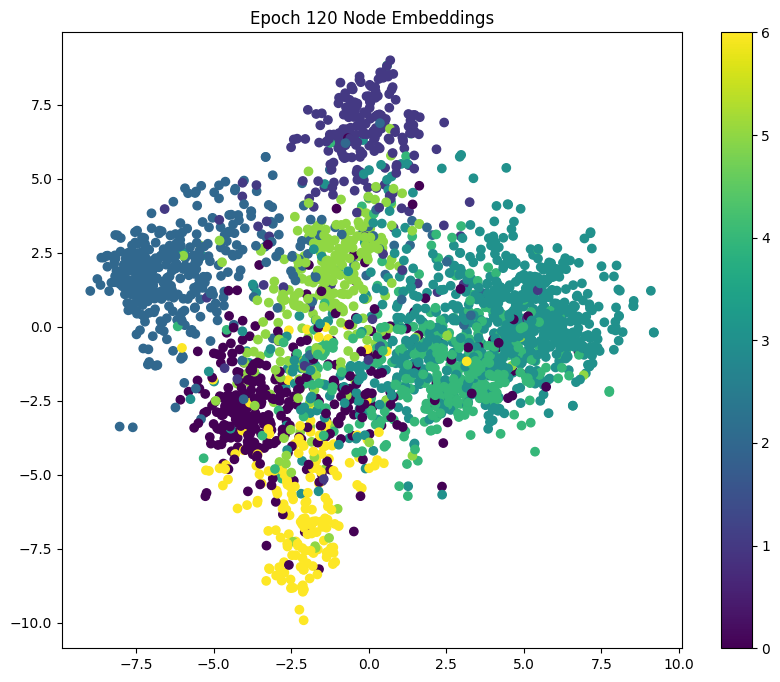

Model 6 - Epoch: 130, Loss: 0.0157, Train: 1.0000, Val: 0.7760, Test: 0.7930, Precision: 0.8056, Recall: 0.7930, F1: 0.7951
Node Embeddings (Epoch 130):
[[ 6.8658457  -0.29892513]
 [ 2.985477   -1.6578515 ]
 [ 3.267944   -1.5739362 ]
 ...
 [-0.18732825  0.9801015 ]
 [ 6.4822106   1.8629951 ]
 [ 6.452309    2.145373  ]]


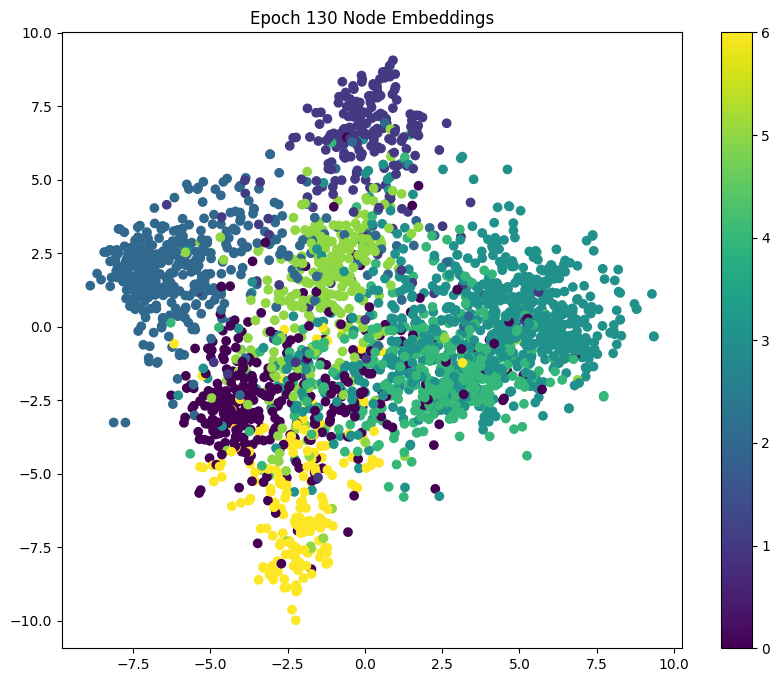

Model 6 - Epoch: 140, Loss: 0.0152, Train: 1.0000, Val: 0.7780, Test: 0.7950, Precision: 0.8077, Recall: 0.7950, F1: 0.7971
Node Embeddings (Epoch 140):
[[ 6.9950886  -0.42274934]
 [ 2.7597747  -1.7256438 ]
 [ 3.0986593  -1.6454653 ]
 ...
 [-0.21111369  1.0105025 ]
 [ 6.594784    1.7682738 ]
 [ 6.5748897   2.064194  ]]


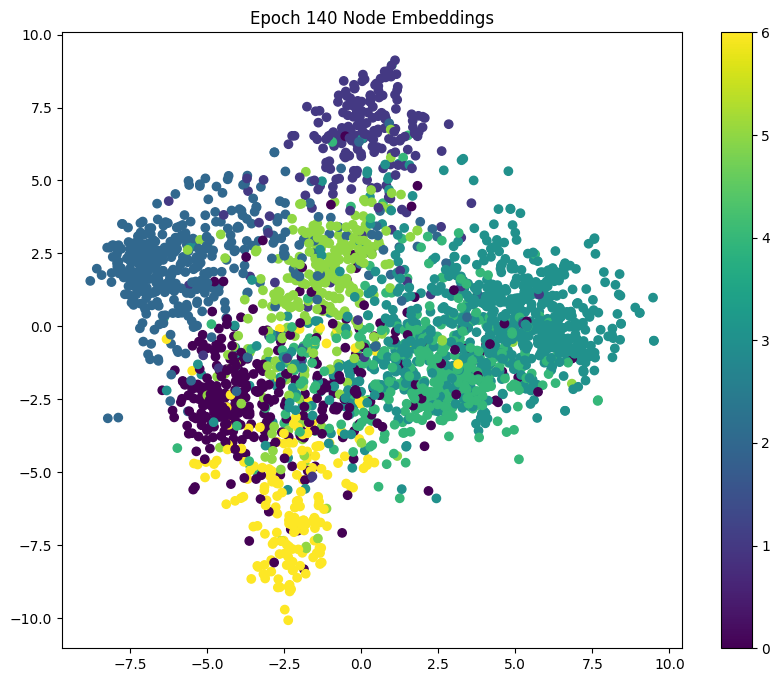

Model 6 - Epoch: 150, Loss: 0.0147, Train: 1.0000, Val: 0.7780, Test: 0.7960, Precision: 0.8084, Recall: 0.7960, F1: 0.7979
Node Embeddings (Epoch 150):
[[ 7.111935   -0.5640995 ]
 [ 2.5353024  -1.7486941 ]
 [ 2.9295535  -1.6820718 ]
 ...
 [-0.23807314  1.0365307 ]
 [ 6.6975336   1.6678703 ]
 [ 6.6875777   1.9749553 ]]


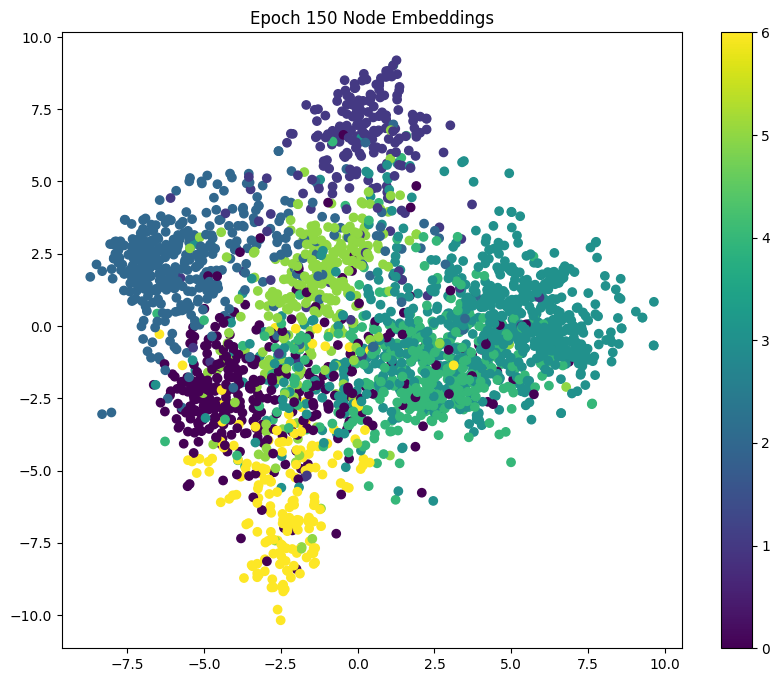

Model 6 - Epoch: 160, Loss: 0.0142, Train: 1.0000, Val: 0.7760, Test: 0.7960, Precision: 0.8084, Recall: 0.7960, F1: 0.7979
Node Embeddings (Epoch 160):
[[ 7.217882   -0.7185233 ]
 [ 2.3144293  -1.733393  ]
 [ 2.7634802  -1.6893576 ]
 ...
 [-0.26455107  1.0645007 ]
 [ 6.790294    1.5623591 ]
 [ 6.7899265   1.8779439 ]]


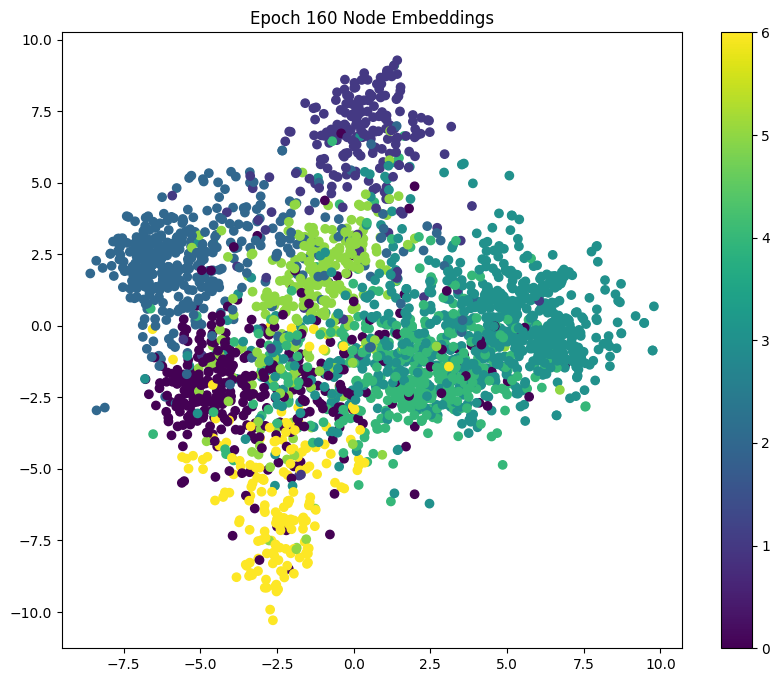

Model 6 - Epoch: 170, Loss: 0.0138, Train: 1.0000, Val: 0.7740, Test: 0.7990, Precision: 0.8109, Recall: 0.7990, F1: 0.8009
Node Embeddings (Epoch 170):
[[ 7.3131294  -0.8800899 ]
 [ 2.1002436  -1.6831725 ]
 [ 2.6023986  -1.6685886 ]
 ...
 [-0.29076526  1.0908111 ]
 [ 6.8747606   1.4535447 ]
 [ 6.883065    1.7772056 ]]


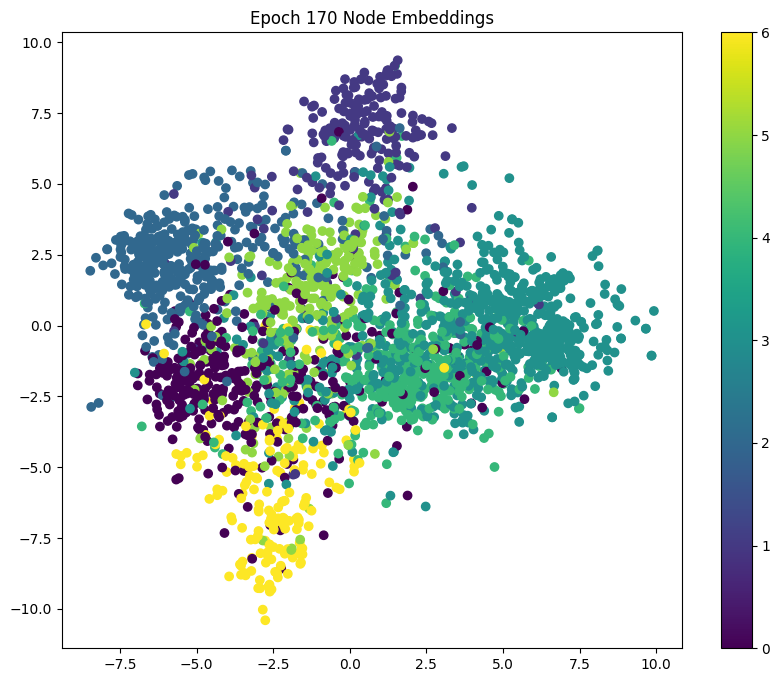

Model 6 - Epoch: 180, Loss: 0.0135, Train: 1.0000, Val: 0.7740, Test: 0.8010, Precision: 0.8129, Recall: 0.8010, F1: 0.8030
Node Embeddings (Epoch 180):
[[ 7.397841   -1.0457443 ]
 [ 1.8940742  -1.6055291 ]
 [ 2.4465764  -1.625433  ]
 ...
 [-0.31653434  1.1161146 ]
 [ 6.9514284   1.3442988 ]
 [ 6.9679403   1.6751986 ]]


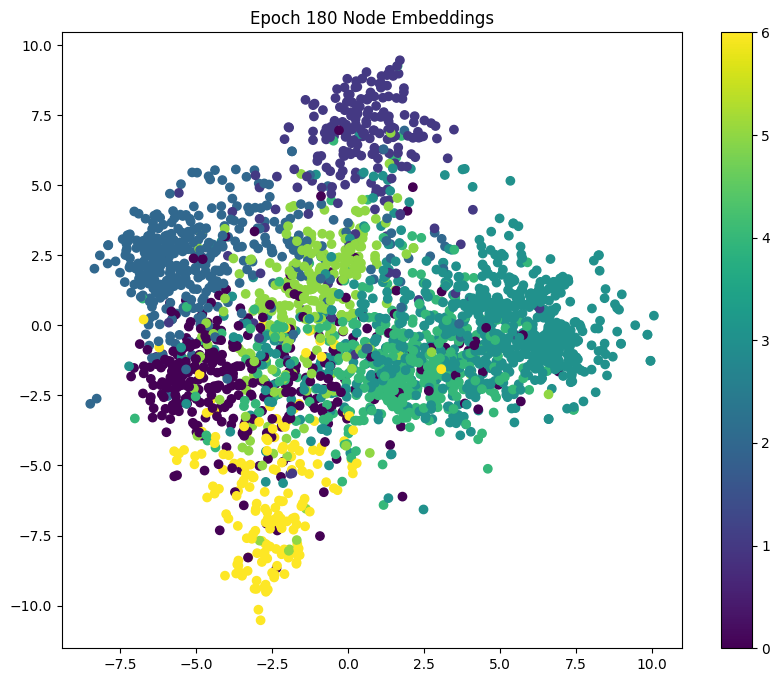

Model 6 - Epoch: 190, Loss: 0.0132, Train: 1.0000, Val: 0.7740, Test: 0.8000, Precision: 0.8125, Recall: 0.8000, F1: 0.8020
Node Embeddings (Epoch 190):
[[ 7.471982   -1.2108581 ]
 [ 1.697776   -1.505846  ]
 [ 2.2981381  -1.5642229 ]
 ...
 [-0.34329635  1.1393191 ]
 [ 7.020361    1.2369419 ]
 [ 7.044517    1.5740854 ]]


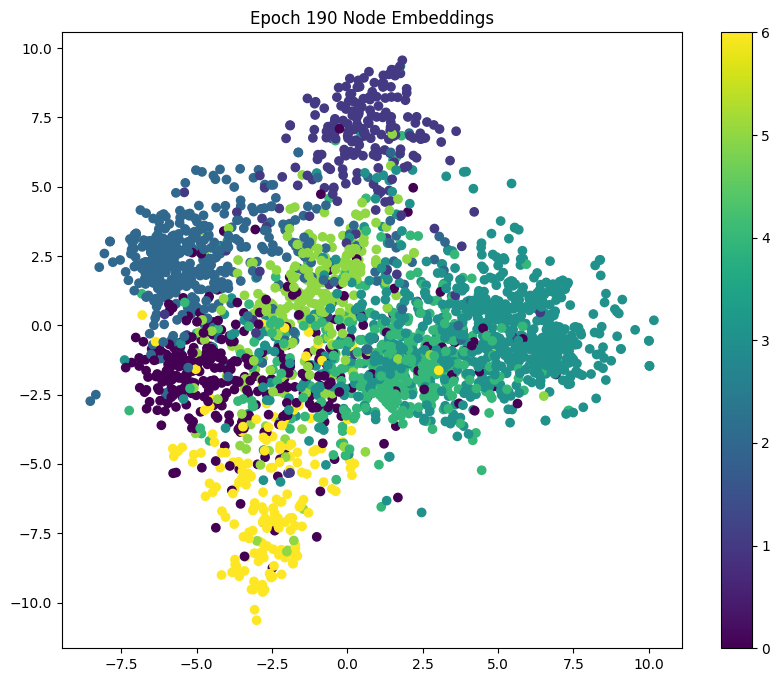

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Train and test 'Sixth' model - Model with 32 hidden units and Sigmoid activation
writer6 = SummaryWriter('runs/model5')

epochs6 = []
train_losses6 = []
train_accuracies6 = []
val_accuracies6 = []
test_accuracies6 = []
precisions6 = []
recalls6 = []
f1_scores6 = []

num_epochs = 200
for epoch in range(1, num_epochs):

    loss6 = train(data, data.train_mask, model6, optimizer6, criterion6)
    train_acc6 = test(data, data.train_mask, model6)
    val_acc6 = test(data, data.val_mask, model6)
    test_acc6 = test(data, data.test_mask, model6)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model6(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs6.append(epoch)
        train_losses6.append(loss6.detach().item())
        train_accuracies6.append(train_acc6)
        val_accuracies6.append(val_acc6)
        test_accuracies6.append(test_acc6)
        precisions6.append(precision)
        recalls6.append(recall)
        f1_scores6.append(f1)

        print(f'Model 6 - Epoch: {epoch:03d}, Loss: {loss6:.4f}, Train: {train_acc6:.4f}, Val: {val_acc6:.4f}, Test: {test_acc6:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        # Node embeddings
        node_embeddings = model6(data.x, data.edge_index)

        # Reducing dimensions using PCA for visualization
        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        # Printing the node embeddings for the current epoch
        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # Visualizing the node embeddings
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer6.add_scalar('Loss/Train', loss6, epoch)
    writer6.add_scalar('Accuracy/Train', train_acc6, epoch)
    writer6.add_scalar('Accuracy/Validation', val_acc6, epoch)
    writer6.add_scalar('Accuracy/Test', test_acc6, epoch)
    writer6.add_scalar('Precision/Test', precision, epoch)
    writer6.add_scalar('Recall/Test', recall, epoch)
    writer6.add_scalar('F1-Score/Test', f1, epoch)

writer6.close()

# Metrices Documention model 6

In [ ]:
# Saving metrics to a DataFrame for Model 6
metrics6 = pd.DataFrame({
    "Epoch": epochs6,
    "Train Loss": train_losses6,
    "Train Accuracy": train_accuracies6,
    "Validation Accuracy": val_accuracies6,
    "Test Accuracy": test_accuracies6,
})

metrics6.to_csv('model6_metrics.csv', index=False)
print("Metrics for Model 6 saved to 'model6_metrics.csv'")
files.download('model6_metrics.csv')

Metrics for Model 6 saved to 'model6_metrics.csv'


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Learning Curve for Sixth Model | Abdelrahman Gamal

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs6, y=train_losses6, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs6, y=train_accuracies6, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs6, y=val_accuracies6, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs6, y=test_accuracies6, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Third Model | Abdelrahman Gamal',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# **Tensor Board For All models with its Hyperparametars**

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


# Run to preview on colab in case URL is not working on colab

In [ ]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

# **GCN Models Performance Analysis**

## 1. Training and Validation Metrics
### **Model 4**
| Epoch | Train Loss       | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------------|----------------|---------------------|---------------|
| 10    | 4.3388E-05       | 100%           | 51.2%               | 52.8%         |
| 20    | 4.1983E-05       | 100%           | 51.2%               | 52.9%         |
| 30    | 4.0635E-05       | 100%           | 51.2%               | 52.8%         |
| 70    | 3.5866E-05       | 100%           | 51.2%               | 52.9%         |
| 190   | 2.3364E-05       | 100%           | 51.6%               | 53.3%         |

### **Model 5**
| Epoch | Train Loss       | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------------|----------------|---------------------|---------------|
| 10    | 0.0017935        | 100%           | 66.0%               | 64.9%         |
| 20    | 0.0016676        | 100%           | 65.6%               | 65.1%         |
| 30    | 0.0015550        | 100%           | 65.6%               | 65.1%         |
| 70    | 0.0012050        | 100%           | 65.8%               | 65.1%         |
| 190   | 0.0006650        | 100%           | 65.2%               | 65.4%         |

### **Model 6**
| Epoch | Train Loss       | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------------|----------------|---------------------|---------------|
| 10    | 0.012642         | 100%           | 77.6%               | 79.9%         |
| 20    | 0.012399         | 100%           | 77.4%               | 80.0%         |
| 30    | 0.012176         | 100%           | 77.4%               | 80.0%         |
| 70    | 0.011439         | 100%           | 77.2%               | 80.2%         |
| 190   | 0.010162         | 100%           | 77.0%               | 80.2%         |

---

## 2. Observations
- **Model 4**:
  - Maintains perfect train accuracy but has a relatively low validation and test accuracy, peaking at **53.3%** on the test set.
  - The minimal loss reduction indicates limited improvement during training.

- **Model 5**:
  - Achieves stable validation and test accuracy around **65%**, with consistent performance across epochs.
  - Shows a significant loss reduction while maintaining perfect train accuracy.

- **Model 6**:
  - Performs best among the three models, with test accuracy stabilizing around **80.2%**.
  - Validation accuracy also remains high, indicating strong generalization.

---

## 3. Conclusion
- **Model 6** outperforms the other models, achieving the highest **Test Accuracy** of **80.2%** and strong generalization performance.
- While **Model 4** converges quickly, its performance on validation and test sets remains limited.
- **Model 5** shows balanced performance but does not surpass **Model 6** in test accuracy.
